# Machine-Learning Course - Final Project - Fall 2023

### **Professor**:


*   Dr. Behnam Bahrak

### **Student**:


*   Ali Zahedzadeh








## **Task 1**
 Determine whether the image depicts a sea, mountain, or jungle.

**Check if GPU is enable (It's for local running)**

In [ ]:
import tensorflow as tf
print(tf.config.list_physical_devices('GPU'))

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


### **Introduction**

#### **Load Google Drive (Colab Running)**

In this part I mount my google drive (because all images are in google drive)

I make a directory for classification beetwen 3 classes (jungle , mountain and sea) this directory include 3 sub-directory that include 3 folder that names are jungle , mountain and sea then `Keras` load this directory as a dataset and I will use it for our task.

In [ ]:
'''
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)
'''

"\nfrom google.colab import drive\ndrive.mount('/content/drive/', force_remount=True)\n"

#### **Show dataset path**

Just show directory of dataset

In [ ]:
'''
!ls "/content/drive/MyDrive/Colab Notebooks/base_classification"
'''

'\n!ls "/content/drive/MyDrive/Colab Notebooks/base_classification"\n'

#### **Import libraries**

Import All libraries that I used in this project

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import seaborn as sns
from tensorflow.keras.layers import Conv2D, MaxPooling2D, BatchNormalization, ReLU, Dense,  GlobalAveragePooling2D
from tensorflow.keras.models import Sequential
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import confusion_matrix, roc_curve, auc
from tensorflow.keras.applications import MobileNetV3Large,ResNet152
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import classification_report
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import SGD, Adam, RMSprop
from keras.callbacks import LearningRateScheduler
from keras.callbacks import Callback
from tensorflow_addons.optimizers import AdamW
from sklearn.preprocessing import label_binarize
from keras.callbacks import Callback
from keras import backend as K

c:\Users\Active\miniconda3\envs\tf\lib\site-packages\tensorflow_addons\utils\tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
c:\Users\Active\miniconda3\envs\tf\lib\site-packages\tensorflow_addons\utils\ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.12.0 and strictly below 2.15.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.10.1 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you 

#### **Load Dataset**

Convert pictures to `Kears data_generator`

Set up data generators for training and validation using the Keras ImageDataGenerator.

1. **Batch Size Definition:**
   - `batch_size = 32`: Defines the batch size for the training and validation data.

2. **ImageDataGenerator Creation:**
   - `data_generator = ImageDataGenerator(rescale=1./255, validation_split=0.2)`: Creates an instance of the ImageDataGenerator class with two main settings:
     - `rescale=1./255`: Normalizes pixel values to the range [0, 1].
     - `validation_split=0.2`: Splits the data into training (80%) and validation (20%) subsets.

3. **Data Generators for Training and Validation:**
   - `train_generator = data_generator.flow_from_directory(...)`: Creates a data generator for the training set using the `flow_from_directory` method.
     - `target_size=(224, 224)`: images size (224x224 pixels).
     - `batch_size=batch_size`: Sets the batch size for training.
     - `class_mode='categorical'`: categorical labels for classification tasks.(we have 3 class and it's a multi-classification task)
     - `subset='training'`: Specifies that this generator is for the training subset.

   - `validation_generator = data_generator.flow_from_directory(...)`: Creates a data generator for the validation set using similar parameters as the training generator.

In [ ]:
batch_size = 32
random_seed = 42
dataset_path = './base_classification'

**`preprocess_grayscale` Function :**


The purpose of this function is to take an RGB image, convert it to grayscale, and then expand it back to a 3-channel format.


**`preprocess_blur` Function :**


This function performs a random data augmentation operation: with a 50% probability, it either returns the original input image (x) without any changes or applies Gaussian blur to the image.


**`MixupImageDataGenerator` Class :**

This class, `MixupImageDataGenerator`, is a custom data generator for Keras designed to implement the mixup data augmentation technique. Mixup is a regularization strategy that involves linearly interpolating between pairs of examples and their labels during training. This helps to improve the generalization of the model and reduces overfitting.

The key components of this class:

1. **Initialization:**
    - `__init__` method initializes the generator. It takes parameters such as the base data generator (`generator`), image directory (`directory`), batch size (`batch_size`), image height and width (`img_height`, `img_width`), mixup alpha parameter (`alpha`), and subset for training or validation (`subset`).

2. **Generators:**
    - Two generators (`generator1` and `generator2`) are created based on the provided Keras `ImageDataGenerator`. Each generator is set up to yield batches of images and their corresponding labels from the specified directory.

3. **Resetting Index:**
    - `reset_index` method resets the internal index arrays of the two generators, ensuring that the same set of images are used for mixup in each epoch.

4. **Epoch End Handling:**
    - `on_epoch_end` method is called at the end of each epoch, and it resets the index arrays using `reset_index`.

5. **Length and Steps per Epoch:**
    - `__len__` method returns the number of batches in an epoch, rounding up the division of the total number of images by the batch size.
    - `get_steps_per_epoch` method calculates the number of steps per epoch based on the batch size and the total number of images.

6. **Batch Generation (`__next__`):**
    - `__next__` method generates the next batch of mixed-up data. It calculates a random mixing coefficient (`l`) using a beta distribution.
    - It then retrieves batches of input images and labels (`X1`, `y1`, `X2`, `y2`) from the two generators.
    - The mixup is performed by blending the images (`X`) and labels (`y`) based on the mixing coefficient.
    - The blended batches are returned as the output of the generator.

7. **Infinite Loop (`__iter__`):**
    - `__iter__` method turns the generator into an infinite loop, allowing it to be used seamlessly with Keras training.

This class enables the use of mixup during training by creating two generators and blending their batches using linear interpolation. The mixup technique enhances model generalization and helps prevent overfitting.

**`Make_Dateset` Function :**


This function, `Make_Dataset`, is designed to create Keras ImageDataGenerator instances for loading and augmenting image datasets. The function allows for different data augmentation strategies based on the provided `data_augmentation` parameter. It also supports various configurations such as rescaling, validation splitting, and class modes. Let's break down the key components:

1. **Data Augmentation Options:**
   - The function supports several data augmentation strategies, including:
     - `RandomRotation`: Random rotation of images.
     - `GaussianBlur`: Applying Gaussian blur using a custom `preprocess_blur` function.
     - `Grayscale`: Converting images to grayscale using a custom `preprocess_grayscale` function.
     - `RandomFlip`: Random horizontal and vertical flips.
     - `ColorJitter`: Applying color jitter using a custom `preprocess_colorjitter` function.
     - `RandomCrop`: Random horizontal and vertical shifts.
     - `MixUp`: Using a custom `MixupImageDataGenerator` for mixup data augmentation.
     - Default (no specific data augmentation): Basic rescaling without additional augmentation.

2. **ImageDataGenerator Initialization:**
   - For each data augmentation strategy, an instance of `ImageDataGenerator` is created with appropriate configurations.
   - Separate instances are created for training and validation sets, and they may differ based on the chosen augmentation strategy.

3. **Flow from Directory:**
   - For each strategy, the `flow_from_directory` method is called to create a generator for loading images from the specified directory.
   - The target size, batch size, class mode, subset (training or validation), and random seed are configured accordingly.

4. **Mixup Strategy:**
   - If the `MixUp` strategy is chosen, a custom `MixupImageDataGenerator` is used instead of a standard `ImageDataGenerator`. It creates instances for both training and validation sets.

5. **Printing Class Mode:**
   - The function prints the chosen class mode for informational purposes.

6. **Return:**
   - The function returns the training and validation data generators.

Here's a summarized breakdown of the key configurations:
- **Rescaling:** All instances use rescaling by default (`rescale=1./255`).
- **Validation Split:** A 20% validation split is applied (`validation_split=0.2`) for both training and validation instances.
- **Class Mode:** The class mode is determined based on the input parameter (`class_mode`).
- **Random Seed:** A random seed (`random_seed`) is used to ensure reproducibility.

The function provides flexibility for experimenting with different data augmentation strategies while preparing datasets for training machine learning models.

In [5]:
#Function For Make Gray Picture
def preprocess_grayscale(image):
    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    # Add third channel to make it (height, width, 3)
    gray = cv2.cvtColor(gray, cv2.COLOR_GRAY2RGB)
    return gray

# Define a function for higher blur
def preprocess_blur(x):
    if np.random.rand() < 0.5:
        return x
    else:
        return cv2.GaussianBlur(x, (15, 15), 0)  # Increase the kernel size for higher blur

'''
introducing random variations or fluctuations
in the color of an image
or graphical elements.
'''
def preprocess_colorjitter(image):
    return cv2.cvtColor(image,cv2.COLOR_RGB2HSV)


class MixupImageDataGenerator():
    def __init__(self, generator, directory, batch_size, img_height, img_width, alpha=0.2, subset=None):
        """Constructor for mixup image data generator.
        Arguments:
            generator {object} -- An instance of Keras ImageDataGenerator.
            directory {str} -- Image directory.
            batch_size {int} -- Batch size.
            img_height {int} -- Image height in pixels.
            img_width {int} -- Image width in pixels.
        Keyword Arguments:
            alpha {float} -- Mixup beta distribution alpha parameter. (default: {0.2})
            subset {str} -- 'training' or 'validation' if validation_split is specified in
            `generator` (ImageDataGenerator).(default: {None})
        """

        self.batch_index = 0
        self.batch_size = batch_size
        self.alpha = alpha

        # First iterator yielding tuples of (x, y)
        self.generator1 = generator.flow_from_directory(directory,
                                                        target_size=(
                                                            img_height, img_width),
                                                        class_mode="categorical",
                                                        batch_size=batch_size,
                                                        shuffle=True,
                                                        subset=subset)

        # Second iterator yielding tuples of (x, y)
        self.generator2 = generator.flow_from_directory(directory,
                                                        target_size=(
                                                            img_height, img_width),
                                                        class_mode="categorical",
                                                        batch_size=batch_size,
                                                        shuffle=True,
                                                        subset=subset)

        # Number of images across all classes in image directory.
        self.n = self.generator1.samples

    def reset_index(self):
        """Reset the generator indexes array.
        """

        self.generator1._set_index_array()
        self.generator2._set_index_array()

    def on_epoch_end(self):
        self.reset_index()

    def reset(self):
        self.batch_index = 0

    def __len__(self):
        # round up
        return (self.n + self.batch_size - 1) // self.batch_size

    def get_steps_per_epoch(self):
        """Get number of steps per epoch based on batch size and
        number of images.
        Returns:
            int -- steps per epoch.
        """

        return self.n // self.batch_size

    def __next__(self):
        """Get next batch input/output pair.
        Returns:
            tuple -- batch of input/output pair, (inputs, outputs).
        """

        if self.batch_index == 0:
            self.reset_index()

        current_index = (self.batch_index * self.batch_size) % self.n
        if self.n > current_index + self.batch_size:
            self.batch_index += 1
        else:
            self.batch_index = 0

        # random sample the lambda value from beta distribution.
        l = np.random.beta(self.alpha, self.alpha, self.batch_size)

        X_l = l.reshape(self.batch_size, 1, 1, 1)
        y_l = l.reshape(self.batch_size, 1)

        # Get a pair of inputs and outputs from two iterators.
        X1, y1 = self.generator1.next()
        X2, y2 = self.generator2.next()

        # Perform the mixup.
        X = X1 * X_l + X2 * (1 - X_l)
        y = y1 * y_l + y2 * (1 - y_l)
        return X, y

    def __iter__(self):
        while True:
            yield next(self)

def Make_Dataset(data_path, batch_size, random_seed, class_mode, data_augmentation = 'default'):
    if data_augmentation == 'RandomRotation':
        train_data_generator = ImageDataGenerator(
            rescale=1./255,
            validation_split=0.2,
            rotation_range=40,
        )
        # Create a separate instance for validation with only rescaling
        validation_data_generator = ImageDataGenerator(
            rescale=1./255,
            validation_split=0.2,
        )
        train_data_generator = train_data_generator.flow_from_directory(
            data_path,
            target_size=(224, 224),
            batch_size=batch_size,
            class_mode=class_mode,
            subset='training',
            seed=random_seed
        )

        # Create data generators for training and validation

        validation_data_generator = validation_data_generator.flow_from_directory(
            data_path,
            target_size=(224, 224),
            batch_size=batch_size,
            class_mode=class_mode,
            subset='validation',
            seed=random_seed
        )
    elif data_augmentation == 'GaussianBlur':
        train_data_generator = ImageDataGenerator(
            rescale=1./255,
            validation_split=0.2,
            preprocessing_function=preprocess_blur
        )
        # Create a separate instance for validation with only rescaling
        validation_data_generator = ImageDataGenerator(
            rescale=1./255,
            validation_split=0.2,
        )
        train_data_generator = train_data_generator.flow_from_directory(
            data_path,
            target_size=(224, 224),
            batch_size=batch_size,
            class_mode=class_mode,
            subset='training',
            seed=random_seed
        )

        # Create data generators for training and validation

        validation_data_generator = validation_data_generator.flow_from_directory(
            data_path,
            target_size=(224, 224),
            batch_size=batch_size,
            class_mode=class_mode,
            subset='validation',
            seed=random_seed
        )
    elif data_augmentation == 'Grayscale':
        train_data_generator = ImageDataGenerator(
            rescale=1./255,
            validation_split=0.2,
            preprocessing_function = preprocess_grayscale
        )
        # Create a separate instance for validation with only rescaling
        validation_data_generator = ImageDataGenerator(
            rescale=1./255,
            validation_split=0.2,
        )
        train_data_generator = train_data_generator.flow_from_directory(
            data_path,
            target_size=(224, 224),
            batch_size=batch_size,
            class_mode=class_mode,
            subset='training',
            seed=random_seed
        )

        # Create data generators for training and validation

        validation_data_generator = validation_data_generator.flow_from_directory(
            data_path,
            target_size=(224, 224),
            batch_size=batch_size,
            class_mode=class_mode,
            subset='validation',
            seed=random_seed
        )
    elif data_augmentation == 'RandomFlip':
        train_data_generator = ImageDataGenerator(
            rescale=1./255,
            validation_split=0.2,
            horizontal_flip=True,
            vertical_flip=True
        )
        # Create a separate instance for validation with only rescaling
        validation_data_generator = ImageDataGenerator(
            rescale=1./255,
            validation_split=0.2,
        )
        train_data_generator = train_data_generator.flow_from_directory(
            data_path,
            target_size=(224, 224),
            batch_size=batch_size,
            class_mode=class_mode,
            subset='training',
            seed=random_seed
        )

        # Create data generators for training and validation

        validation_data_generator = validation_data_generator.flow_from_directory(
            data_path,
            target_size=(224, 224),
            batch_size=batch_size,
            class_mode=class_mode,
            subset='validation',
            seed=random_seed
        )
    elif data_augmentation == 'ColorJitter':
        train_data_generator = ImageDataGenerator(
            rescale=1./255,
            validation_split=0.2,
            preprocessing_function = preprocess_colorjitter
        )
        # Create a separate instance for validation with only rescaling
        validation_data_generator = ImageDataGenerator(
            rescale=1./255,
            validation_split=0.2,
        )
        train_data_generator = train_data_generator.flow_from_directory(
            data_path,
            target_size=(224, 224),
            batch_size=batch_size,
            class_mode=class_mode,
            subset='training',
            seed=random_seed
        )

        # Create data generators for training and validation

        validation_data_generator = validation_data_generator.flow_from_directory(
            data_path,
            target_size=(224, 224),
            batch_size=batch_size,
            class_mode=class_mode,
            subset='validation',
            seed=random_seed
        )
    elif data_augmentation == 'RandomCrop':
        train_data_generator = ImageDataGenerator(
            rescale=1./255,
            validation_split=0.2,
            width_shift_range=0.4,         # Random horizontal shift
            height_shift_range=0.4,        # Random vertical shift
        )
        # Create a separate instance for validation with only rescaling
        validation_data_generator = ImageDataGenerator(
            rescale=1./255,
            validation_split=0.2,
        )
        train_data_generator = train_data_generator.flow_from_directory(
            data_path,
            target_size=(224, 224),
            batch_size=batch_size,
            class_mode=class_mode,
            subset='training',
            seed=random_seed
        )

        # Create data generators for training and validation

        validation_data_generator = validation_data_generator.flow_from_directory(
            data_path,
            target_size=(224, 224),
            batch_size=batch_size,
            class_mode=class_mode,
            subset='validation',
            seed=random_seed
        )
    elif data_augmentation == 'MixUp':
        # Create an instance of ImageDataGenerator without specifying the seed
        data_generator = ImageDataGenerator(
            rescale=1./255,
            validation_split=0.2  # Specify the validation split
        )

        train_data_generator = MixupImageDataGenerator(
            generator=data_generator,
            directory=data_path,
            batch_size=batch_size,
            img_height=224,
            img_width=224,
            subset='training',
        )
        validation_data_generator = data_generator.flow_from_directory(
            directory=data_path,
            target_size=(224, 224),
            class_mode=class_mode,
            batch_size=32,
            shuffle=True,
            subset='validation',
        )
    else:
        data_generator = ImageDataGenerator(
            rescale=1./255,
            validation_split=0.2  # Specify the validation split
        )

        # Create data generators for training and validation with the seed
        train_data_generator = data_generator.flow_from_directory(
            data_path,
            target_size=(224, 224),
            batch_size=batch_size,
            class_mode=class_mode,
            subset='training',
            seed=random_seed
        )

        validation_data_generator = data_generator.flow_from_directory(
            data_path,
            target_size=(224, 224),
            batch_size=batch_size,
            class_mode=class_mode,
            subset='validation',
            seed=random_seed
        )
    print(class_mode)
    return train_data_generator, validation_data_generator


In [ ]:
train_generator, validation_generator = Make_Dataset(dataset_path, batch_size, random_seed, 'categorical', data_augmentation = 'default')

Found 2495 images belonging to 3 classes.
Found 623 images belonging to 3 classes.
categorical


#### **Checking the balance of datasets**

The purpose of this code is to provide an overview of the distribution of classes in both the training and validation sets. It helps in understanding the balance of the dataset, which is important for training machine learning models, especially in classification tasks.

In [ ]:
# Get the class indices
class_indices = train_generator.class_indices

# Print the number of data points in each class for training set
for class_name, class_index in class_indices.items():
    class_count = sum(train_generator.classes == class_index)
    print(f"Training - Class {class_name}: {class_count} samples")

# Get the class indices for validation set
class_indices_val = validation_generator.class_indices

# Print the number of data points in each class for validation set
for class_name, class_index in class_indices_val.items():
    class_count_val = sum(validation_generator.classes == class_index)
    print(f"Validation - Class {class_name}: {class_count_val} samples")

Training - Class jungle: 831 samples
Training - Class mountain: 832 samples
Training - Class sea: 832 samples
Validation - Class jungle: 207 samples
Validation - Class mountain: 208 samples
Validation - Class sea: 208 samples


#### **Show random images from our dataset**

**`display_sample_images` Function :**

This function is useful during the development of machine learning models to visually inspect and verify that the data generator is providing the expected images and labels. It helps to ensure that the data loading and preprocessing steps are working correctly and provides a quick overview of the dataset.

In [ ]:
def display_sample_images(generator, num_images=5, figsize=(15, 5), task = 'categorical'):
    # Generate a batch of images and labels from the generator
    sample_images, sample_labels = next(generator)
    binary_key = {
        0:'fake',
        1:'real',
    }
    categorical_key = {
        0:'jungle',
        1:'mountain',
        2:'sea',
    }

    # Display the images
    plt.figure(figsize=figsize)
    for i in range(num_images):
        plt.subplot(1, num_images, i+1)
        #print(sample_images.shape)
        # Check if the image is grayscale
        if sample_images.shape[3] == 1:
            # If grayscale, use 'gray' colormap
            plt.imshow(np.squeeze(sample_images[i]), cmap='gray')
        else:
            # If RGB, use default colormap
            plt.imshow(sample_images[i])
        if task == 'binary':
            plt.title(f'Class: {sample_labels[i]} -> {binary_key[sample_labels[i]]}')
        else:
            ind = np.argmax(sample_labels[i])
            plt.title(f'Class: {sample_labels[i]} -> {categorical_key[ind]}')
        plt.axis('off')

    plt.show()


#### **All models details**

I have a dictionary for my models' results, capturing various aspects of each model's performance.

- Model Name
- Optimizer
- Learning Rate Schedular
- Data Augmentation
- Training Accuracy
- Training Loss
- Validation Accuracy
- Validation Loss
- Precision
- Recall
- F1-Score


1. **Model Name:**
   - Represents a unique identifier or name assigned to a specific model.
   
   Methods:
   - `CNN (from scratch)`: A Convolutional Neural Network built entirely from scratch.
   - `ResNet-152`: A deep neural network architecture with 152 layers, known for its residual learning approach.
   - `MobileNetV3`: A lightweight and efficient neural network architecture optimized for mobile and edge devices.

2. **Optimizer:**
   - Indicates the optimization algorithm used during the training of the model.
   
   Methods:
   - `Adam`: Adaptive Moment Estimation, a popular optimization algorithm.
   - `Stochastic Gradient Descent (SGD)`: A classic optimization algorithm.
   - `AdamW`: A variant of Adam with weight decay regularization.
   - `RMSprop`: Root Mean Square Propagation, another optimization algorithm.
   - `SAM` (Sharpness-Aware Minimization): An optimization algorithm designed to find sharper minima.

3. **Learning Rate Scheduler:**
   - Refers to the strategy or algorithm used to adjust the learning rate during training.

   Methods:
   - `LinearLR`: Linear learning rate decay.
   - `ExponentialLR`: Exponential learning rate decay.
   - `CyclicLR`: Cyclic learning rate, oscillating between two extreme values.
   - `StepLR`: Learning rate decay with fixed step intervals.

4. **Data Augmentation:**
   - Specifies whether data augmentation techniques were applied during training.

   Methods:
   - `ColorJitter`: Adjusts the brightness, contrast, saturation, and hue of images.
   - `RandomRotation`: Applies random rotations to images.
   - `RandomCrop`: Randomly crops portions of images.
   - `GaussianBlur`: Applies Gaussian blur to images.
   - `Grayscale`: Converts images to grayscale.
   - `RandomFlip`: Randomly flips images horizontally or vertically.
   - `Mixup`: Mixes pairs of images and their labels to create new training examples.

5. **Training Accuracy, Training Loss, Validation Accuracy, Validation Loss:**

   `Training Accuracy:`
   - Represents the accuracy of the model on the training dataset. Accuracy is a measure of the proportion of correctly classified instances.

  `Training Loss:`
    - Indicates the loss or error calculated during the training process. The training loss is a measure of how well the model is performing on the training data.

  `Validation Accuracy:`
    - Represents the accuracy of the model on a separate validation dataset that was not used during training. Validation accuracy helps assess the model's generalization to new, unseen data.

  `Validation Loss:`
    - Indicates the loss or error calculated on the validation dataset. Similar to training loss, validation loss is used to evaluate how well the model is likely to perform on new data.

6. **Precision, Recall, F1-Score:**
   - These are metrics measuring different aspects of classification performance.

   Methods:
   - `Precision`: Ratio of true positive predictions to the total number of positive predictions.
   - `Recall`: Ratio of true positive predictions to the total number of actual positive instances.
   - `F1-Score`: The harmonic mean of precision and recall.

In [ ]:
detail_history = dict()
all_results_categorical = list()

### **Base Models**

In this part my models don't have any of `Optimizers` & `Learning Rate Schedular` & `Data Augmentation`

#### **`CNN` Model From Scratch**

This code defines a convolutional neural network for image classification. It follows a typical pattern for constructing CNNs, including convolutional layers, batch normalization, activation functions, pooling, and a dense output layer. The model is compiled with appropriate settings and includes early stopping to improve generalization.


Summary of each function :

1. **`cnn_categorical`**:
   - Defines a CNN model for multi-class categorical classification.
   - Utilizes Conv2D, BatchNormalization, ReLU, MaxPooling2D, and GlobalAveragePooling2D layers.
   - Includes a Dense output layer with softmax activation for multi-class classification.

2. **`resnet_categorical`**:
   - Utilizes a pre-trained ResNet-152 model for multi-class categorical classification.
   - Freezes the weights of the pre-trained layers and adds custom layers for classification.

3. **`mobilenet_categorical`**:
   - Utilizes a pre-trained MobileNetV3 Large model for multi-class categorical classification.
   - Freezes the weights of the pre-trained layers and adds custom layers for classification.

4. **`cnn_binary`**:
   - Defines a CNN model for binary classification.
   - Similar architecture to `cnn_categorical` but with a single neuron in the output layer and sigmoid activation.

5. **`resnet_binary`**:
   - Uses a pre-trained ResNet-152 model for binary classification.
   - Freezes the weights of the pre-trained layers and adds a custom output layer with sigmoid activation.

6. **`mobilenet_binary`**:
   - Utilizes a pre-trained MobileNetV3 Large model for binary classification.
   - Freezes the weights of the pre-trained layers and adds a custom output layer with sigmoid activation.

These functions provide different neural network architectures tailored for specific classification tasks, allowing flexibility in choosing models based on requirements.

In [6]:
def cnn_categorical(input_shape = (224, 224, 3)):
    # Define the model
    model = Sequential()
    # Layer 1
    model.add(Conv2D(filters=64, kernel_size=(5, 5), strides=(2, 2), padding='same', input_shape=input_shape))
    model.add(BatchNormalization())
    model.add(ReLU())
    model.add(MaxPooling2D(pool_size=(2, 2)))

    # Layer 2
    model.add(Conv2D(filters=64, kernel_size=(3, 3), padding='same'))
    model.add(BatchNormalization())

    # Layer 3
    model.add(Conv2D(filters=128, kernel_size=(3, 3), padding='same'))
    model.add(BatchNormalization())
    model.add(ReLU())

    # Layer 4
    model.add(Conv2D(filters=128, kernel_size=(3, 3), padding='same'))
    model.add(BatchNormalization())

    # Layer 5
    model.add(Conv2D(filters=128, kernel_size=(3, 3), padding='same'))
    model.add(BatchNormalization())
    model.add(ReLU())

    # Layer 6
    model.add(Conv2D(filters=256, kernel_size=(3, 3), strides=(4, 4), padding='same'))
    model.add(BatchNormalization())

    # Layer 7
    model.add(Conv2D(filters=256, kernel_size=(3, 3), padding='same'))
    model.add(BatchNormalization())
    model.add(ReLU())

    # Layer 8
    model.add(Conv2D(filters=512, kernel_size=(3, 3), strides=(2, 2), padding='same'))
    model.add(BatchNormalization())
    model.add(ReLU())

    # Global Average Pooling
    model.add(GlobalAveragePooling2D())

    # Output layer with softmax activation for multi-class classification
    model.add(Dense(3, activation='softmax'))

    return model

def resnet_categorical(input_shape = (224, 224, 3)):
    # Load pre-trained ResNet-152 model
    base_model = ResNet152(weights='imagenet', include_top=False, input_shape=input_shape)

    # Adjust the number of trainable layers
    for layer in base_model.layers:
        layer.trainable = False

    # Create a new model by adding custom layers on top of the ResNet-152 base
    model = Sequential()
    model.add(base_model)
    model.add(GlobalAveragePooling2D())
    model.add(Dense(3, activation='softmax'))

    return model

def mobilenet_categorical(input_shape = (224, 224, 3)):
    # Load pre-trained MobileNetV3 Large model
    base_model = MobileNetV3Large(weights='imagenet', include_top=False, input_shape=input_shape)

    # Adjust the number of trainable layers
    for layer in base_model.layers:
        layer.trainable = False

    # Create a new model by adding custom layers on top of the MobileNetV3 Large base
    model = Sequential()
    model.add(base_model)
    model.add(GlobalAveragePooling2D())
    model.add(Dense(3, activation='softmax'))

    return model

def cnn_binary(input_shape = (224, 224, 3)):
    # Define the model
    model = Sequential()

    # Layer 1
    model.add(Conv2D(filters=64, kernel_size=(5, 5), strides=(2, 2), padding='same', input_shape=input_shape))
    model.add(BatchNormalization())
    model.add(ReLU())
    model.add(MaxPooling2D(pool_size=(2, 2)))

    # Layer 2
    model.add(Conv2D(filters=64, kernel_size=(3, 3), padding='same'))
    model.add(BatchNormalization())

    # Layer 3
    model.add(Conv2D(filters=128, kernel_size=(3, 3), padding='same'))
    model.add(BatchNormalization())
    model.add(ReLU())

    # Layer 4
    model.add(Conv2D(filters=128, kernel_size=(3, 3), padding='same'))
    model.add(BatchNormalization())

    # Layer 5
    model.add(Conv2D(filters=128, kernel_size=(3, 3), padding='same'))
    model.add(BatchNormalization())
    model.add(ReLU())

    # Layer 6
    model.add(Conv2D(filters=256, kernel_size=(3, 3), strides=(4, 4), padding='same'))
    model.add(BatchNormalization())

    # Layer 7
    model.add(Conv2D(filters=256, kernel_size=(3, 3), padding='same'))
    model.add(BatchNormalization())
    model.add(ReLU())

    # Layer 8
    model.add(Conv2D(filters=512, kernel_size=(3, 3), strides=(2, 2), padding='same'))
    model.add(BatchNormalization())
    model.add(ReLU())

    # Global Average Pooling
    model.add(GlobalAveragePooling2D())

    # Output layer with sigmoid activation for binary classification
    model.add(Dense(1, activation='sigmoid'))

    return model

def resnet_binary(input_shape = (224, 224, 3)):
    # Load pre-trained ResNet-152 model
    base_model = ResNet152(weights='imagenet', include_top=False, input_shape=input_shape)

    # Adjust the number of trainable layers
    for layer in base_model.layers:  # Adjust the number of layers as needed
        layer.trainable = False

    # Create a new model by adding custom layers on top of the ResNet-152 base
    model = Sequential()
    model.add(base_model)
    model.add(GlobalAveragePooling2D())

    # Output layer with sigmoid activation for binary classification
    model.add(Dense(1, activation='sigmoid'))

    return model

def mobilenet_binary(input_shape = (224, 224, 3)):
    # Load pre-trained MobileNetV3 Large model
    base_model = MobileNetV3Large(weights='imagenet', include_top=False, input_shape=input_shape)

    # Adjust the number of trainable layers
    for layer in base_model.layers:
        layer.trainable = False

    # Create a new model by adding custom layers on top of the MobileNetV3 Large base
    model = Sequential()
    model.add(base_model)
    model.add(GlobalAveragePooling2D())

    # Output layer with sigmoid activation for binary classification
    model.add(Dense(1, activation='sigmoid'))

    return model

This function, `Make_Model`, is designed to create and compile neural network models based on various parameters specified during its invocation. Here's an overview of its functionality:


- **Input Parameters:**
  - `task`: A string indicating the type of task, either 'categorical' for multi-class classification or 'binary' for binary classification.
  - `model_name`: A string specifying the type of neural network architecture to use ('cnn', 'resnet', 'mobilenet').
  - `optimizer`: A string specifying the optimizer to be used for training ('sgd', 'adam', 'adamw', 'rmsprop').
  - `input_shape`: A tuple representing the input shape of the images (default is (224, 224, 3)).

- **Functionality:**
  - The function first checks the task type ('categorical' or 'binary') and prints the corresponding classification type.
  - Based on the model_name, it selects the architecture: 'cnn', 'resnet', or 'mobilenet'.
  - Depending on the optimizer specified, it prints the optimizer details and creates the corresponding model using one of the provided neural network architectures.
  - It then compiles the model with the specified optimizer and loss function ('categorical_crossentropy' for multi-class and 'binary_crossentropy' for binary).
  - Finally, the model summary is printed, and the compiled model is returned.


In [ ]:
def Make_Model(task, model_name, optimizer, input_shape = (224, 224, 3)):

    if task == 'categorical':
        print("Task :", "Multi Class Classification (Jungle, Mountain, Sea)")
        if model_name == 'cnn':
            print("Model Type:", "CNN from Scratch")
            if optimizer == 'sgd':
                print("Optimizer :", "SGD(learning_rate=0.001, momentum=0.9)")
                model = cnn_categorical(input_shape)
                sgd_optimizer = SGD(learning_rate=0.001, momentum=0.9)
                model.compile(optimizer=sgd_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'adam':
                print("Optimizer :", "Adam(learning_rate=0.001)")
                model = cnn_categorical(input_shape)
                adam_optimizer = Adam(learning_rate=0.001)
                model.compile(optimizer=adam_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'adamw':
                print("AdamW(learning_rate=0.001, weight_decay=0.01)")
                model = cnn_categorical(input_shape)
                adamw_optimizer = AdamW(learning_rate=0.001, weight_decay=0.01)
                model.compile(optimizer=adamw_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'rmsprop':
                print("RMSprop(learning_rate=0.001)")
                model = cnn_categorical(input_shape)
                 # Compile the model with RMSprop optimizer and categorical crossentropy loss
                rmsprop_optimizer = RMSprop(learning_rate=0.001)
                model.compile(optimizer=rmsprop_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            else:
                pass

        elif model_name == 'resnet':
            print("Model Type:", "ResNet-152")
            if optimizer == 'sgd':
                print("Optimizer :", "SGD(learning_rate=0.001, momentum=0.9)")
                model = resnet_categorical(input_shape)
                sgd_optimizer = SGD(learning_rate=0.001, momentum=0.9)
                model.compile(optimizer=sgd_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'adam':
                print("Optimizer :", "Adam(learning_rate=0.001)")
                model = resnet_categorical(input_shape)
                adam_optimizer = Adam(learning_rate=0.001)
                model.compile(optimizer=adam_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'adamw':
                print("AdamW(learning_rate=0.001, weight_decay=0.01)")
                model = resnet_categorical(input_shape)
                adamw_optimizer = AdamW(learning_rate=0.001, weight_decay=0.01)
                model.compile(optimizer=adamw_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'rmsprop':
                print("RMSprop(learning_rate=0.001)")
                model = resnet_categorical(input_shape)
                 # Compile the model with RMSprop optimizer and categorical crossentropy loss
                rmsprop_optimizer = RMSprop(learning_rate=0.001)
                model.compile(optimizer=rmsprop_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            else:
                pass

        else:
            print("Model Type:", "MobileNetV3")
            if optimizer == 'sgd':
                print("Optimizer :", "SGD(learning_rate=0.001, momentum=0.9)")
                model = mobilenet_categorical(input_shape)
                sgd_optimizer = SGD(learning_rate=0.001, momentum=0.9)
                model.compile(optimizer=sgd_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'adam':
                print("Optimizer :", "Adam(learning_rate=0.001)")
                model = mobilenet_categorical(input_shape)
                adam_optimizer = Adam(learning_rate=0.001)
                model.compile(optimizer=adam_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'adamw':
                print("AdamW(learning_rate=0.001, weight_decay=0.01)")
                model = mobilenet_categorical(input_shape)
                adamw_optimizer = AdamW(learning_rate=0.001, weight_decay=0.01)
                model.compile(optimizer=adamw_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'rmsprop':
                print("RMSprop(learning_rate=0.001)")
                model = mobilenet_categorical(input_shape)
                 # Compile the model with RMSprop optimizer and categorical crossentropy loss
                rmsprop_optimizer = RMSprop(learning_rate=0.001)
                model.compile(optimizer=rmsprop_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

    else:
        print("Task :", "Binary Classification (Real, Fake)")
        if model_name == 'cnn':
            print("Model Type:", "CNN from Scratch")
            if optimizer == 'sgd':
                print("Optimizer :", "SGD(learning_rate=0.001, momentum=0.9)")
                model = cnn_binary(input_shape)
                sgd_optimizer = SGD(learning_rate=0.001, momentum=0.9)
                model.compile(optimizer=sgd_optimizer, loss='binary_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'adam':
                print("Optimizer :", "Adam(learning_rate=0.001)")
                model = cnn_binary(input_shape)
                adam_optimizer = Adam(learning_rate=0.001)
                model.compile(optimizer=adam_optimizer, loss='binary_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'adamw':
                print("AdamW(learning_rate=0.001, weight_decay=0.01)")
                model = cnn_binary(input_shape)
                adamw_optimizer = AdamW(learning_rate=0.001, weight_decay=0.01)
                model.compile(optimizer=adamw_optimizer, loss='binary_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'rmsprop':
                print("Optimizer :", "RMSprop(learning_rate=0.001)")
                model = cnn_binary(input_shape)
                # Compile the model with RMSprop optimizer and categorical crossentropy loss
                rmsprop_optimizer = RMSprop(learning_rate=0.001)
                model.compile(optimizer=rmsprop_optimizer, loss='binary_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            else:
                pass

        elif model_name == 'resnet':
            print("Model Type:", "ResNet-152")
            if optimizer == 'sgd':
                print("Optimizer :", "SGD(learning_rate=0.001, momentum=0.9)")
                model = resnet_binary(input_shape)
                sgd_optimizer = SGD(learning_rate=0.001, momentum=0.9)
                model.compile(optimizer=sgd_optimizer, loss='binary_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'adam':
                print("Optimizer :", "Adam(learning_rate=0.001)")
                model = resnet_binary(input_shape)
                adam_optimizer = Adam(learning_rate=0.001)
                model.compile(optimizer=adam_optimizer, loss='binary_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'adamw':
                print("AdamW(learning_rate=0.001, weight_decay=0.01)")
                model = resnet_binary(input_shape)
                adamw_optimizer = AdamW(learning_rate=0.001, weight_decay=0.01)
                model.compile(optimizer=adamw_optimizer, loss='binary_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'rmsprop':
                print("Optimizer :","RMSprop(learning_rate=0.001)")
                model = resnet_binary(input_shape)
                 # Compile the model with RMSprop optimizer and categorical crossentropy loss
                rmsprop_optimizer = RMSprop(learning_rate=0.001)
                model.compile(optimizer=rmsprop_optimizer, loss='binary_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            else:
                pass

        else:
            print("Model Type:", "MobileNetV3")
            if optimizer == 'sgd':
                print("Optimizer :", "SGD(learning_rate=0.001, momentum=0.9)")
                model = mobilenet_binary(input_shape)
                sgd_optimizer = SGD(learning_rate=0.001, momentum=0.9)
                model.compile(optimizer=sgd_optimizer, loss='binary_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'adam':
                print("Optimizer :", "Adam(learning_rate=0.001)")
                model = mobilenet_binary(input_shape)
                adam_optimizer = Adam(learning_rate=0.001)
                model.compile(optimizer=adam_optimizer, loss='binary_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'adamw':
                print("AdamW(learning_rate=0.001, weight_decay=0.01)")
                model = mobilenet_binary(input_shape)
                adamw_optimizer = AdamW(learning_rate=0.001, weight_decay=0.01)
                model.compile(optimizer=adamw_optimizer, loss='binary_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary()
                return model

            elif optimizer == 'rmsprop':
                print("Optimizer :", "RMSprop(learning_rate=0.001)")
                model = mobilenet_binary(input_shape)
                 # Compile the model with RMSprop optimizer and categorical crossentropy loss
                rmsprop_optimizer = RMSprop(learning_rate=0.001)
                model.compile(optimizer=rmsprop_optimizer, loss='binary_crossentropy', metrics=['accuracy'])
                # Print a summary of the model
                model.summary
                return model

            else:
                pass



Make a basic dataset

Found 2495 images belonging to 3 classes.
Found 623 images belonging to 3 classes.
categorical


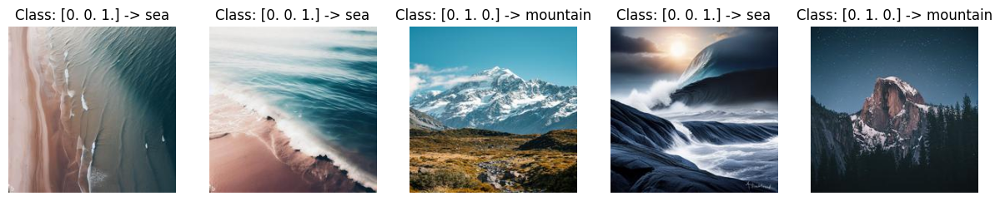

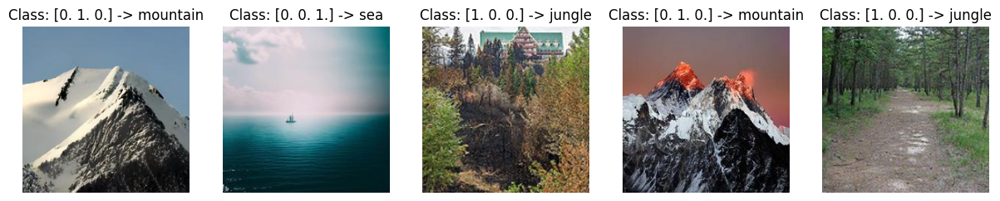

In [ ]:
#make basic dataset
train_generator, validation_generator = Make_Dataset(dataset_path, batch_size, random_seed, 'categorical', data_augmentation = 'default')
display_sample_images(train_generator)
display_sample_images(validation_generator)

**Train Model**

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'sgd')
# Train the model
history_cnn = model.fit(
    train_generator,
    epochs=10,
    validation_data=validation_generator,
    callbacks=[early_stopping]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization (BatchN  (None, 112, 112, 64)     256       
 ormalization)                                                   
                                                                 
 re_lu (ReLU)                (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 56, 56, 64)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 56, 56, 64)        36928     
                                                                 
 batch_normalization_1 (Batc  (None, 56, 56, 64)       2

The provided code defines a function called `plot_metrics_and_matrix` and then utilizes it to evaluate and visualize the performance of a convolutional neural network (CNN) model trained for image.

**summary of the key functionalities:**

1. **Print Metrics:**
   - Displays the final training and validation accuracy along with the corresponding losses.
   - Utilizes the `history` object to extract and print these metrics.

2. **Classification Report:**
   - Predicts on the validation set using the trained model.
   - Computes and prints a classification report, including precision, recall, and F1-score.

3. **Confusion Matrix:**
   - Creates and displays a confusion matrix using seaborn, illustrating the model's classification performance.

4. **Accuracy and Loss Plots:**
   - Plots training and validation accuracy over epochs.
   - Plots training and validation loss over epochs.
   - Visualizes these metrics to assess the model's learning progress.

5. **Return Metrics:**
   - Returns key metrics such as final training and validation accuracy, training and validation loss, precision, recall, and F1-score.

6. **Storing Results:**
   - Stores the obtained metrics and experiment details in a dictionary named `detail_history`, including model name, optimizer, learning rate scheduler, data augmentation status, and rounded metric values.

7. **Appending to Results List:**
   - Appends the `detail_history` dictionary to a list named `all_results`, enabling the aggregation of results from multiple experiments or models.

In [ ]:
def plot_metrics_and_matrix(history, model, validation_generator, title, task):
    # Get accuracy and loss values
    train_accuracy = history.history['accuracy']
    val_accuracy = history.history['val_accuracy']

    train_loss = history.history['loss']
    val_loss = history.history['val_loss']

    print("#############################################")
    print("Accuracy & Loss (Training & Validation Set)")
    print("#############################################")

    print("Training Accuracy:", train_accuracy[-1])
    print("Validation Accuracy:", val_accuracy[-1])
    print("Training Loss:", train_loss[-1])
    print("Validation Loss:", val_loss[-1])

    # Predict on the validation set
    if task == 'binary':
        y_pred = model.predict(validation_generator)
        y_pred = (y_pred > 0.5).astype(int)  # Convert probabilities to binary predictions
        # Get true labels
        y_true = validation_generator.classes
        # Generate the classification report
        report = classification_report(y_true, y_pred, target_names=train_generator.class_indices.keys(), output_dict=True)
        print(classification_report(y_true, y_pred))

        precision = report['weighted avg']['precision']
        recall = report['weighted avg']['recall']
        f1_score = report['weighted avg']['f1-score']

        # Generate the confusion matrix
        conf_mat = confusion_matrix(y_true, y_pred)
        # Display the confusion matrix using a heatmap
        plt.figure(figsize=(8, 6))
        sns.heatmap(conf_mat, annot=True, fmt='d', cmap='Blues',
                    xticklabels=train_generator.class_indices.keys(),
                    yticklabels=train_generator.class_indices.keys())
        plt.xlabel('Predicted')
        plt.ylabel('True')
        plt.title('Confusion Matrix')
        plt.show()

    else:
        y_pred = model.predict(validation_generator)
        y_pred_classes = np.argmax(y_pred, axis=1)
        y_true = validation_generator.classes

        # Display the classification report
        report = classification_report(y_true, y_pred_classes, output_dict=True)
        print(classification_report(y_true, y_pred_classes))

        # Store classification report results in detail_history
        precision = report['weighted avg']['precision']
        recall = report['weighted avg']['recall']
        f1_score = report['weighted avg']['f1-score']

        # Create confusion matrix
        cm = confusion_matrix(y_true, y_pred_classes)

        # Plot confusion matrix
        plt.figure(figsize=(8, 6))
        sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=validation_generator.class_indices, yticklabels=validation_generator.class_indices)
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.title('Confusion Matrix')
        plt.show()

    # Plot training history with a nice style
    plt.figure(figsize=(8, 6))

    # Plot training accuracy with a blue line
    plt.plot(history.history['accuracy'], label='Training Accuracy', linewidth=2, marker='o', color='blue')

    # Plot validation accuracy with an orange line
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy', linewidth=2, marker='o', color='orange')

    # Set plot labels and title
    plt.xlabel('Epoch', fontsize=14)
    plt.ylabel('Accuracy', fontsize=14)
    plt.title('Training and Validation Accuracy Over Epochs' + title, fontsize=16)

    # Add grid for better readability
    plt.grid(True, linestyle='--', alpha=0.7)

    # Add legend
    plt.legend(fontsize=12)

    # Show the plot
    plt.show()

    # Plot training history with a nice style
    plt.figure(figsize=(8, 6))

    # Plot training loss with a blue line
    plt.plot(history.history['loss'], label='Training Loss', linewidth=2, marker='o', color='blue')

    # Plot validation loss with an orange line
    plt.plot(history.history['val_loss'], label='Validation Loss', linewidth=2, marker='o', color='orange')

    # Set plot labels and title
    plt.xlabel('Epoch', fontsize=14)
    plt.ylabel('Loss', fontsize=14)
    plt.title('Training and Validation Loss Over Epochs' + title, fontsize=16)

    # Add grid for better readability
    plt.grid(True, linestyle='--', alpha=0.7)

    # Add legend
    plt.legend(fontsize=12)

    # Show the plot
    plt.show()

    return train_accuracy[-1], val_accuracy[-1], train_loss[-1], val_loss[-1], precision, recall, f1_score



#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.9294589161872864
Validation Accuracy: 0.7399678826332092
Training Loss: 0.1998859941959381
Validation Loss: 0.7784992456436157
 1/20 [>.............................] - ETA: 4s

20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.31      0.31      0.31       207
           1       0.32      0.50      0.39       208
           2       0.25      0.10      0.14       208

    accuracy                           0.30       623
   macro avg       0.29      0.30      0.28       623
weighted avg       0.29      0.30      0.28       623



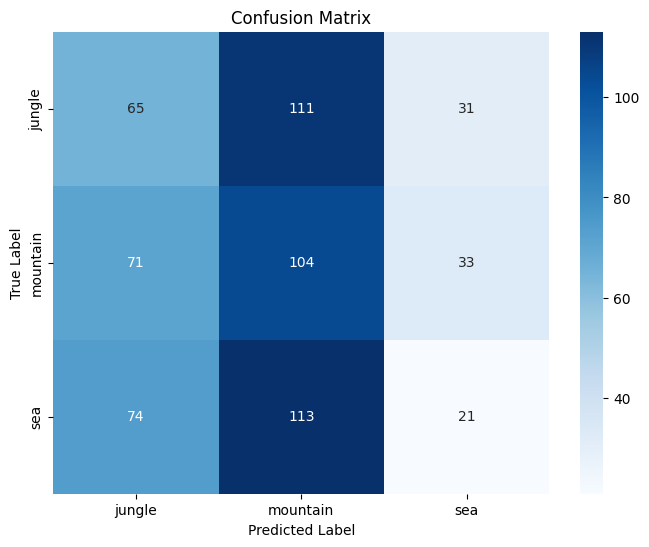

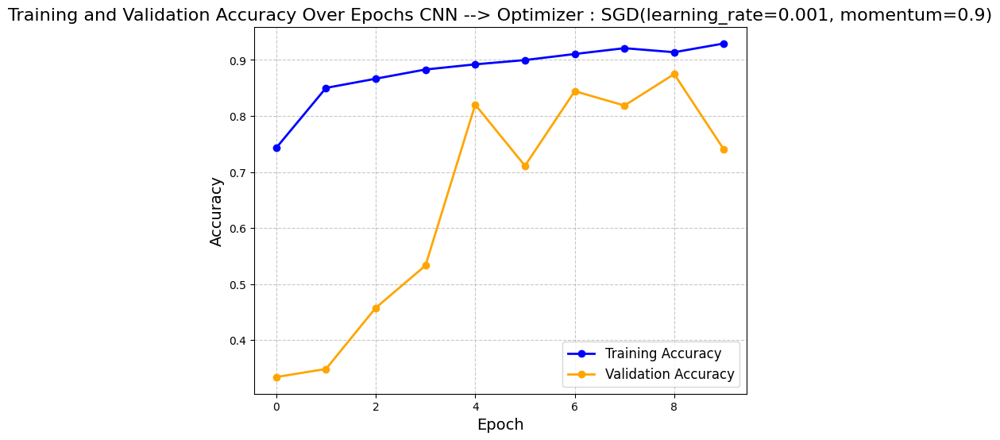

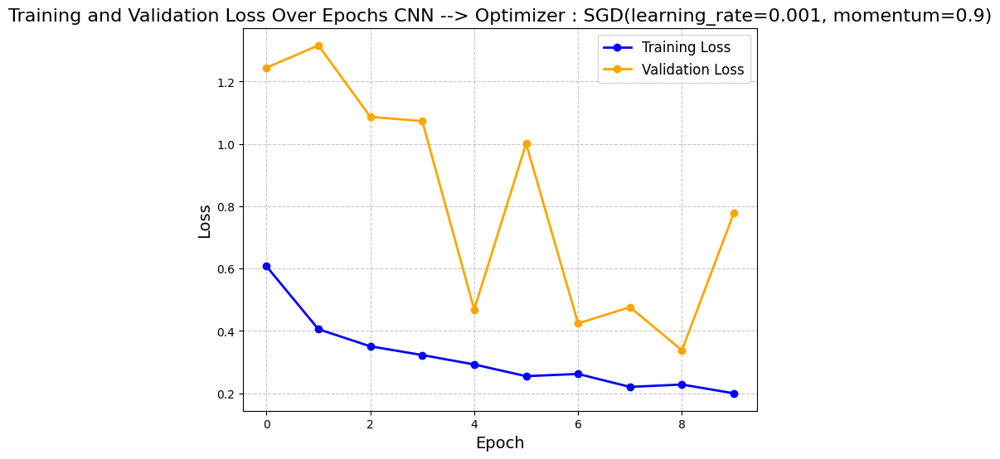

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.9295,
 'Training Loss': 0.1999,
 'Validation Accuracy': 0.74,
 'Validation Loss': 0.7785,
 'Precision': 0.2912,
 'Recall': 0.305,
 'F1-Score': 0.281}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history_cnn, model, validation_generator, " CNN --> Optimizer : SGD(learning_rate=0.001, momentum=0.9)", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

#### **`ResNet-152` Model**

The code defines a function to create and compile a neural network based on the ResNet-152 architecture. It utilizes a pre-trained ResNet-152 model as a base, freezes its layers to retain pre-trained weights, adds custom layers for classification, and compiles the model for training. The resulting model is then printed and returned.

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('categorical', 'resnet', 'sgd')
# Train the model
history = model.fit(
    train_generator,
    epochs=20,
    validation_data=validation_generator,
    callbacks=[early_stopping]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: ResNet-152
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet152 (Functional)      (None, 7, 7, 2048)        58370944  
                                                                 
 global_average_pooling2d_1   (None, 2048)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_1 (Dense)             (None, 3)                 6147      
                                                                 
Total params: 58,377,091
Trainable params: 6,147
Non-trainable params: 58,370,944
_________________________________________________________________
Epoch 1/20
78/78 [==============================] - 60s 628ms/step - loss: 1.1047 - accuracy: 0.3924 - v

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.6452905535697937
Validation Accuracy: 0.6356340050697327
Training Loss: 0.8098192811012268
Validation Loss: 0.8520634174346924


20/20 [==============================] - 11s 450ms/step
              precision    recall  f1-score   support

           0       0.32      0.29      0.31       207
           1       0.35      0.43      0.38       208
           2       0.36      0.32      0.34       208

    accuracy                           0.35       623
   macro avg       0.34      0.35      0.34       623
weighted avg       0.34      0.35      0.34       623



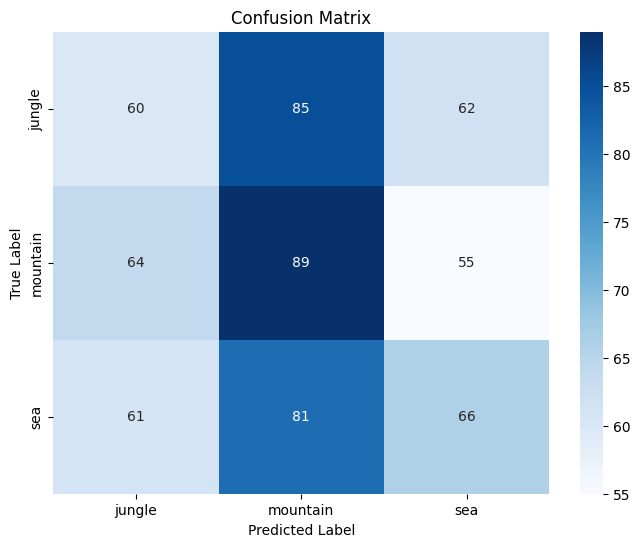

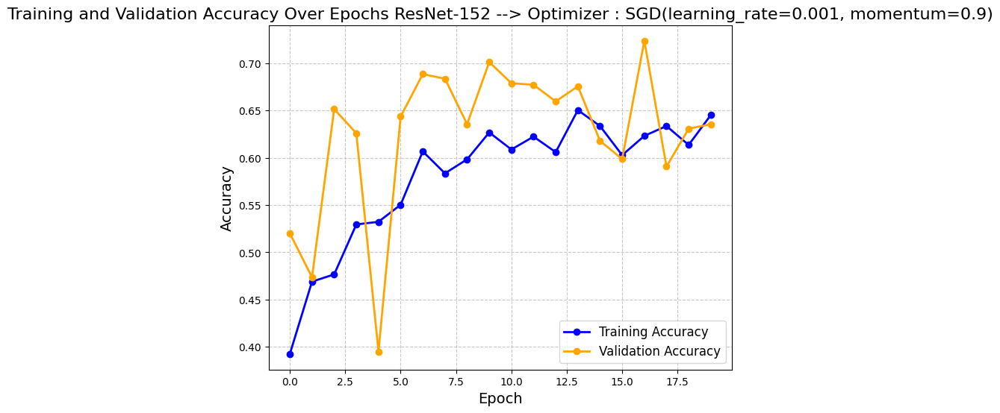

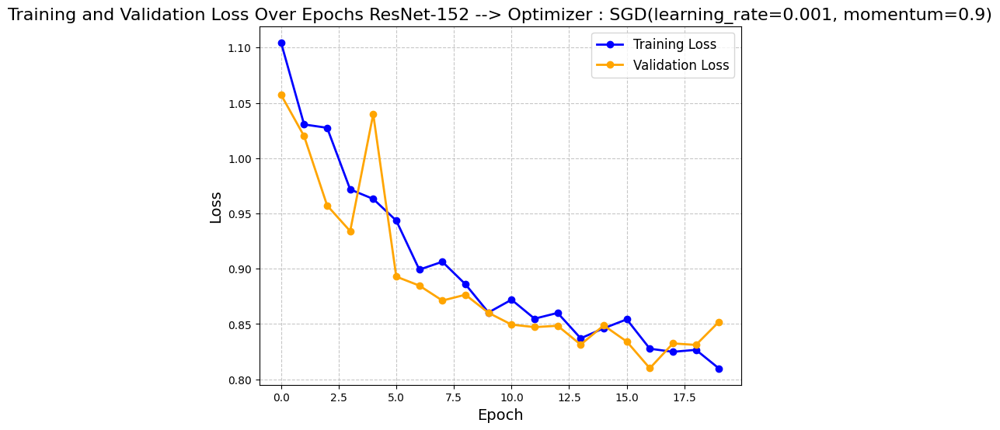

{'Model Name': 'ResNet-152',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.6453,
 'Training Loss': 0.8098,
 'Validation Accuracy': 0.6356,
 'Validation Loss': 0.8521,
 'Precision': 0.3447,
 'Recall': 0.3451,
 'F1-Score': 0.3428}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " ResNet-152 --> Optimizer : SGD(learning_rate=0.001, momentum=0.9)", "categorical")
detail_history = dict()
detail_history["Model Name"] = "ResNet-152"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

#### **`MobileNet-V3` Model**

The code defines a function to create and compile a neural network based on the MobileNetV3 Large architecture. It uses a pre-trained MobileNetV3 Large model as a base, freezes its layers to retain pre-trained weights, adds custom layers for classification, and compiles the model for training. The resulting model is then printed and returned.

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('categorical', 'mobilenet', 'sgd')
# Train the model
history = model.fit(
    train_generator,
    epochs=20,
    validation_data=validation_generator,
    callbacks=[early_stopping]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: MobileNetV3
Optimizer : SGD(learning_rate=0.001, momentum=0.9)


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 MobilenetV3large (Functiona  (None, 7, 7, 960)        2996352   
 l)                                                              
                                                                 
 global_average_pooling2d_2   (None, 960)              0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_2 (Dense)             (None, 3)                 2883      
                                                                 
Total params: 2,999,235
Trainable params: 2,883
Non-trainable params: 2,996,352
_________________________________________________________________
Epoch 1/20
78/78 [==============================] - 13s 113ms/step - loss: 1.0995 - accuracy: 0.3471 - val_loss: 1.0871 - val_accuracy: 0.3339
Epoch 2/20
78/78 [===========

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.5735470652580261
Validation Accuracy: 0.6260032057762146
Training Loss: 0.9459881782531738
Validation Loss: 0.9265794157981873


20/20 [==============================] - 2s 60ms/step
              precision    recall  f1-score   support

           0       0.32      0.29      0.30       207
           1       0.37      0.23      0.28       208
           2       0.31      0.45      0.37       208

    accuracy                           0.32       623
   macro avg       0.33      0.32      0.32       623
weighted avg       0.33      0.32      0.32       623



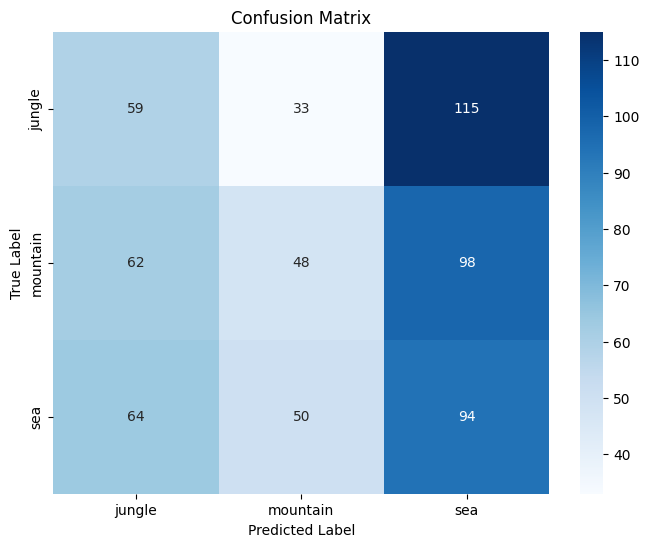

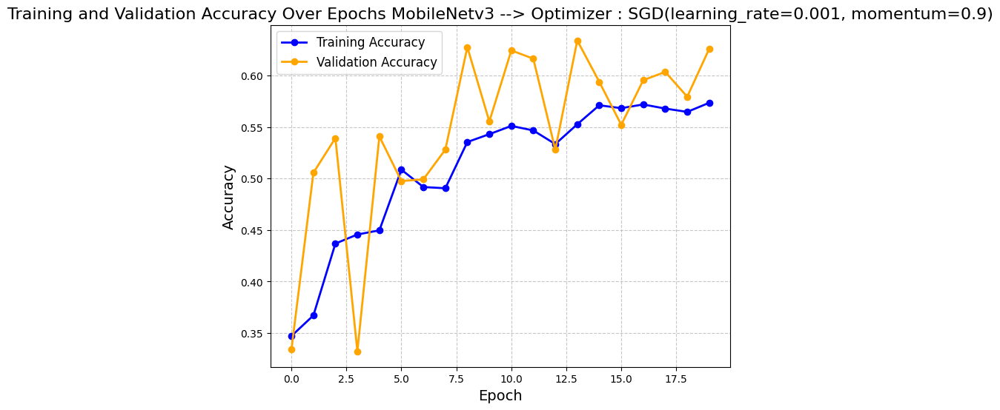

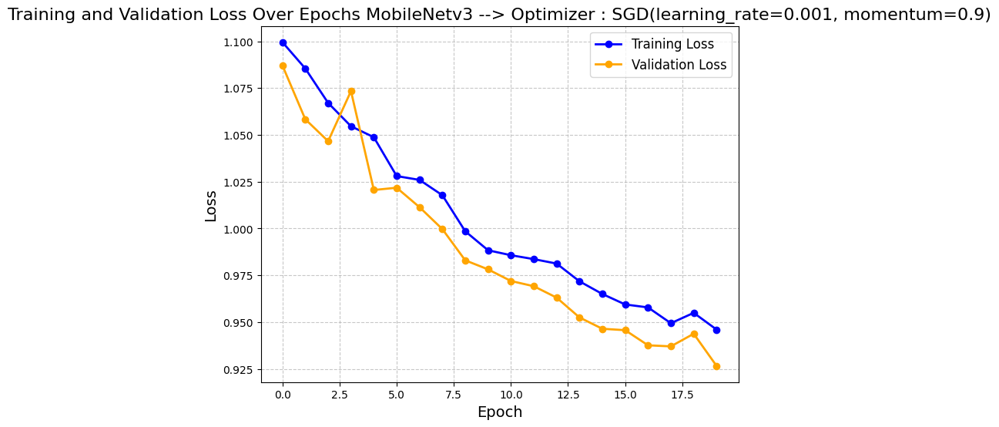

{'Model Name': 'MobileNetV3',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.5735,
 'Training Loss': 0.946,
 'Validation Accuracy': 0.626,
 'Validation Loss': 0.9266,
 'Precision': 0.3305,
 'Recall': 0.3226,
 'F1-Score': 0.3164}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " MobileNetv3 --> Optimizer : SGD(learning_rate=0.001, momentum=0.9)", "categorical")
detail_history = dict()
detail_history["Model Name"] = "MobileNetV3"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

### **Data Augmentation**

#### **`CNN` Model From Scratch (with Data Augmentation)**



##### **Random Rotation**

Random rotation involves rotating the input images by a random angle within a specified range. This helps the model become more robust by learning to recognize patterns in images regardless of their orientation. In real-world scenarios, objects might appear in images at different angles, so training a model with rotated versions of the images can improve its ability to generalize and perform well on unseen data.

Found 2495 images belonging to 3 classes.
Found 623 images belonging to 3 classes.


categorical


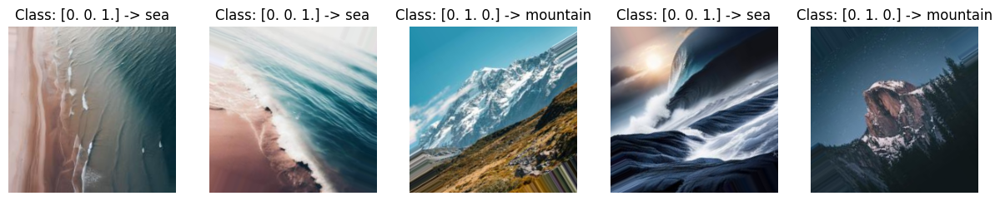

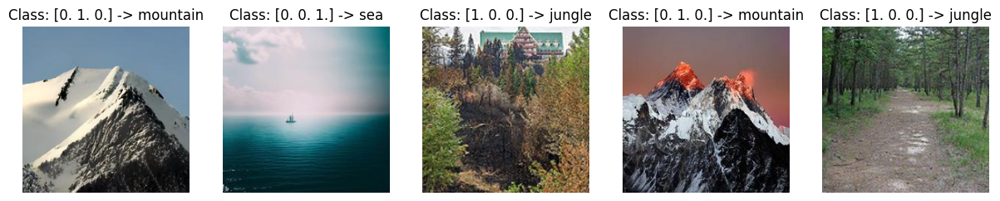

In [ ]:
train_generator_rotation,validation_generator = Make_Dataset(dataset_path, batch_size, random_seed, 'categorical', 'RandomRotation')

# Displaying samples from the training set with random rotation
display_sample_images(train_generator_rotation)

# Displaying samples from the validation set
display_sample_images(validation_generator)

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'sgd')
# Train the model
history = model.fit(
    train_generator_rotation,
    epochs=10,
    validation_data=validation_generator,
    callbacks=[early_stopping]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_8 (Conv2D)           (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_8 (Batc  (None, 112, 112, 64)     256       
 hNormalization)                                                 
                                                                 


 re_lu_44 (ReLU)             (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                                 
 conv2d_9 (Conv2D)           (None, 56, 56, 64)        36928     
                                                                 
 batch_normalization_9 (Batc  (None, 56, 56, 64)       256       
 hNormalization)                                                 
                                                                 
 conv2d_10 (Conv2D)          (None, 56, 56, 128)       73856     
                                                                 
 batch_normalization_10 (Bat  (None, 56, 56, 128)      512       
 chNormalization)                                                
                                                                 
 re_lu_45 

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.8801603317260742
Validation Accuracy: 0.8057785034179688
Training Loss: 0.31917569041252136
Validation Loss: 0.5136836171150208


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.32      0.29      0.30       207
           1       0.35      0.33      0.34       208
           2       0.32      0.36      0.34       208

    accuracy                           0.33       623
   macro avg       0.33      0.33      0.33       623
weighted avg       0.33      0.33      0.33       623



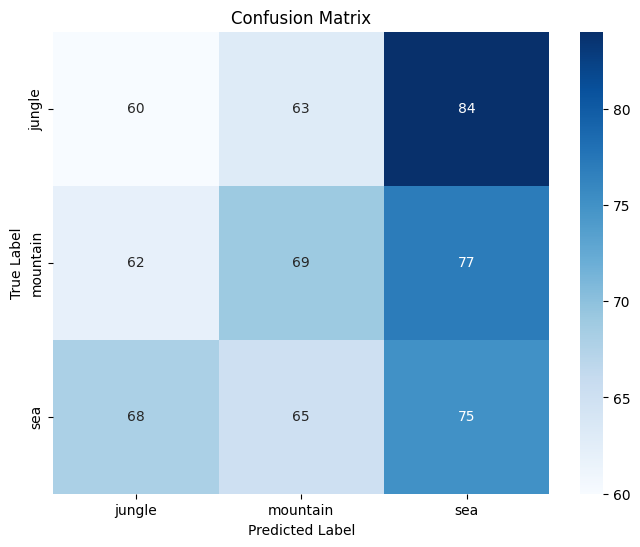

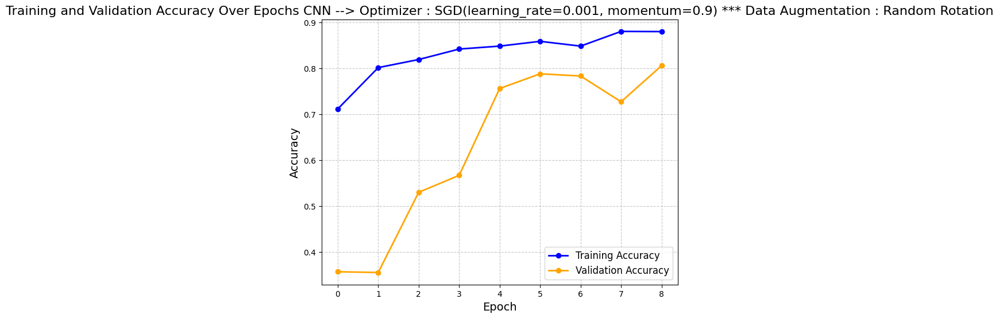

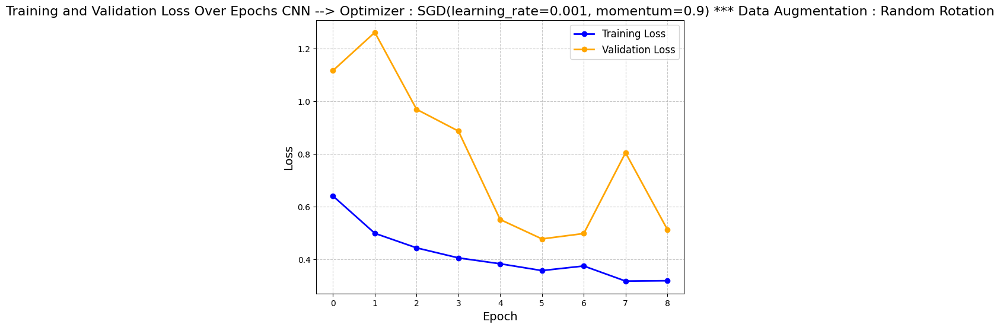

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Random Rotation',
 'Training Accuracy': 0.8802,
 'Training Loss': 0.3192,
 'Validation Accuracy': 0.8058,
 'Validation Loss': 0.5137,
 'Precision': 0.328,
 'Recall': 0.3274,
 'F1-Score': 0.327}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : SGD(learning_rate=0.001, momentum=0.9) *** Data Augmentation : Random Rotation", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Random Rotation"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

##### **GaussianBlur**

Gaussian Blur is another image processing technique commonly used in the context of data augmentation and preprocessing for deep learning. It is a smoothing filter that helps reduce noise and detail in an image by convolving the image with a Gaussian kernel. This process results in a blurred version of the original image.

Found 2495 images belonging to 3 classes.
Found 623 images belonging to 3 classes.


categorical


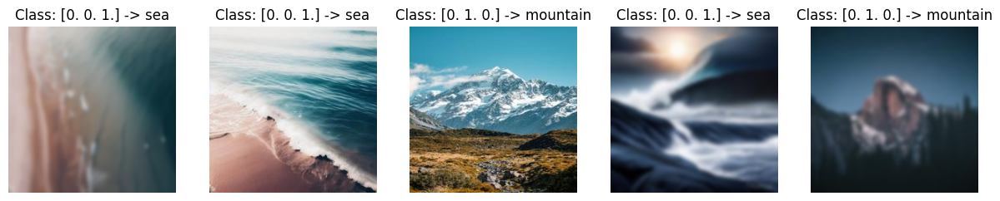

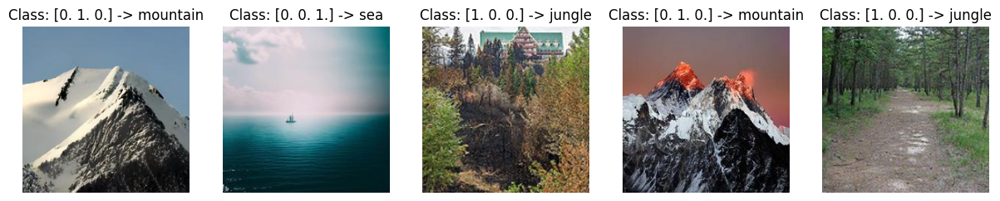

In [ ]:
train_generator_blur,validation_generator = Make_Dataset(dataset_path, batch_size, random_seed, 'categorical', 'GaussianBlur')

# Displaying samples from the training set with random rotation
display_sample_images(train_generator_blur)

# Displaying samples from the validation set
display_sample_images(validation_generator)

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'sgd')
# Train the model
history = model.fit(
    train_generator_blur,
    epochs=10,
    validation_data=validation_generator,
    callbacks=[early_stopping]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_16 (Conv2D)          (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_16 (Bat  (None, 112, 112, 64)     256       
 chNormalization)                                                
                                                                 
 re_lu_49 (ReLU)             (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                                 
 conv2d_17 (Conv2D)          (None, 56, 56, 64) 

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.9074148535728455
Validation Accuracy: 0.8683788180351257
Training Loss: 0.2529096305370331
Validation Loss: 0.36154359579086304


20/20 [==============================] - 1s 49ms/step
              precision    recall  f1-score   support

           0       0.33      0.29      0.31       207
           1       0.34      0.39      0.36       208
           2       0.33      0.31      0.32       208

    accuracy                           0.33       623
   macro avg       0.33      0.33      0.33       623
weighted avg       0.33      0.33      0.33       623



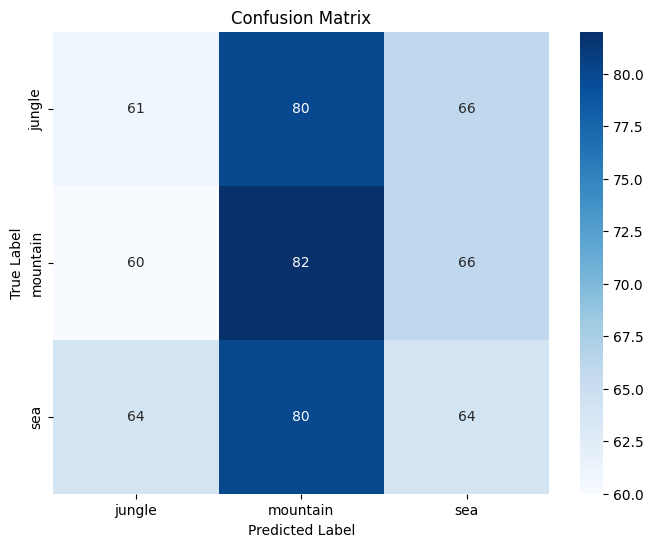

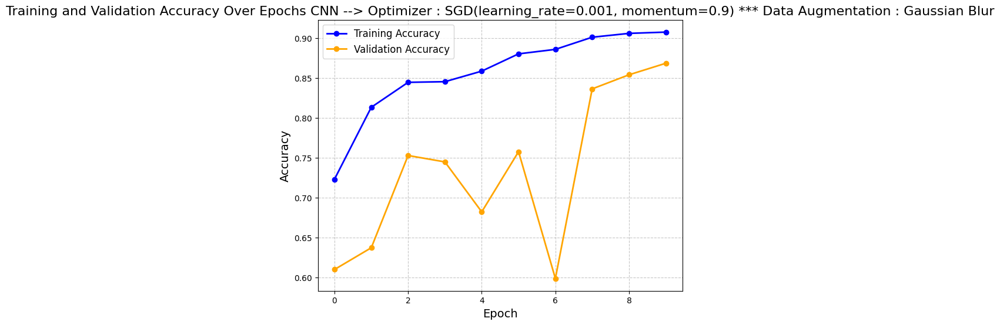

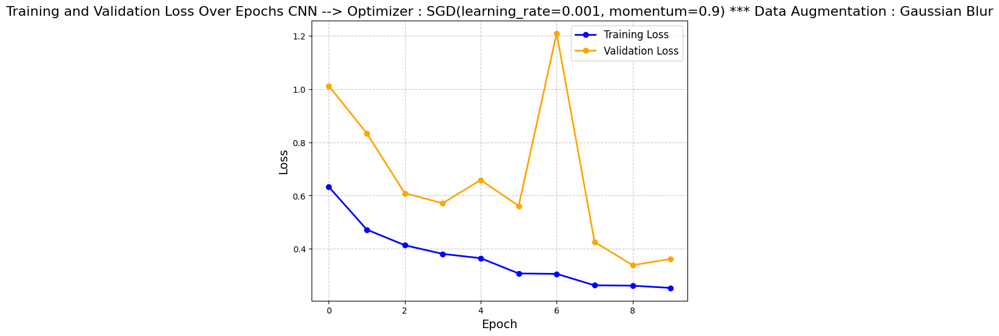

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Gaussian Blur',
 'Training Accuracy': 0.9074,
 'Training Loss': 0.2529,
 'Validation Accuracy': 0.8684,
 'Validation Loss': 0.3615,
 'Precision': 0.3317,
 'Recall': 0.3323,
 'F1-Score': 0.3309}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : SGD(learning_rate=0.001, momentum=0.9) *** Data Augmentation : Gaussian Blur", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Gaussian Blur"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

##### **Grayscale**

Grayscale is a commonly used image representation where each pixel in the image is represented by a single intensity value, typically ranging from 0 (black) to 255 (white), with shades of gray in between. Grayscale images are simpler than color images because they contain only one channel (intensity) instead of three channels (red, green, and blue) used in RGB color images.

Found 2495 images belonging to 3 classes.
Found 623 images belonging to 3 classes.


categorical


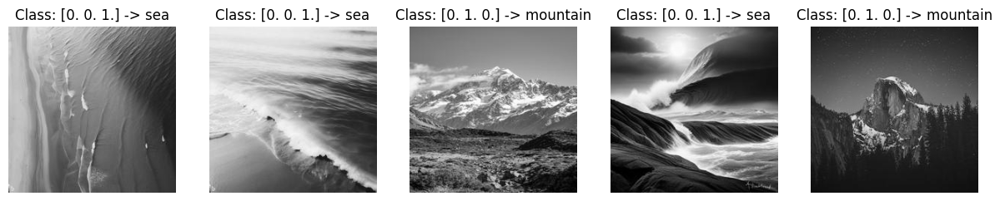

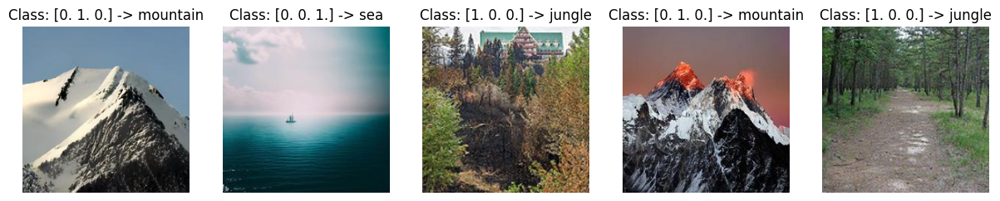

In [ ]:
train_generator_grayscale,validation_generator = Make_Dataset(dataset_path, batch_size, random_seed, 'categorical', 'Grayscale')

# Displaying samples from the training set with random rotation
display_sample_images(train_generator_grayscale)

# Displaying samples from the validation set
display_sample_images(validation_generator)

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'sgd')
# Train the model
history = model.fit(
    train_generator_grayscale,
    epochs=10,
    validation_data=validation_generator,
    callbacks=[early_stopping]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_24 (Conv2D)          (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_24 (Bat  (None, 112, 112, 64)     256       
 chNormalization)                                                
                                                                 
 re_lu_54 (ReLU)             (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                                 
 conv2d_25 (Conv2D)          (None, 56, 56, 64) 

                                                                 
 conv2d_27 (Conv2D)          (None, 56, 56, 128)       147584    
                                                                 
 batch_normalization_27 (Bat  (None, 56, 56, 128)      512       
 chNormalization)                                                
                                                                 
 conv2d_28 (Conv2D)          (None, 56, 56, 128)       147584    
                                                                 
 batch_normalization_28 (Bat  (None, 56, 56, 128)      512       
 chNormalization)                                                
                                                                 
 re_lu_56 (ReLU)             (None, 56, 56, 128)       0         
                                                                 
 conv2d_29 (Conv2D)          (None, 14, 14, 256)       295168    
                                                                 
 batch_nor

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.8569138050079346
Validation Accuracy: 0.5104333758354187
Training Loss: 0.3770608603954315
Validation Loss: 1.8985483646392822


20/20 [==============================] - 1s 49ms/step
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       207
           1       0.31      0.29      0.30       208
           2       0.33      0.69      0.45       208

    accuracy                           0.33       623
   macro avg       0.21      0.33      0.25       623
weighted avg       0.21      0.33      0.25       623



c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\A

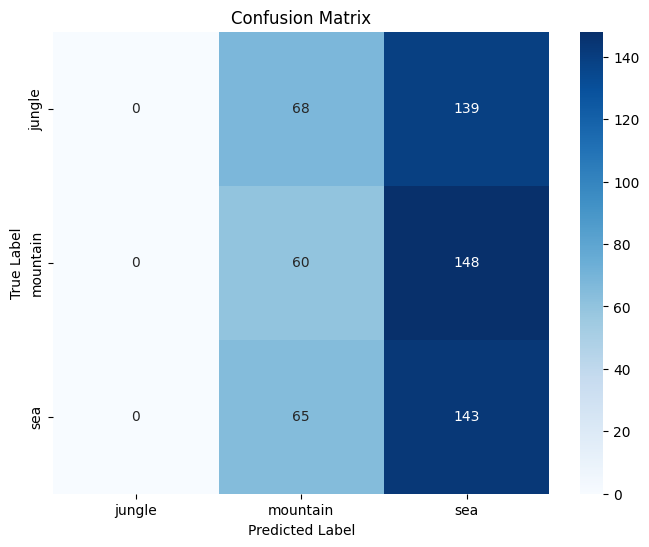

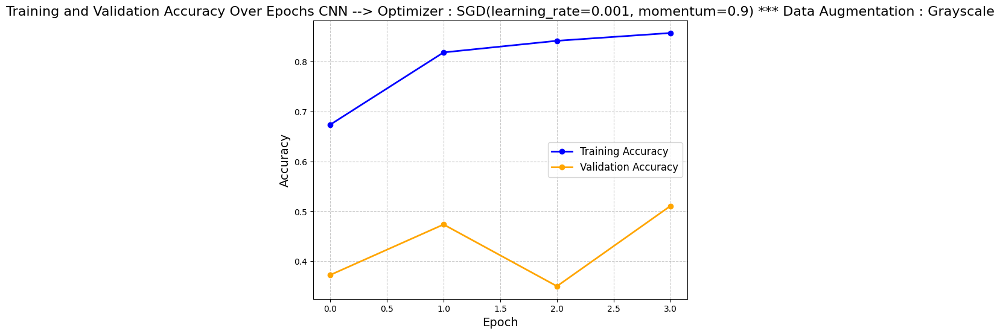

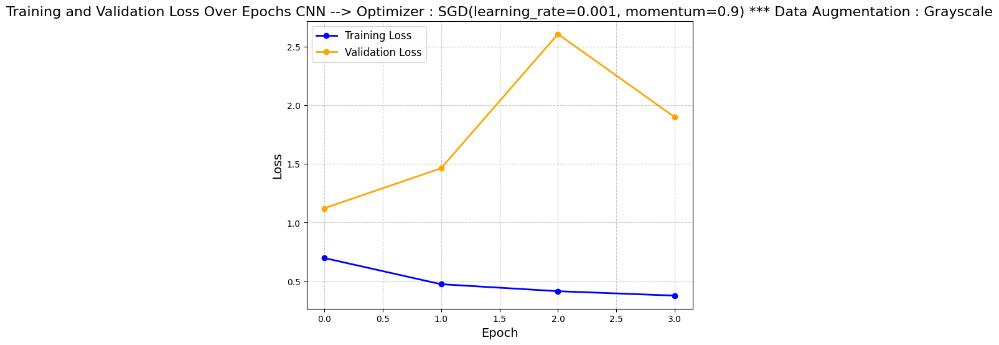

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Grayscale',
 'Training Accuracy': 0.8569,
 'Training Loss': 0.3771,
 'Validation Accuracy': 0.5104,
 'Validation Loss': 1.8985,
 'Precision': 0.2148,
 'Recall': 0.3258,
 'F1-Score': 0.2496}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : SGD(learning_rate=0.001, momentum=0.9) *** Data Augmentation : Grayscale", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Grayscale"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

##### **RandomHorizontalFlip & RandomVerticalFlip**

The concept of RandomFlip in the context of deep learning and image processing involves randomly flipping images along specified axes during the data augmentation process. This augmentation technique is used to increase the diversity of the training dataset and improve the generalization capability of a neural network.

Found 2495 images belonging to 3 classes.
Found 623 images belonging to 3 classes.


categorical


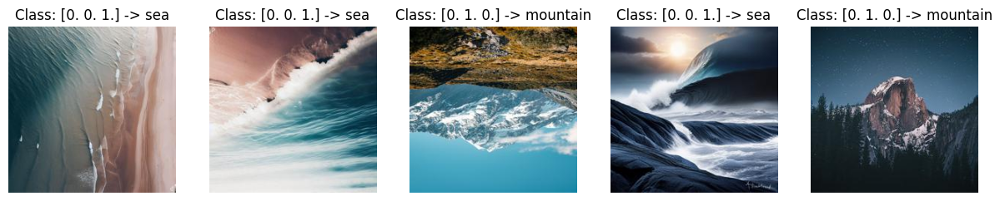

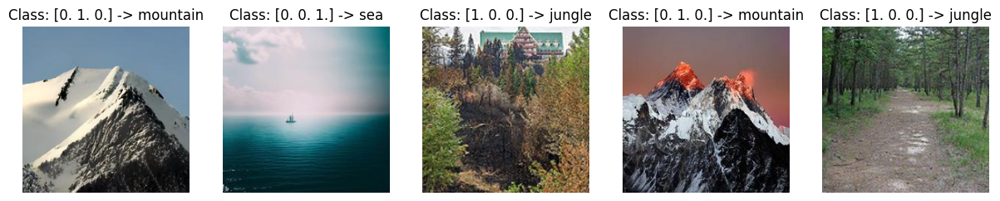

In [ ]:
train_generator_random_flip,validation_generator = Make_Dataset(dataset_path, batch_size, random_seed, 'categorical', 'RandomFlip')

# Displaying samples from the training set with random rotation
display_sample_images(train_generator_random_flip)

# Displaying samples from the validation set
display_sample_images(validation_generator)

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'sgd')
# Train the model
history = model.fit(
    train_generator_random_flip,
    epochs=10,
    validation_data=validation_generator,
    callbacks=[early_stopping]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_32 (Conv2D)          (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_32 (Bat  (None, 112, 112, 64)     256       
 chNormalization)                                                
                                                                 


 re_lu_59 (ReLU)             (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                                 
 conv2d_33 (Conv2D)          (None, 56, 56, 64)        36928     
                                                                 
 batch_normalization_33 (Bat  (None, 56, 56, 64)       256       
 chNormalization)                                                
                                                                 
 conv2d_34 (Conv2D)          (None, 56, 56, 128)       73856     
                                                                 
 batch_normalization_34 (Bat  (None, 56, 56, 128)      512       
 chNormalization)                                                
                                                                 
 re_lu_60 

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.8977956175804138
Validation Accuracy: 0.7833065986633301
Training Loss: 0.28085997700691223
Validation Loss: 0.5526705980300903


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.31      0.31      0.31       207
           1       0.32      0.17      0.22       208
           2       0.32      0.47      0.38       208

    accuracy                           0.32       623
   macro avg       0.32      0.32      0.30       623
weighted avg       0.32      0.32      0.30       623



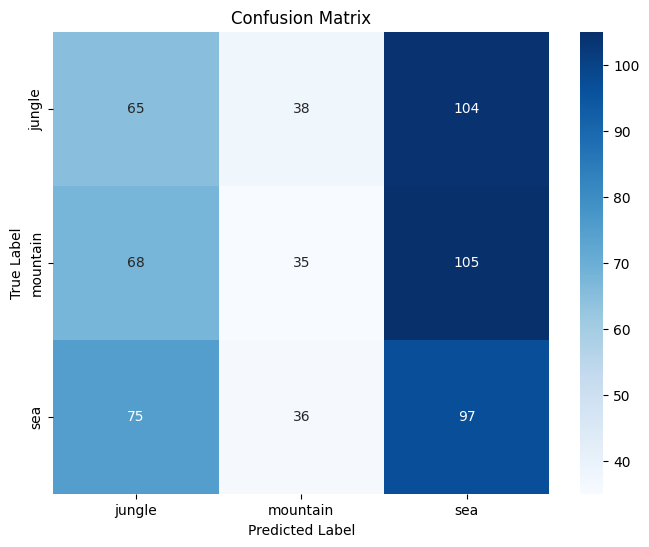

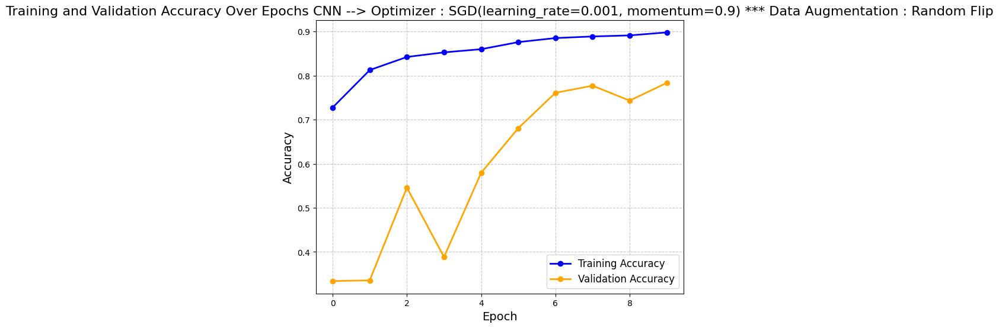

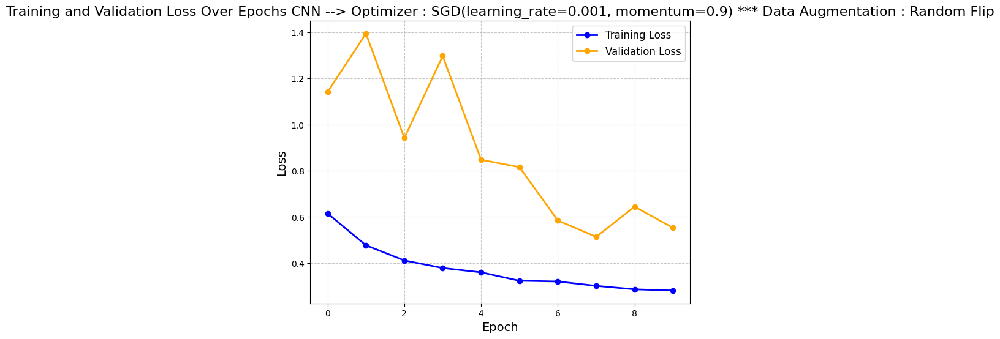

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Random Flip',
 'Training Accuracy': 0.8978,
 'Training Loss': 0.2809,
 'Validation Accuracy': 0.7833,
 'Validation Loss': 0.5527,
 'Precision': 0.3169,
 'Recall': 0.3162,
 'F1-Score': 0.3038}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : SGD(learning_rate=0.001, momentum=0.9) *** Data Augmentation : Random Flip", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Random Flip"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

##### **ColorJitter**

The concept of color jitter in the context of deep learning and image processing involves introducing small random variations in the color channels of an image during data augmentation. This technique is used to increase the diversity of the training dataset, enhance the model's robustness to variations in color, and improve its generalization performance.

Found 2495 images belonging to 3 classes.
Found 623 images belonging to 3 classes.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


categorical


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


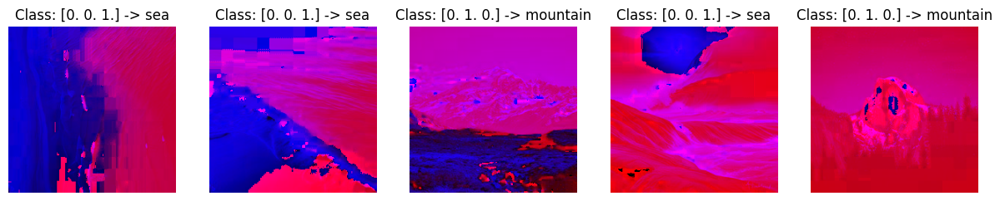

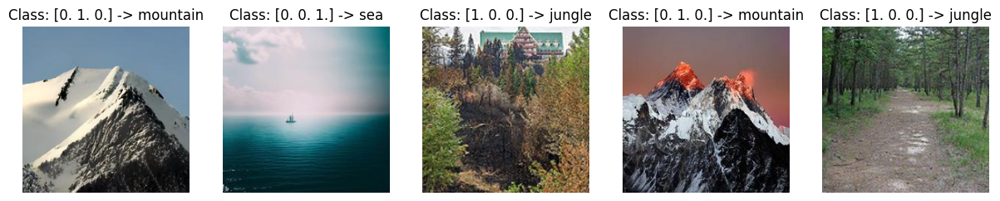

In [ ]:
#ColorJitter
train_generator_colorjitter,validation_generator = Make_Dataset(dataset_path, batch_size, random_seed, 'categorical', 'ColorJitter')

# Displaying samples from the training set with random rotation
display_sample_images(train_generator_colorjitter)

# Displaying samples from the validation set
display_sample_images(validation_generator)

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'sgd')
# Train the model
history = model.fit(
    train_generator_colorjitter,
    epochs=10,
    validation_data=validation_generator,
    callbacks=[early_stopping]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_40 (Conv2D)          (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_40 (Bat  (None, 112, 112, 64)     256       
 chNormalization)                                                
                                                                 
 re_lu_64 (ReLU)             (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                                 
 conv2d_41 (Conv2D)          (None, 56, 56, 64) 

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.8440881967544556
Validation Accuracy: 0.37078651785850525
Training Loss: 0.3836338222026825
Validation Loss: 1.99977707862854


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.37      0.19      0.25       207
           1       0.00      0.00      0.00       208
           2       0.34      0.84      0.48       208

    accuracy                           0.34       623
   macro avg       0.23      0.34      0.24       623
weighted avg       0.23      0.34      0.24       623



c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\A

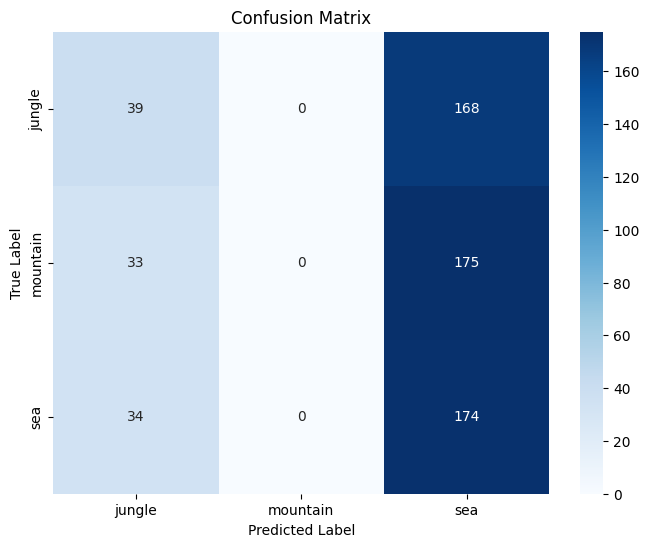

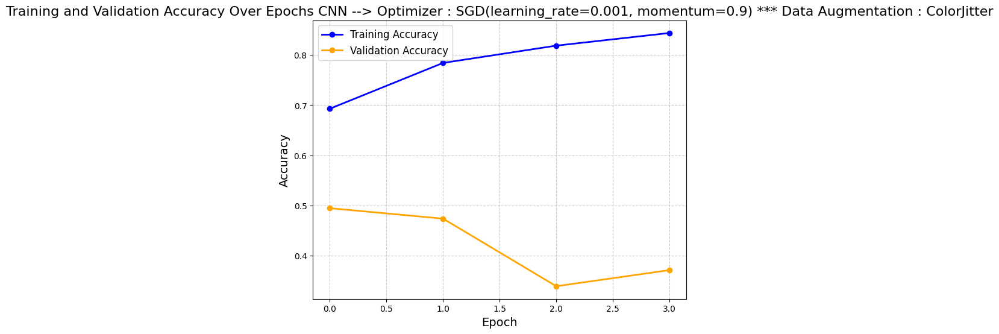

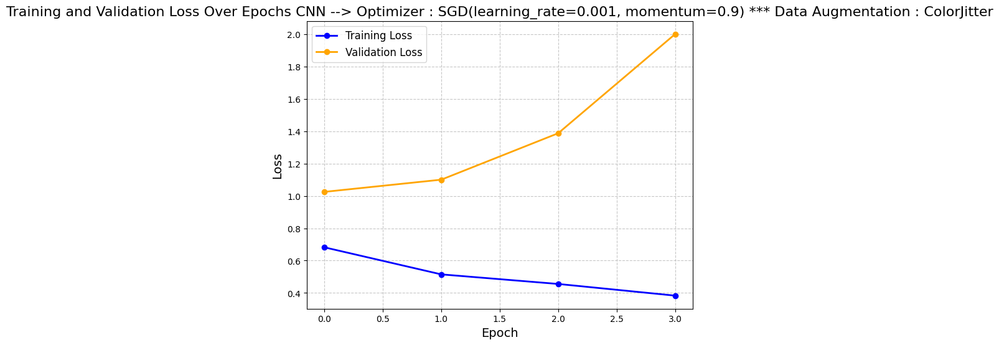

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'ColorJitter',
 'Training Accuracy': 0.8441,
 'Training Loss': 0.3836,
 'Validation Accuracy': 0.3708,
 'Validation Loss': 1.9998,
 'Precision': 0.2346,
 'Recall': 0.3419,
 'F1-Score': 0.2431}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : SGD(learning_rate=0.001, momentum=0.9) *** Data Augmentation : ColorJitter", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "ColorJitter"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

##### **MixUp**

Mixup is a data augmentation technique used in training deep neural networks, especially for image classification tasks. The idea behind Mixup is to generate synthetic training examples by linearly interpolating pairs of training examples and their labels. This helps the model to generalize better and improves its robustness.

Here's a backstage explanation of how Mixup works:

1. **Data Augmentation:**
   - Mixup operates on pairs of training examples. For each mini-batch, two random examples are selected from the training set.

2. **Interpolation:**
   - For each pair of examples (let's call them A and B), Mixup creates a synthetic example by linearly interpolating the pixel values and labels. The interpolated image and label are generated as follows:
     ```
     mixed_image = lambda * image_A + (1 - lambda) * image_B
     mixed_label = lambda * label_A + (1 - lambda) * label_B
     ```
     Here, `lambda` is a random value sampled from a beta distribution. This beta distribution is controlled by a hyperparameter called `alpha`, which determines the concentration of the distribution.

3. **Label Smoothing:**
   - The labels are usually one-hot encoded for classification tasks. Mixup smoothens the labels by performing linear interpolation on the one-hot encoded labels. This helps prevent the model from becoming too confident about its predictions.

4. **Training:**
   - The mixed examples (images and labels) are then used for training the neural network. The model learns to make predictions based on these synthetic examples, and the loss is computed by comparing the predicted output with the mixed labels.

Mixup encourages the model to learn more robust features and reduces overfitting by exposing the model to a wider range of synthetic data. It is particularly useful when the amount of labeled training data is limited. Mixup is a regularization technique that enhances the generalization capabilities of deep learning models.

In [ ]:
def display_sample_images_for_mixup(generator, num_images=5, figsize=(15, 5)):
    # Generate a batch of images and labels from the generator
    sample_images, sample_labels = next(generator)

    # Display the images
    plt.figure(figsize=figsize)
    for i in range(num_images):
        plt.subplot(1, num_images, i+1)

        # Check if the image is grayscale
        if sample_images.shape[3] == 1:
            # If grayscale, use 'gray' colormap
            plt.imshow(np.squeeze(sample_images[i]), cmap='gray')
        else:
            # If RGB, use default colormap
            plt.imshow(sample_images[i])

        # Display the mixed labels as text
        if isinstance(sample_labels, list):
            # If labels are a list (multiple outputs), display each label
            label_text = ', '.join([f'{label[i]:.2f}' for label in sample_labels])
        else:
            # If labels are a single output, display it
            label_text = ', '.join([f'{label:.2f}' for label in sample_labels[i]])

        plt.title(f'Class: {label_text}')
        plt.axis('off')

    plt.show()

Found 2495 images belonging to 3 classes.
Found 2495 images belonging to 3 classes.
Found 623 images belonging to 3 classes.
categorical


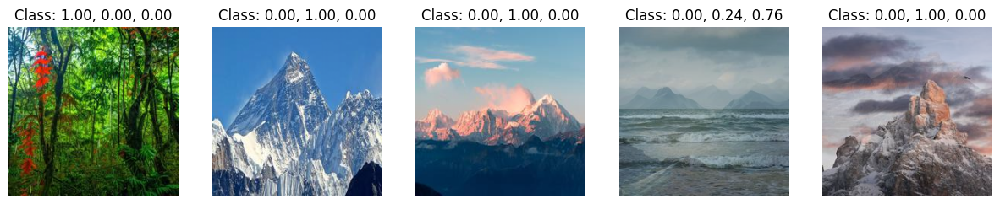

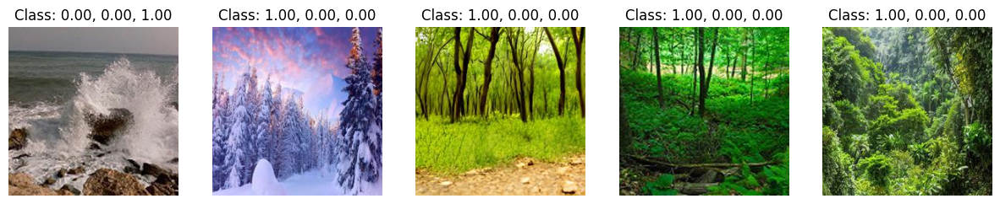

In [ ]:
#make basic dataset
train_generator_mixup, validation_generator = Make_Dataset(dataset_path, batch_size, random_seed, 'categorical', data_augmentation = 'MixUp')
display_sample_images_for_mixup(train_generator_mixup)
display_sample_images_for_mixup(validation_generator)

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'sgd')


# Train the model with Mixup
history_mixup = model.fit(
    train_generator_mixup,
    epochs=10,
    validation_data=validation_generator,
    steps_per_epoch=train_generator_mixup.get_steps_per_epoch() // batch_size,
    validation_steps=validation_generator.samples // batch_size,
    callbacks=[early_stopping]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_48 (Conv2D)          (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_48 (Bat  (None, 112, 112, 64)     256       
 chNormalization)                                                
                                                                 
 re_lu_69 (ReLU)             (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                                 
 conv2d_49 (Conv2D)          (None, 56, 56, 64) 

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.671875
Validation Accuracy: 0.33388158679008484
Training Loss: 0.729364275932312
Validation Loss: 1.0948431491851807


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       207
           1       0.00      0.00      0.00       208
           2       0.33      1.00      0.50       208

    accuracy                           0.33       623
   macro avg       0.11      0.33      0.17       623
weighted avg       0.11      0.33      0.17       623



c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\A

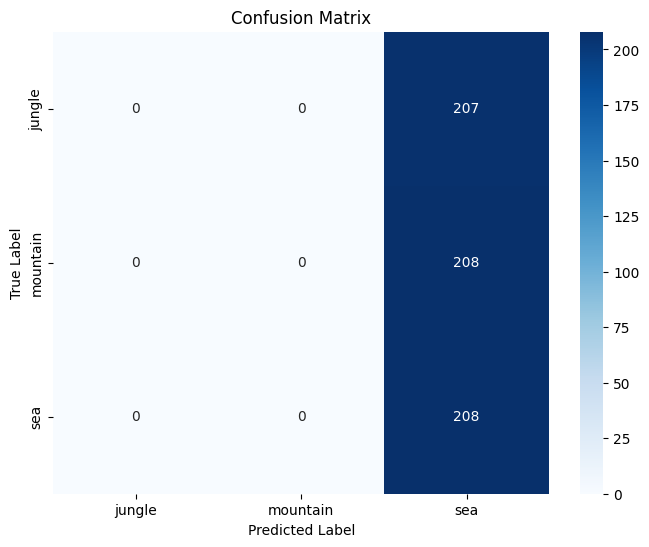

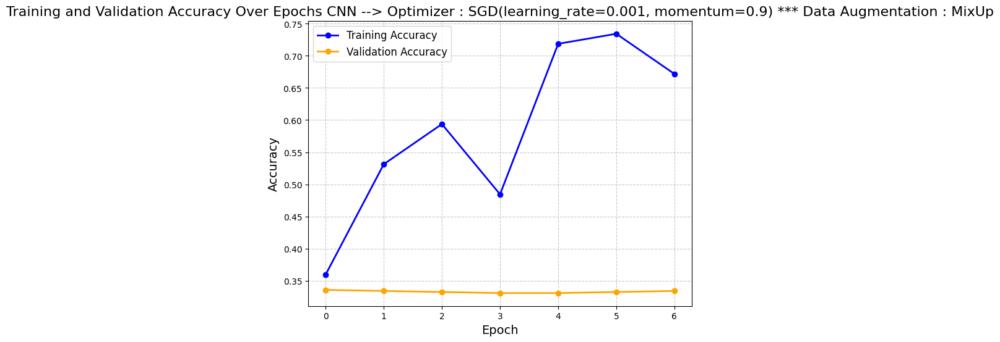

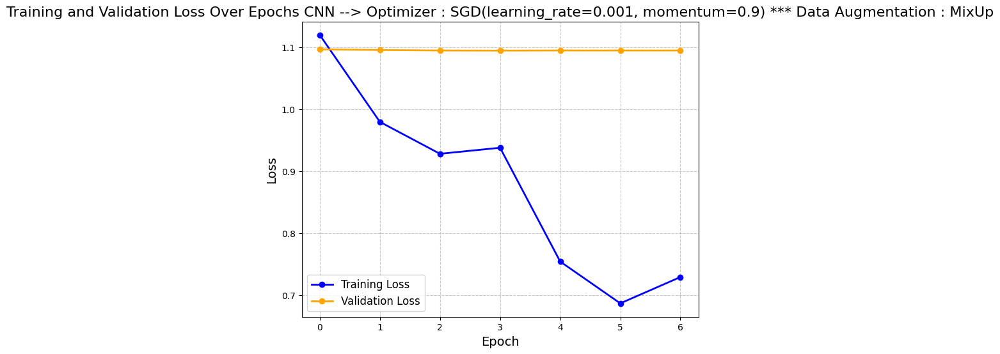

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'MixUp',
 'Training Accuracy': 0.6719,
 'Training Loss': 0.7294,
 'Validation Accuracy': 0.3339,
 'Validation Loss': 1.0948,
 'Precision': 0.1115,
 'Recall': 0.3339,
 'F1-Score': 0.1671}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history_mixup, model, validation_generator, " CNN --> Optimizer : SGD(learning_rate=0.001, momentum=0.9) *** Data Augmentation : MixUp", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "MixUp"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

##### **Random Crop**

To implement random crop without using keras.layers.RandomCrop, we can modify the training data generator to apply random crops using the width_shift_range and height_shift_range parameters in ImageDataGenerator. Here's the modified code:

Found 2495 images belonging to 3 classes.
Found 623 images belonging to 3 classes.


categorical


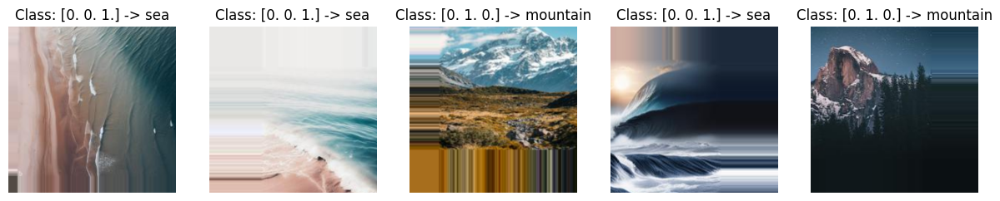

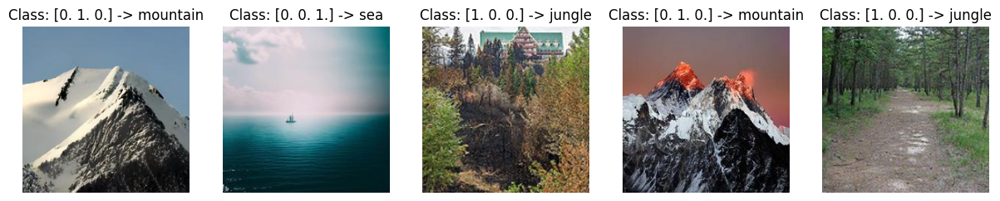

In [ ]:
#ColorJitter
train_generator_random_crop,validation_generator = Make_Dataset(dataset_path, batch_size, random_seed, 'categorical', 'RandomCrop')

# Displaying samples from the training set with random rotation
display_sample_images(train_generator_random_crop)

# Displaying samples from the validation set
display_sample_images(validation_generator)

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'sgd')
# Train the model
history = model.fit(
    train_generator_random_crop,
    epochs=10,
    validation_data=validation_generator,
    callbacks=[early_stopping]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_56 (Conv2D)          (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_56 (Bat  (None, 112, 112, 64)     256       
 chNormalization)                                                
                                                                 
 re_lu_74 (ReLU)             (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                                 
 conv2d_57 (Conv2D)          (None, 56, 56, 64) 

                                                                 
 batch_normalization_60 (Bat  (None, 56, 56, 128)      512       
 chNormalization)                                                
                                                                 
 re_lu_76 (ReLU)             (None, 56, 56, 128)       0         
                                                                 
 conv2d_61 (Conv2D)          (None, 14, 14, 256)       295168    
                                                                 
 batch_normalization_61 (Bat  (None, 14, 14, 256)      1024      
 chNormalization)                                                
                                                                 
 conv2d_62 (Conv2D)          (None, 14, 14, 256)       590080    
                                                                 
 batch_normalization_62 (Bat  (None, 14, 14, 256)      1024      
 chNormalization)                                                
          

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.858517050743103
Validation Accuracy: 0.6292135119438171
Training Loss: 0.3790065348148346
Validation Loss: 0.9522945880889893


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.35      0.27      0.30       207
           1       0.33      0.47      0.39       208
           2       0.30      0.24      0.27       208

    accuracy                           0.33       623
   macro avg       0.33      0.33      0.32       623
weighted avg       0.33      0.33      0.32       623



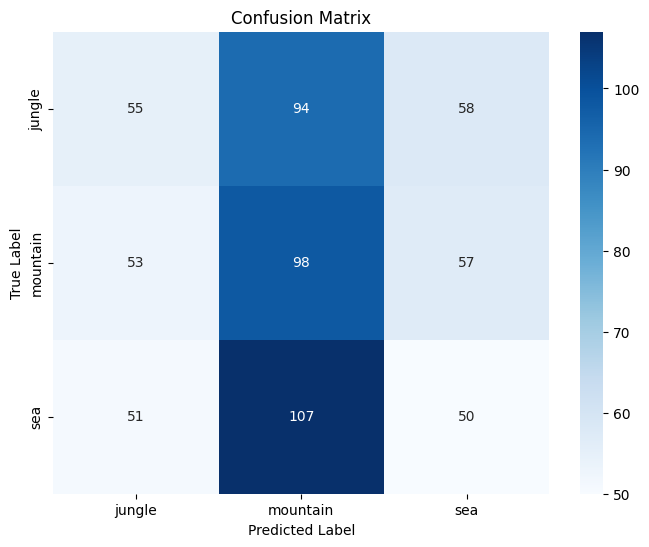

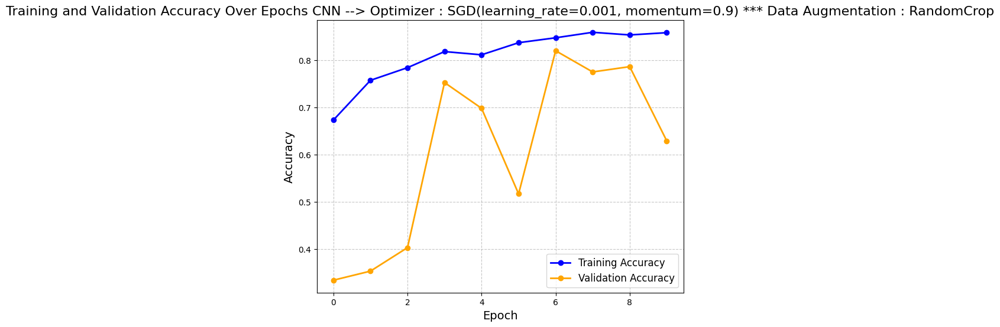

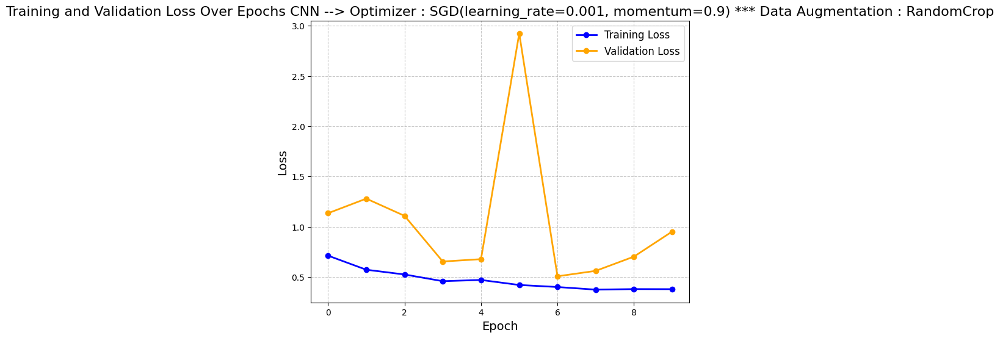

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'RandomCrop',
 'Training Accuracy': 0.8585,
 'Training Loss': 0.379,
 'Validation Accuracy': 0.6292,
 'Validation Loss': 0.9523,
 'Precision': 0.3255,
 'Recall': 0.3258,
 'F1-Score': 0.3184}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : SGD(learning_rate=0.001, momentum=0.9) *** Data Augmentation : RandomCrop", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "RandomCrop"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

### **Optimization Algorithm**

Found 2495 images belonging to 3 classes.


Found 623 images belonging to 3 classes.
categorical


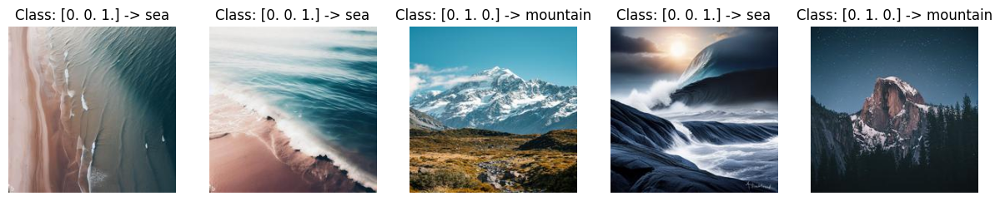

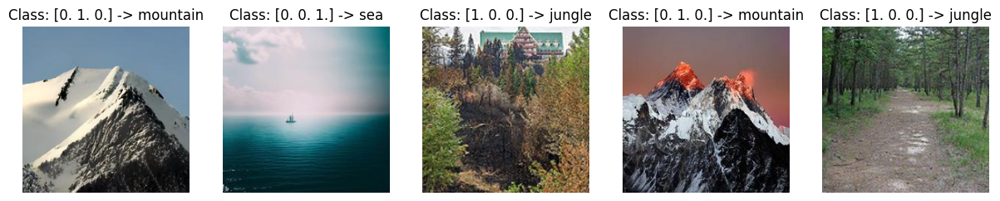

In [ ]:
train_generator, validation_generator = Make_Dataset(dataset_path, batch_size, random_seed, 'categorical')

# Displaying samples from the training set with random rotation
display_sample_images(train_generator)

# Displaying samples from the validation set
display_sample_images(validation_generator)

#### **`CNN` Model From Scratch (with Optimizers)**



##### **Stochastic Gradient Descent (SGD)**

***I USE THIS IN PREVIOUS MODELS***

Stochastic Gradient Descent (SGD) is a fundamental optimization algorithm used for training machine learning models, including neural networks. It is a variant of the traditional gradient descent algorithm and is particularly well-suited for large datasets. SGD optimizes a model's parameters by iteratively updating them based on the gradients of the loss function with respect to those parameters, computed on a subset of the training data (a mini-batch) rather than the entire dataset.

Here are the key concepts of Stochastic Gradient Descent:

1. **Gradient Calculation:**
   In each iteration (or epoch) of training, SGD randomly selects a mini-batch of data samples from the training set. The gradient of the loss function with respect to the model parameters is then calculated using only this mini-batch.

    $\nabla J(\theta) = \frac{1}{|\text{Mini-batch}|} \sum_{i \in \text{Mini-batch}} \nabla J_i(\theta)$

   Where:
   - $( \nabla J(\theta) )$ is the gradient of the overall loss function,
   - $( \nabla J_i(\theta) )$ is the gradient of the loss function for the $(i)$-th sample in the mini-batch.

2. **Parameter Update:**
   The model parameters $( \theta )$ are then updated using the computed gradient and a learning rate $( \alpha )$:

   $\theta_{t+1} = \theta_t - \alpha \nabla J(\theta_t)$

   Where:
   - $( \theta_t )$ is the model parameter vector at iteration $( t )$,
   - $( \alpha )$ is the learning rate.

3. **Randomness and Noise:**
   The stochastic nature of SGD, introduced by using random mini-batches, adds noise to the optimization process. While this randomness may introduce fluctuations in the training process, it often helps escape local minima and explore the parameter space more effectively.

SGD has some variants, such as mini-batch SGD (using a small random subset of the data), and full-batch SGD (using the entire dataset). The choice of mini-batch size and learning rate are crucial hyperparameters in SGD, and tuning them can significantly impact the training performance.

Despite its simplicity, SGD is widely used in practice due to its efficiency, especially when dealing with large datasets, and its ability to work well in various optimization scenarios. However, it may have challenges converging in some cases, and other advanced optimization algorithms, such as Adam or RMSprop, are often used to address these issues.

##### **Adam**


The key components of the Adam optimizer:

1. **Gradient Descent with Momentum:**
   Adam incorporates the concept of momentum from gradient descent algorithms. Momentum helps the optimizer to continue moving in the direction of the previous gradients, enhancing convergence and overcoming potential oscillations.

2. **RMSprop (Root Mean Square Propagation):**
   Adam also incorporates the RMSprop algorithm, which helps adaptively adjust the learning rates for each parameter. It maintains an exponentially decaying average of squared gradients for each parameter, and the square root of this average is used to normalize the gradients during the parameter updates.

3. **Adaptive Learning Rates:**
   Adam combines the ideas of momentum and RMSprop to adaptively adjust the learning rates for each parameter. It maintains two moving averages for each parameter: the first moment (mean) and the second moment (uncentered variance). These moving averages are then used to adjust the learning rates for each parameter individually.

4. **Bias Correction:**
   Adam incorporates a bias correction mechanism to account for the fact that the moving averages are biased towards zero, especially during the initial training steps. This correction helps stabilize the training process and provides more accurate updates to the model parameters.

The update rule for the parameters (weights and biases) using Adam can be expressed as follows:

$\theta_{t+1} = \theta_t - \frac{\alpha}{\sqrt{\hat{v}_t} + \epsilon} \hat{m}_t$

Where:
- $(\theta_t)$is the parameter at time step $(t)$,
- $(\alpha)$ is the learning rate,
- $(\hat{m}_t)$ is the biased-corrected estimate of the first moment
- $(\hat{v}_t)$ is the biased-corrected estimate of the second moment
- $(\epsilon)$ is a small constant to prevent division by zero.

`Adam` optimizer combines the benefits of `momentum` and adaptive learning rates through `RMSprop`, resulting in faster and more effective convergence during the training of neural networks.

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'adam')
# Train the model
history = model.fit(
    train_generator,
    epochs=10,
    validation_data=validation_generator,
    callbacks=[early_stopping]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
Optimizer : Adam(learning_rate=0.001)
Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_64 (Conv2D)          (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_64 (Bat  (None, 112, 112, 64)     256       
 chNormalization)                                                
                                                                 
 re_lu_79 (ReLU)             (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                                 
 conv2d_65 (Conv2D)          (None, 56, 56, 64)        36928

                                                                 
 conv2d_66 (Conv2D)          (None, 56, 56, 128)       73856     
                                                                 
 batch_normalization_66 (Bat  (None, 56, 56, 128)      512       
 chNormalization)                                                
                                                                 
 re_lu_80 (ReLU)             (None, 56, 56, 128)       0         
                                                                 
 conv2d_67 (Conv2D)          (None, 56, 56, 128)       147584    
                                                                 
 batch_normalization_67 (Bat  (None, 56, 56, 128)      512       
 chNormalization)                                                
                                                                 
 conv2d_68 (Conv2D)          (None, 56, 56, 128)       147584    
                                                                 
 batch_nor

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.8809618949890137
Validation Accuracy: 0.6276083588600159
Training Loss: 0.328718900680542
Validation Loss: 1.6153539419174194


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.33      0.46      0.39       207
           1       0.34      0.33      0.34       208
           2       0.34      0.21      0.26       208

    accuracy                           0.34       623
   macro avg       0.34      0.34      0.33       623
weighted avg       0.34      0.34      0.33       623



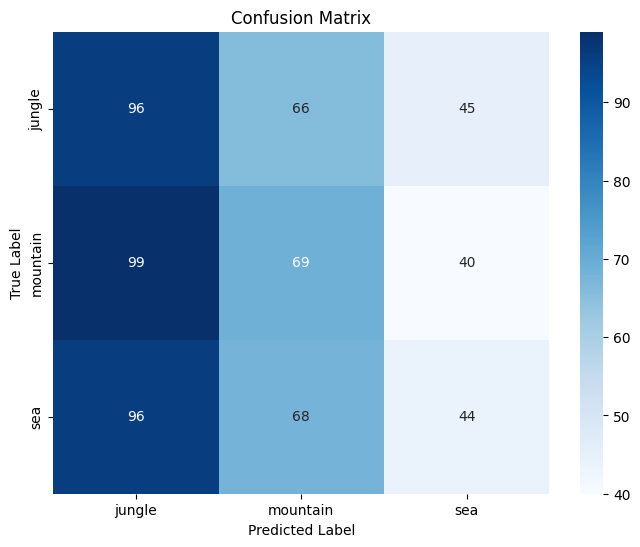

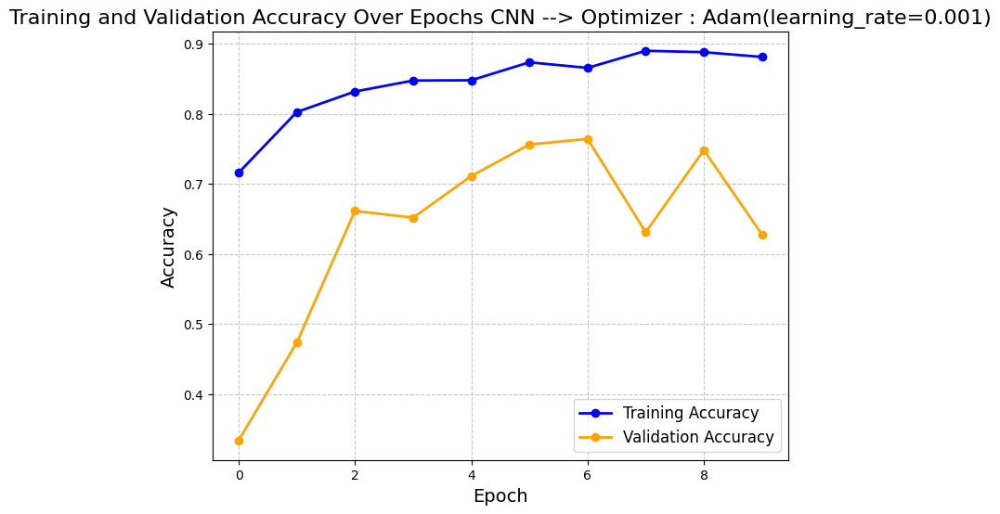

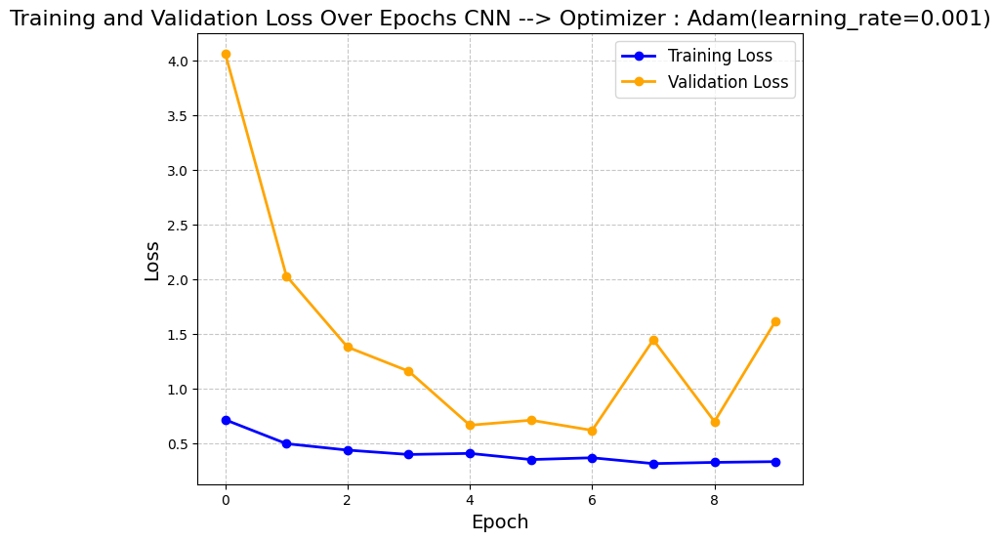

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'Adam(learning_rate=0.001)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.881,
 'Training Loss': 0.3287,
 'Validation Accuracy': 0.6276,
 'Validation Loss': 1.6154,
 'Precision': 0.337,
 'Recall': 0.3355,
 'F1-Score': 0.3274}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : Adam(learning_rate=0.001)", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "Adam(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

##### **AdamW**

AdamW is an extension or modification of the Adam optimizer, designed to address certain issues related to weight decay during the training of neural networks. Weight decay is a regularization technique used to prevent overfitting by penalizing large weights in the model. However, traditional weight decay in the original Adam optimizer had some shortcomings, and AdamW was introduced to mitigate these issues.

The key modification in AdamW involves the way weight decay is applied. In the original Adam optimizer, the weight decay term is added directly to the parameter update step. In contrast, AdamW decouples weight decay from the parameter update and introduces it as a separate term. This change has been shown to provide more stable and effective regularization, particularly in the context of deep learning.

The update rule for AdamW can be expressed as follows:

$\theta_{t+1} = \theta_t - \frac{\alpha}{\sqrt{\hat{v}_t} + \epsilon} \left(\hat{m}_t + \lambda \theta_t\right)$

Where:
- $(\theta_t)$ is the parameter at time step $(t)$,
- $(\alpha)$ is the learning rate,
- $(\hat{m}_t)$ is the biased-corrected estimate of the first moment,
- $(\hat{v}_t)$ is the biased-corrected estimate of the second moment,
- $(\epsilon)$ is a small constant to prevent division by zero,
- $(\lambda)$ is the weight decay coefficient.

The term $\lambda \theta_t$ is the weight decay term, and it is added to the update along with the momentum term. Decoupling weight decay in this manner has been shown to provide more stable training and improved generalization performance.

AdamW is an extension of the Adam optimizer that introduces a modification to the weight decay mechanism, leading to more effective regularization and improved performance in training deep neural networks.

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'adamw')
# Train the model
history = model.fit(
    train_generator,
    epochs=10,
    validation_data=validation_generator,
    callbacks=[early_stopping]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
AdamW(learning_rate=0.001, weight_decay=0.01)
Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_72 (Conv2D)          (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_72 (Bat  (None, 112, 112, 64)     256       
 chNormalization)                                                
                                                                 
 re_lu_84 (ReLU)             (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                                 
 conv2d_73 (Conv2D)          (None, 56, 56, 64)     

 batch_normalization_78 (Bat  (None, 14, 14, 256)      1024      
 chNormalization)                                                
                                                                 
 re_lu_87 (ReLU)             (None, 14, 14, 256)       0         
                                                                 
 conv2d_79 (Conv2D)          (None, 7, 7, 512)         1180160   
                                                                 
 batch_normalization_79 (Bat  (None, 7, 7, 512)        2048      
 chNormalization)                                                
                                                                 
 re_lu_88 (ReLU)             (None, 7, 7, 512)         0         
                                                                 
 global_average_pooling2d_11  (None, 512)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_11 

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.7819639444351196
Validation Accuracy: 0.3338683843612671
Training Loss: 0.6354526281356812
Validation Loss: 1.1025017499923706


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       207
           1       0.41      0.35      0.38       208
           2       0.35      0.75      0.48       208

    accuracy                           0.37       623
   macro avg       0.25      0.37      0.28       623
weighted avg       0.25      0.37      0.28       623



c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\A

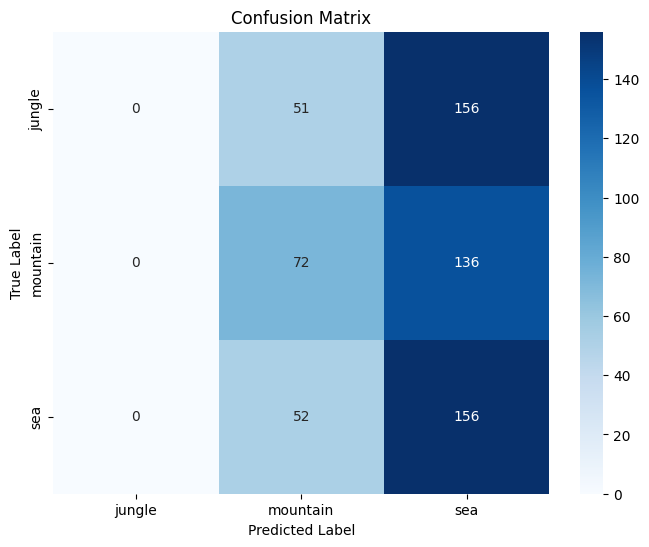

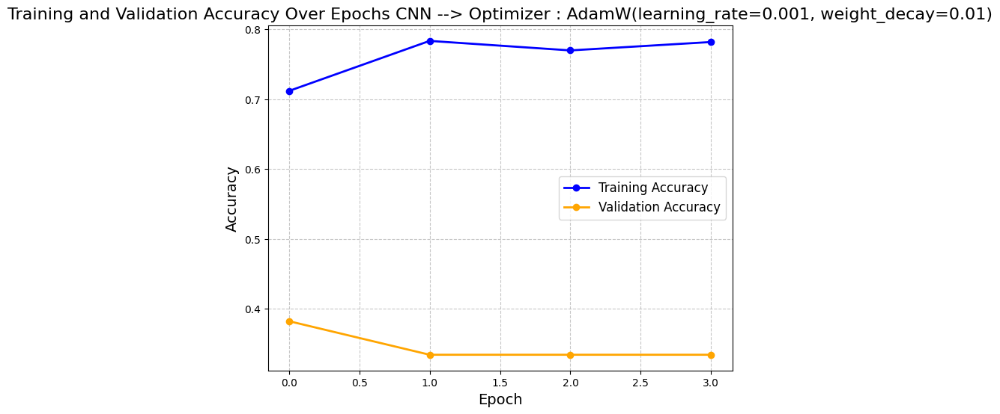

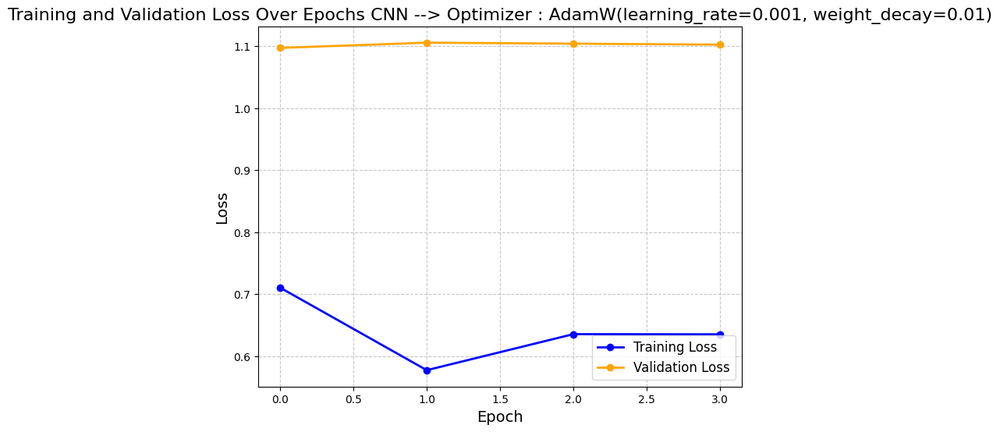

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'AdamW(learning_rate=0.001, weight_decay=0.01)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.782,
 'Training Loss': 0.6355,
 'Validation Accuracy': 0.3339,
 'Validation Loss': 1.1025,
 'Precision': 0.2536,
 'Recall': 0.366,
 'F1-Score': 0.2843}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : AdamW(learning_rate=0.001, weight_decay=0.01)", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "AdamW(learning_rate=0.001, weight_decay=0.01)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

##### **RMSprop**

RMSprop, which stands for Root Mean Square Propagation, is an optimization algorithm used for training neural networks. It is designed to address some of the limitations of traditional gradient descent algorithms, particularly those related to adaptive learning rates. RMSprop adapts the learning rates for each parameter individually based on the historical information of the gradients.

Here are the key components of the RMSprop algorithm:

1. **Exponentially Weighted Moving Averages:**
   RMSprop maintains an exponentially decaying average of squared gradients for each parameter. This running average helps to capture the historical information about the gradients, giving more weight to recent gradients while diminishing the impact of older ones.

   $v_t = \beta v_{t-1} + (1 - \beta) (\nabla J(\theta_t))^2$

   Where:
   - $(v_t)$ is the moving average of squared gradients at time $(t)$,
   - $(\beta)$ is the decay rate (typically close to 1),
   - $(\nabla J(\theta_t))$ is the gradient of the loss function with respect to the parameters at time $(t)$.

2. **Adaptive Learning Rates:**
   RMSprop uses the square root of the moving average of squared gradients $(\sqrt{v_t})$ to scale the learning rates for each parameter. This adaptive learning rate ensures that parameters with large gradients receive smaller updates, and parameters with small gradients receive larger updates.

   $ \theta_{t+1} = \theta_t - \frac{\alpha}{\sqrt{v_t} + \epsilon} \nabla J(\theta_t) $

   Where:
   - $(\alpha)$ is the learning rate,
   - $(\epsilon)$ is a small constant to prevent division by zero.

The adaptive learning rates provided by RMSprop help address the problem of choosing a global learning rate for all parameters, which may be suboptimal due to variations in the gradients of different parameters. This adaptive mechanism often results in faster convergence and improved training performance.

In summary, RMSprop is an optimization algorithm that adapts the learning rates for each parameter individually, making use of exponentially weighted moving averages of squared gradients. It is effective in training neural networks by providing a balance between the stability of convergence and the ability to handle different scales of gradients across parameters.

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'rmsprop')
# Train the model
history = model.fit(
    train_generator,
    epochs=10,
    validation_data=validation_generator,
    callbacks=[early_stopping]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
RMSprop(learning_rate=0.001)
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_80 (Conv2D)          (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_80 (Bat  (None, 112, 112, 64)     256       
 chNormalization)                                                
                                                                 
 re_lu_89 (ReLU)             (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_81 (Conv2D)          (None, 56, 56, 64)        36928     
   

                                                                 
 batch_normalization_87 (Bat  (None, 7, 7, 512)        2048      
 chNormalization)                                                
                                                                 
 re_lu_93 (ReLU)             (None, 7, 7, 512)         0         
                                                                 
 global_average_pooling2d_12  (None, 512)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_12 (Dense)            (None, 3)                 1539      
                                                                 
Total params: 2,483,907
Trainable params: 2,480,835
Non-trainable params: 3,072
_________________________________________________________________
Epoch 1/10
78/78 [==============================] - 15s 166ms/step - loss: 0.7990 - accuracy: 0.6745 - val_loss: 9.0923 - val_ac

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.8953908085823059
Validation Accuracy: 0.7945425510406494
Training Loss: 0.2947665750980377
Validation Loss: 0.556132435798645


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.29      0.31      0.30       207
           1       0.29      0.17      0.22       208
           2       0.30      0.40      0.34       208

    accuracy                           0.30       623
   macro avg       0.29      0.30      0.29       623
weighted avg       0.29      0.30      0.29       623



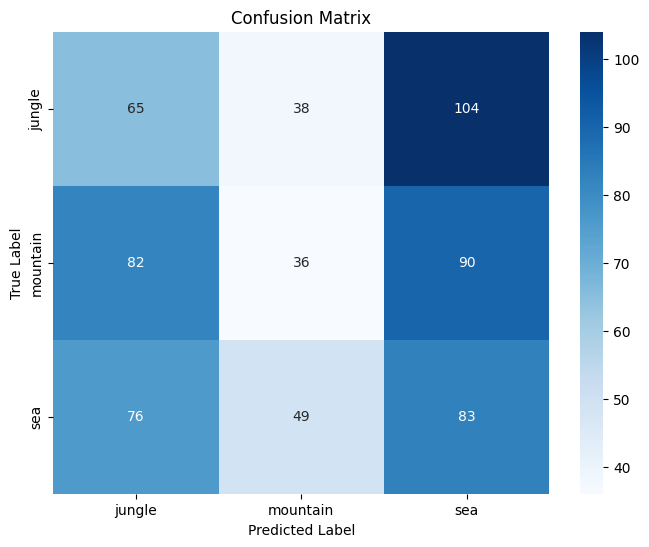

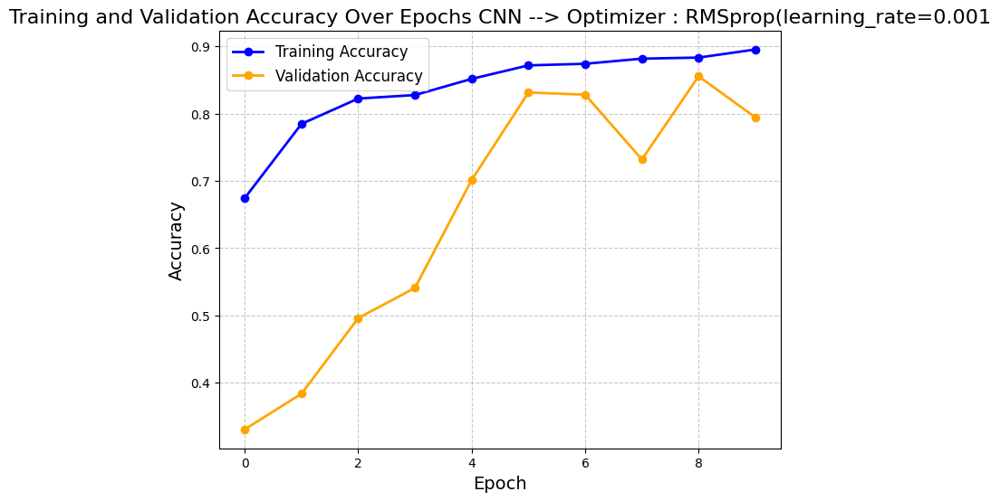

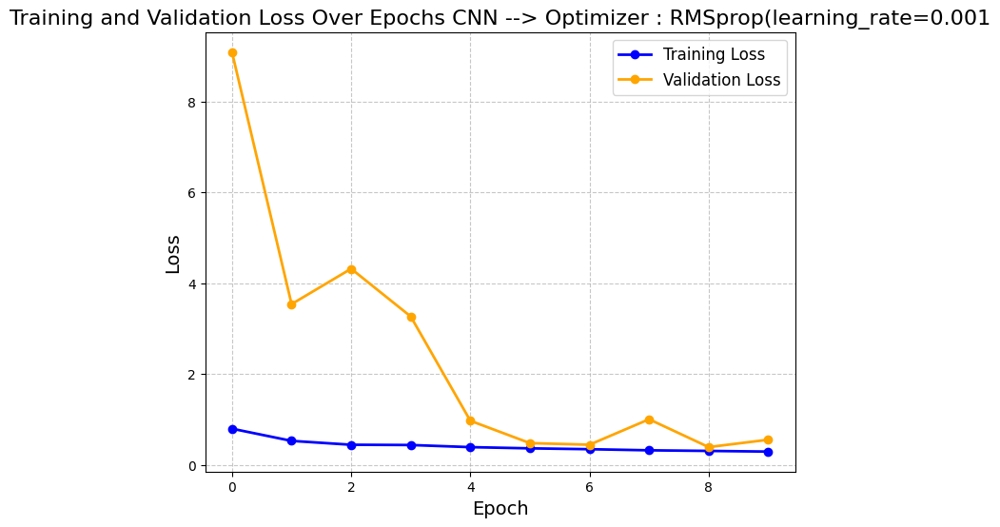

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'RMSprop(learning_rate=0.001)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.8954,
 'Training Loss': 0.2948,
 'Validation Accuracy': 0.7945,
 'Validation Loss': 0.5561,
 'Precision': 0.2946,
 'Recall': 0.2953,
 'F1-Score': 0.2873}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : RMSprop(learning_rate=0.001", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "RMSprop(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

##### **SAM**

**Intuition of `SAM`:**

1. **Sharpness Awareness:**
   - The core idea behind SAM is to be "sharpness-aware" during optimization. Sharpness refers to the flatness or curvature of the loss landscape. In training neural networks, finding a flat and smooth region in the loss landscape can lead to more robust and generalizable models.

2. **Optimizing in Flat Regions:**
   - SAM aims to guide the optimization process to explore and stay in flat regions of the loss landscape. In these flat regions, small changes to the model parameters result in minimal changes to the loss. This characteristic is desirable as it indicates a more stable and generalizable solution.

3. **Stochastic Gradients and Sharpness:**
   - Traditional optimization methods rely on stochastic gradients to update model parameters. SAM introduces a modification to the way gradients are used. It computes a gradient-weighted average over a local neighborhood around the current parameter set, considering both the first and second moments of the gradients. This weighted average helps to identify regions of sharpness in the loss landscape.

4. **Normalization and Learning Rates:**
   - SAM normalizes the computed average gradients to obtain a direction that is invariant to the scale of the sharpness. This normalization step is crucial for the efficiency of the optimization process. It also adapts the learning rate based on the sharpness of the current region, allowing for more cautious updates in sharp areas and larger steps in flat regions.

5. **Improved Generalization:**
   - By being sharpness-aware and guiding the optimization process towards flatter regions, SAM aims to improve the generalization of the trained neural network. Models that generalize well perform better on unseen data, making them more applicable to real-world scenarios.

In [ ]:
from tensorflow.keras.layers import Conv2D, BatchNormalization, ReLU, MaxPooling2D, Flatten, Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Sequential, Model
from sam import sam_train_step

# Create a SAM model
class CustomModelSAM(Model):
    def __init__(self, base_model):
        super(CustomModelSAM, self).__init__()
        self.base_model = base_model

    def call(self, x):
        return self.base_model(x)

    def train_step(self, data):
        return sam_train_step(self, data)

In [ ]:
# Create an instance of the SAM model
model = cnn_categorical()
sam_model = CustomModelSAM(base_model=model)
sam_model.build((None, 224, 224, 3))
sam_model.set_weights(model.get_weights())

In [ ]:
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.metrics import CategoricalAccuracy

# Compile the SAM model
sam_optimizer = RMSprop(learning_rate=0.001, rho=0.9, momentum=0.0, epsilon=1e-07, centered=False)
sam_model.compile(optimizer=sam_optimizer,
                  loss=CategoricalCrossentropy(),
                  metrics=[CategoricalAccuracy()],)

# Train the SAM model
history = sam_model.fit(train_generator, epochs=10, validation_data=validation_generator)


Epoch 1/10


78/78 [==============================] - 28s 328ms/step - loss: 0.3295 - categorical_accuracy: 0.8649 - val_loss: 0.3655 - val_categorical_accuracy: 0.8620
Epoch 2/10
78/78 [==============================] - 26s 328ms/step - loss: 0.3091 - categorical_accuracy: 0.8810 - val_loss: 0.3164 - val_categorical_accuracy: 0.8748
Epoch 3/10
78/78 [==============================] - 26s 328ms/step - loss: 0.3046 - categorical_accuracy: 0.8806 - val_loss: 0.5170 - val_categorical_accuracy: 0.8266
Epoch 4/10
78/78 [==============================] - 26s 328ms/step - loss: 0.2777 - categorical_accuracy: 0.8906 - val_loss: 0.4547 - val_categorical_accuracy: 0.8315
Epoch 5/10
78/78 [==============================] - 26s 331ms/step - loss: 0.2817 - categorical_accuracy: 0.8830 - val_loss: 0.2833 - val_categorical_accuracy: 0.9005
Epoch 6/10
78/78 [==============================] - 26s 331ms/step - loss: 0.2620 - categorical_accuracy: 0.8874 - val_loss: 0.3444 - val_categorical_accuracy: 0.8860
Epoch 7/1

In [ ]:
# Save the SAM model to a file
sam_model.save_weights("./saved_models/cnn_categorical_sam.h5")

### **Learning Rate Schedular**

#### **`CNN` Model From Scratch**



##### **LinearLR**

   - **Concept:** Linear learning rate decay involves reducing the learning rate linearly over time. The idea is to decrease the learning rate gradually, allowing the model to converge more smoothly towards the end of training.
   - **Implementation:** The learning rate is adjusted at each epoch using a linear function. The learning rate decreases proportionally to the number of epochs.

In [ ]:
def linear_decay(epoch):
    initial_lr = 0.01
    decay_rate = 0.1
    lr = initial_lr * (1 - decay_rate * epoch)
    return max(lr, 0.0)

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=6, restore_best_weights=True)
# Define the LearningRateScheduler callback
lr_scheduler = LearningRateScheduler(linear_decay)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'adam')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
    callbacks=[early_stopping, lr_scheduler]
)

NameError: name 'Make_Model' is not defined

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.8853707313537598
Validation Accuracy: 0.8539325594902039
Training Loss: 0.3004014492034912
Validation Loss: 0.34771308302879333


20/20 [==============================] - 1s 49ms/step
              precision    recall  f1-score   support

           0       0.34      0.37      0.36       207
           1       0.36      0.38      0.37       208
           2       0.35      0.32      0.33       208

    accuracy                           0.35       623
   macro avg       0.35      0.35      0.35       623
weighted avg       0.35      0.35      0.35       623



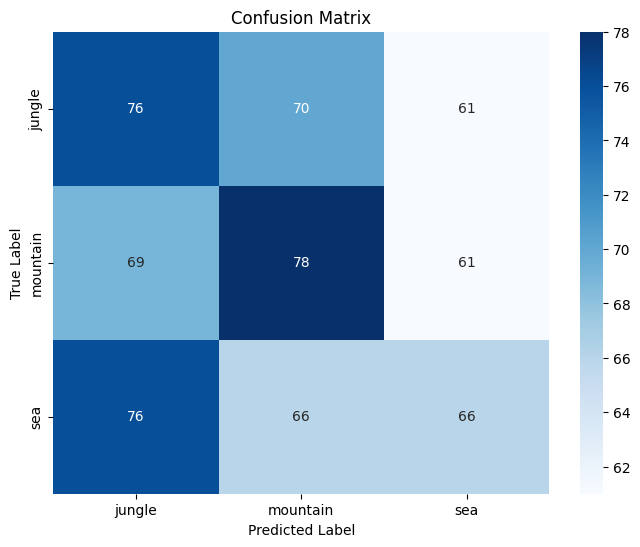

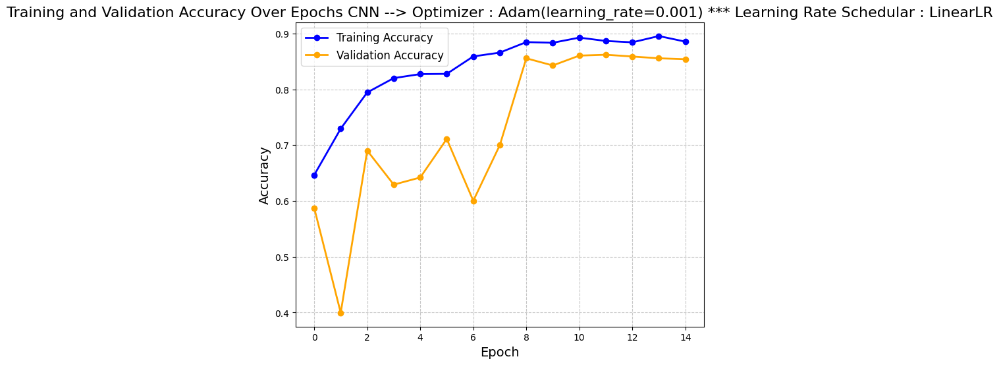

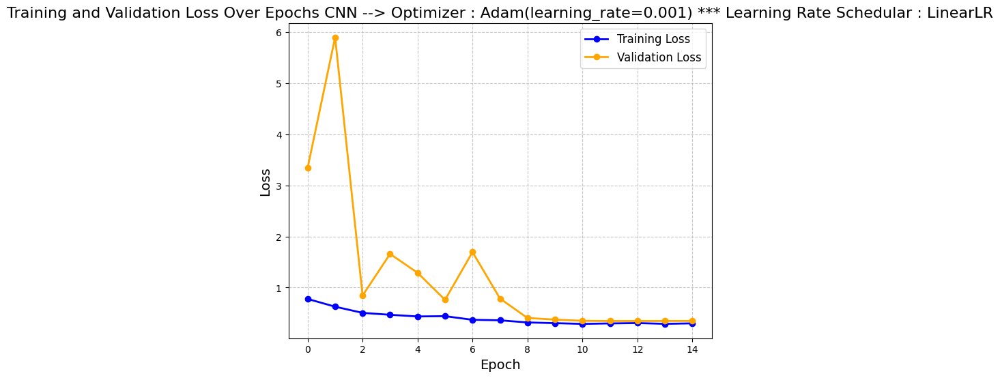

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'Adam(learning_rate=0.001)',
 'Learning Rate Schedular': 'LinearLR',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.8854,
 'Training Loss': 0.3004,
 'Validation Accuracy': 0.8539,
 'Validation Loss': 0.3477,
 'Precision': 0.3532,
 'Recall': 0.3531,
 'F1-Score': 0.3527}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : Adam(learning_rate=0.001) *** Learning Rate Schedular : LinearLR", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "Adam(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "LinearLR"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
#all_results.append(detail_history)
detail_history

##### **ExponentialLR**

   - **Concept:** Exponential learning rate decay involves reducing the learning rate exponentially over time. This can help the model converge faster initially and then fine-tune the parameters more carefully as training progresses.
   - **Implementation:** The learning rate is adjusted at each epoch using an exponential function. The learning rate decreases exponentially over time.



In [ ]:
def exponential_decay(epoch):
    initial_lr = 0.01
    decay_rate = 0.9
    lr = initial_lr * np.exp(-decay_rate * epoch)
    return max(lr, 0.0)

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=6, restore_best_weights=True)
# Define the LearningRateScheduler callback
lr_scheduler = LearningRateScheduler(exponential_decay)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'adam')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
    callbacks=[early_stopping, lr_scheduler]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
Optimizer : Adam(learning_rate=0.001)
Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_96 (Conv2D)          (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_96 (Bat  (None, 112, 112, 64)     256       
 chNormalization)                                                
                                                                 
 re_lu_99 (ReLU)             (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_97 (Conv2D)          (None, 56, 56, 64)        36928

78/78 [==============================] - 14s 165ms/step - loss: 0.9270 - accuracy: 0.6273 - val_loss: 3.6169 - val_accuracy: 0.6083 - lr: 0.0100
Epoch 2/15
78/78 [==============================] - 13s 162ms/step - loss: 0.6280 - accuracy: 0.7138 - val_loss: 0.9284 - val_accuracy: 0.6774 - lr: 0.0041
Epoch 3/15
78/78 [==============================] - 13s 162ms/step - loss: 0.5650 - accuracy: 0.7487 - val_loss: 0.6096 - val_accuracy: 0.7560 - lr: 0.0017
Epoch 4/15
78/78 [==============================] - 13s 162ms/step - loss: 0.5064 - accuracy: 0.7804 - val_loss: 0.5526 - val_accuracy: 0.7769 - lr: 6.7206e-04
Epoch 5/15
78/78 [==============================] - 13s 162ms/step - loss: 0.4724 - accuracy: 0.8080 - val_loss: 0.5251 - val_accuracy: 0.7785 - lr: 2.7324e-04
Epoch 6/15
78/78 [==============================] - 13s 162ms/step - loss: 0.4352 - accuracy: 0.8261 - val_loss: 0.4926 - val_accuracy: 0.8010 - lr: 1.1109e-04
Epoch 7/15
78/78 [==============================] - 13s 162ms/s

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.83326655626297
Validation Accuracy: 0.8105939030647278
Training Loss: 0.4305838346481323
Validation Loss: 0.46667852997779846


20/20 [==============================] - 1s 49ms/step
              precision    recall  f1-score   support

           0       0.30      0.31      0.31       207
           1       0.33      0.33      0.33       208
           2       0.30      0.29      0.30       208

    accuracy                           0.31       623
   macro avg       0.31      0.31      0.31       623
weighted avg       0.31      0.31      0.31       623



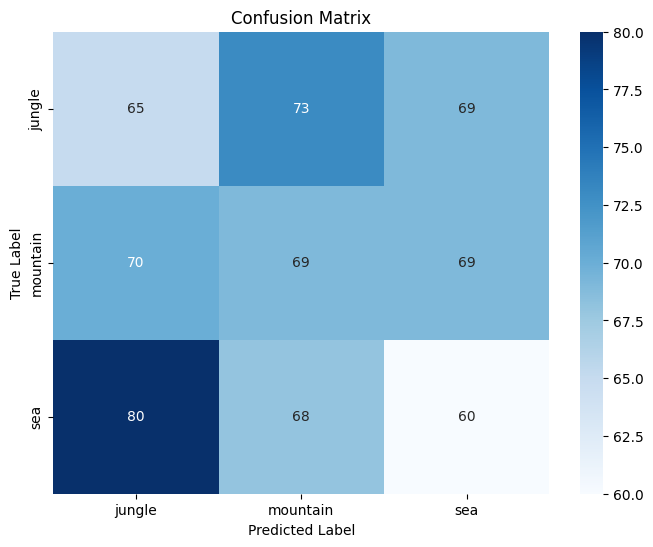

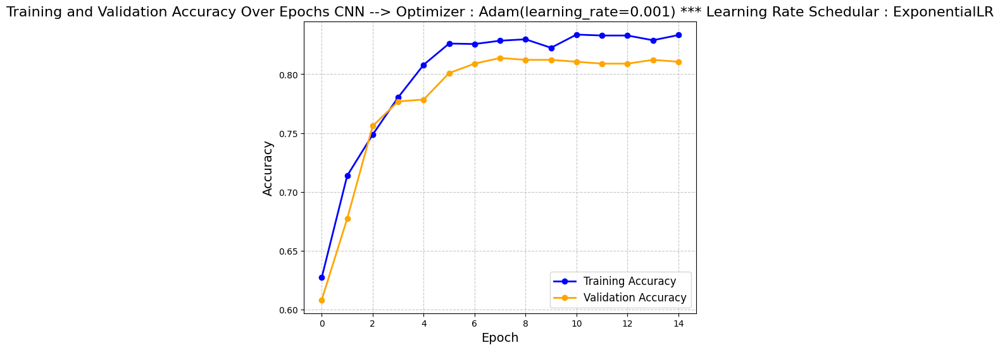

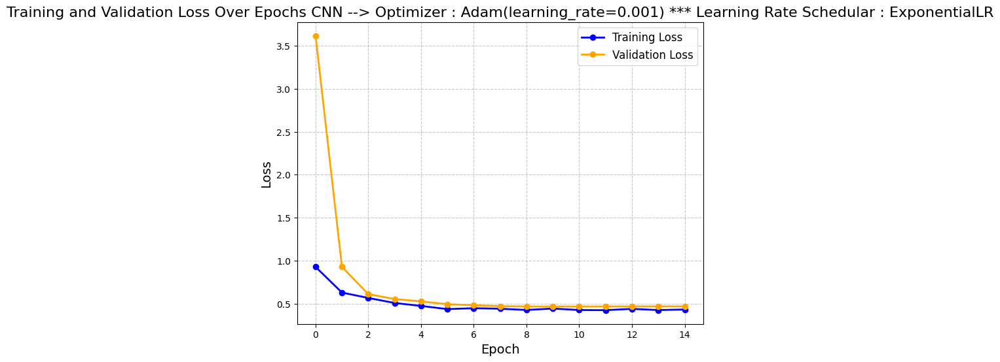

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'Adam(learning_rate=0.001)',
 'Learning Rate Schedular': 'ExponentialLR',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.8333,
 'Training Loss': 0.4306,
 'Validation Accuracy': 0.8106,
 'Validation Loss': 0.4667,
 'Precision': 0.3113,
 'Recall': 0.3114,
 'F1-Score': 0.3113}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : Adam(learning_rate=0.001) *** Learning Rate Schedular : ExponentialLR", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "Adam(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "ExponentialLR"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
#all_results.append(detail_history)
detail_history

##### **CyclicLR**


   - **Concept:** Cyclic learning rate involves cyclically changing the learning rate between two bounds. This approach helps the model escape from local minima by exploring a broader range of learning rates during training. It can be beneficial for finding better solutions in the optimization landscape.
   - **Implementation:** The learning rate is cyclically adjusted between a lower bound and an upper bound. The cycle can be triangular or a more complex pattern.



In [ ]:
class CyclicLR(Callback):
    """This callback implements a cyclical learning rate policy (CLR).
    The method cycles the learning rate between two boundaries with
    some constant frequency.
    # Arguments
        base_lr: initial learning rate which is the
            lower boundary in the cycle.
        max_lr: upper boundary in the cycle. Functionally,
            it defines the cycle amplitude (max_lr - base_lr).
            The lr at any cycle is the sum of base_lr
            and some scaling of the amplitude; therefore
            max_lr may not actually be reached depending on
            scaling function.
        step_size: number of training iterations per
            half cycle. Authors suggest setting step_size
            2-8 x training iterations in epoch.
        mode: one of {triangular, triangular2, exp_range}.
            Default 'triangular'.
            Values correspond to policies detailed above.
            If scale_fn is not None, this argument is ignored.
        gamma: constant in 'exp_range' scaling function:
            gamma**(cycle iterations)
        scale_fn: Custom scaling policy defined by a single
            argument lambda function, where
            0 <= scale_fn(x) <= 1 for all x >= 0.
            mode paramater is ignored
        scale_mode: {'cycle', 'iterations'}.
            Defines whether scale_fn is evaluated on
            cycle number or cycle iterations (training
            iterations since start of cycle). Default is 'cycle'.

    The amplitude of the cycle can be scaled on a per-iteration or
    per-cycle basis.
    This class has three built-in policies, as put forth in the paper.
    "triangular":
        A basic triangular cycle w/ no amplitude scaling.
    "triangular2":
        A basic triangular cycle that scales initial amplitude by half each cycle.
    "exp_range":
        A cycle that scales initial amplitude by gamma**(cycle iterations) at each
        cycle iteration.
    For more detail, please see paper.

    # Example for CIFAR-10 w/ batch size 100:
        ```python
            clr = CyclicLR(base_lr=0.001, max_lr=0.006,
                                step_size=2000., mode='triangular')
            model.fit(X_train, Y_train, callbacks=[clr])
        ```

    Class also supports custom scaling functions:
        ```python
            clr_fn = lambda x: 0.5*(1+np.sin(x*np.pi/2.))
            clr = CyclicLR(base_lr=0.001, max_lr=0.006,
                                step_size=2000., scale_fn=clr_fn,
                                scale_mode='cycle')
            model.fit(X_train, Y_train, callbacks=[clr])
        ```

    # References

      - [Cyclical Learning Rates for Training Neural Networks](
      https://arxiv.org/abs/1506.01186)
    """

    def __init__(
            self,
            base_lr=0.001,
            max_lr=0.006,
            step_size=2000.,
            mode='triangular',
            gamma=1.,
            scale_fn=None,
            scale_mode='cycle'):
        super(CyclicLR, self).__init__()

        if mode not in ['triangular', 'triangular2',
                        'exp_range']:
            raise KeyError("mode must be one of 'triangular', "
                           "'triangular2', or 'exp_range'")
        self.base_lr = base_lr
        self.max_lr = max_lr
        self.step_size = step_size
        self.mode = mode
        self.gamma = gamma
        if scale_fn is None:
            if self.mode == 'triangular':
                self.scale_fn = lambda x: 1.
                self.scale_mode = 'cycle'
            elif self.mode == 'triangular2':
                self.scale_fn = lambda x: 1 / (2.**(x - 1))
                self.scale_mode = 'cycle'
            elif self.mode == 'exp_range':
                self.scale_fn = lambda x: gamma ** x
                self.scale_mode = 'iterations'
        else:
            self.scale_fn = scale_fn
            self.scale_mode = scale_mode
        self.clr_iterations = 0.
        self.trn_iterations = 0.
        self.history = {}

        self._reset()

    def _reset(self, new_base_lr=None, new_max_lr=None,
               new_step_size=None):
        """Resets cycle iterations.
        Optional boundary/step size adjustment.
        """
        if new_base_lr is not None:
            self.base_lr = new_base_lr
        if new_max_lr is not None:
            self.max_lr = new_max_lr
        if new_step_size is not None:
            self.step_size = new_step_size
        self.clr_iterations = 0.

    def clr(self):
        cycle = np.floor(1 + self.clr_iterations / (2 * self.step_size))
        x = np.abs(self.clr_iterations / self.step_size - 2 * cycle + 1)
        if self.scale_mode == 'cycle':
            return self.base_lr + (self.max_lr - self.base_lr) * \
                np.maximum(0, (1 - x)) * self.scale_fn(cycle)
        else:
            return self.base_lr + (self.max_lr - self.base_lr) * \
                np.maximum(0, (1 - x)) * self.scale_fn(self.clr_iterations)

    def on_train_begin(self, logs={}):
        logs = logs or {}

        if self.clr_iterations == 0:
            K.set_value(self.model.optimizer.lr, self.base_lr)
        else:
            K.set_value(self.model.optimizer.lr, self.clr())

    def on_batch_end(self, epoch, logs=None):

        logs = logs or {}
        self.trn_iterations += 1
        self.clr_iterations += 1
        K.set_value(self.model.optimizer.lr, self.clr())

        self.history.setdefault(
            'lr', []).append(
            K.get_value(
                self.model.optimizer.lr))
        self.history.setdefault('iterations', []).append(self.trn_iterations)

        for k, v in logs.items():
            self.history.setdefault(k, []).append(v)

    def on_epoch_end(self, epoch, logs=None):
        logs = logs or {}
        logs['lr'] = K.get_value(self.model.optimizer.lr)

In [ ]:
# Define the LearningRateScheduler callback
clr = CyclicLR()
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=6, restore_best_weights=True)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'sgd')

# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
    callbacks=[early_stopping, clr]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
Optimizer : Adam(learning_rate=0.001)
Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_104 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_104 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_104 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_13 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_105 (Conv2D)         (None, 56, 56, 64)        36928

78/78 [==============================] - 14s 165ms/step - loss: 0.7036 - accuracy: 0.7367 - val_loss: 5.5164 - val_accuracy: 0.3339 - lr: 0.0012
Epoch 2/15
78/78 [==============================] - 13s 162ms/step - loss: 0.4780 - accuracy: 0.8152 - val_loss: 5.3513 - val_accuracy: 0.3339 - lr: 0.0014
Epoch 3/15
78/78 [==============================] - 13s 162ms/step - loss: 0.4443 - accuracy: 0.8289 - val_loss: 3.3489 - val_accuracy: 0.3756 - lr: 0.0016
Epoch 4/15
78/78 [==============================] - 13s 163ms/step - loss: 0.4564 - accuracy: 0.8176 - val_loss: 2.0270 - val_accuracy: 0.5425 - lr: 0.0018
Epoch 5/15
78/78 [==============================] - 13s 163ms/step - loss: 0.4540 - accuracy: 0.8160 - val_loss: 1.4930 - val_accuracy: 0.6709 - lr: 0.0020
Epoch 6/15
78/78 [==============================] - 13s 163ms/step - loss: 0.3927 - accuracy: 0.8557 - val_loss: 0.9619 - val_accuracy: 0.7400 - lr: 0.0022
Epoch 7/15
78/78 [==============================] - 13s 162ms/step - loss: 

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.894188404083252
Validation Accuracy: 0.7528089880943298
Training Loss: 0.297313928604126
Validation Loss: 0.9732149839401245


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.31      0.21      0.25       207
           1       0.37      0.62      0.46       208
           2       0.34      0.22      0.27       208

    accuracy                           0.35       623
   macro avg       0.34      0.35      0.33       623
weighted avg       0.34      0.35      0.33       623



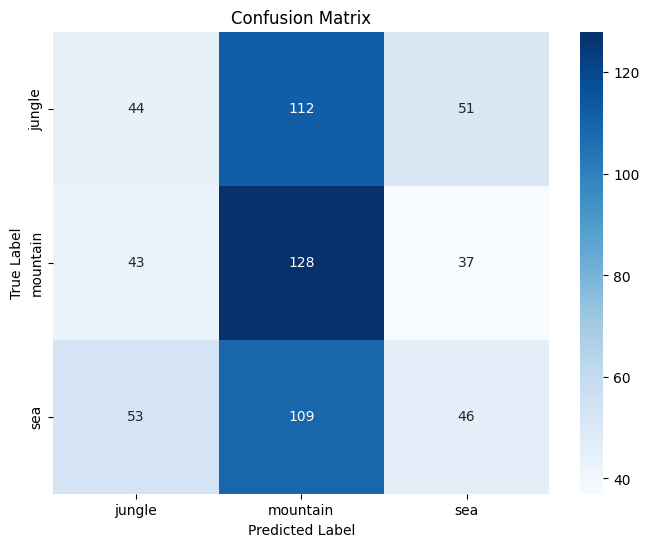

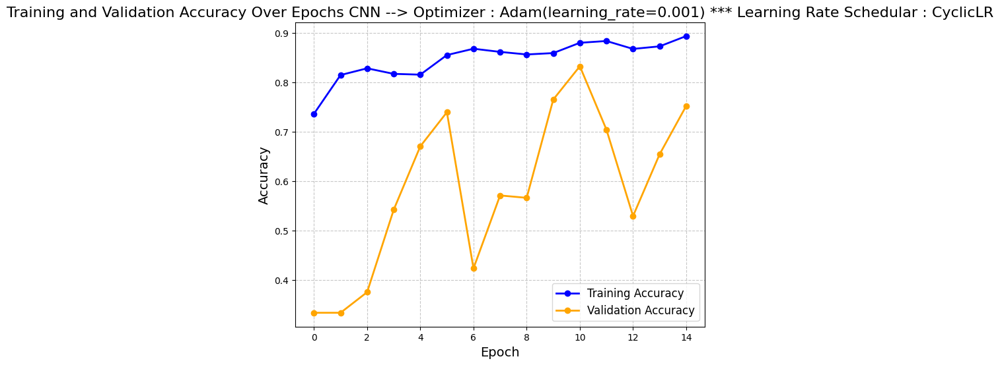

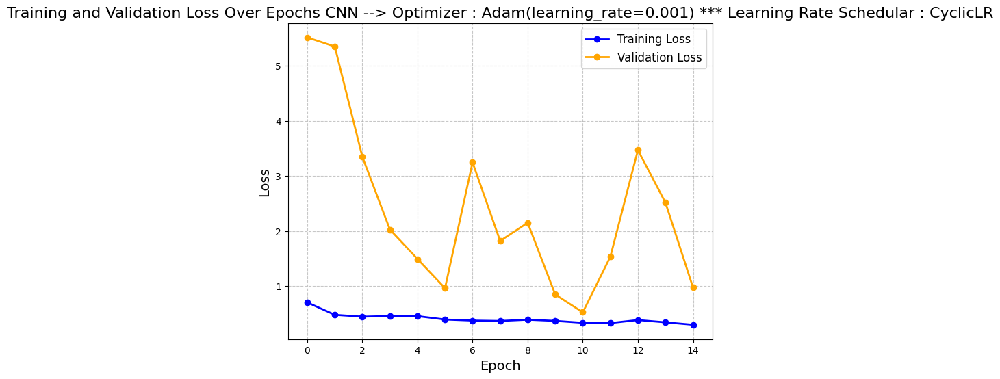

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'Adam(learning_rate=0.001)',
 'Learning Rate Schedular': 'CyclicLR',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.8942,
 'Training Loss': 0.2973,
 'Validation Accuracy': 0.7528,
 'Validation Loss': 0.9732,
 'Precision': 0.3415,
 'Recall': 0.3499,
 'F1-Score': 0.3275}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : Adam(learning_rate=0.001) *** Learning Rate Schedular : CyclicLR", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "Adam(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "CyclicLR"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
#all_results.append(detail_history)
detail_history

##### **StepLR**


   - **Concept:** Step learning rate decay involves reducing the learning rate at predefined steps during training. This is useful for gradually decreasing the learning rate as the model converges, providing finer adjustments in the later stages of training.
   - **Implementation:** The learning rate is decreased by a factor (gamma) at predefined steps or after a certain number of epochs.

In [ ]:
def step_decay(epoch):
    initial_lr = 0.01
    drop = 0.5
    epochs_drop = 10
    lr = initial_lr * (drop ** (np.floor(1 + epoch) / epochs_drop))
    return max(lr, 0.0)

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=6, restore_best_weights=True)
# Define the LearningRateScheduler callback
lr_scheduler = LearningRateScheduler(step_decay)

#make a cnn model
model = Make_Model('categorical', 'cnn', 'adam')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
    callbacks=[early_stopping, lr_scheduler]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
Optimizer : Adam(learning_rate=0.001)
Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_112 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_112 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_109 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_14 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_113 (Conv2D)         (None, 56, 56, 64)        36928

78/78 [==============================] - 14s 166ms/step - loss: 0.8762 - accuracy: 0.6389 - val_loss: 4.3636 - val_accuracy: 0.5297 - lr: 0.0093
Epoch 2/15
78/78 [==============================] - 13s 161ms/step - loss: 0.6302 - accuracy: 0.7158 - val_loss: 2.7057 - val_accuracy: 0.4189 - lr: 0.0087
Epoch 3/15
78/78 [==============================] - 13s 161ms/step - loss: 0.5411 - accuracy: 0.7715 - val_loss: 1.8964 - val_accuracy: 0.5233 - lr: 0.0081
Epoch 4/15
78/78 [==============================] - 13s 161ms/step - loss: 0.5119 - accuracy: 0.7992 - val_loss: 1.8312 - val_accuracy: 0.6661 - lr: 0.0076
Epoch 5/15
78/78 [==============================] - 13s 161ms/step - loss: 0.4773 - accuracy: 0.8196 - val_loss: 1.0378 - val_accuracy: 0.6388 - lr: 0.0071
Epoch 6/15
78/78 [==============================] - 13s 161ms/step - loss: 0.4234 - accuracy: 0.8377 - val_loss: 0.5928 - val_accuracy: 0.7769 - lr: 0.0066
Epoch 7/15
78/78 [==============================] - 13s 161ms/step - loss: 

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.8853707313537598
Validation Accuracy: 0.7303370833396912
Training Loss: 0.29916778206825256
Validation Loss: 0.7707439661026001


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.34      0.31      0.32       207
           1       0.34      0.56      0.42       208
           2       0.35      0.16      0.22       208

    accuracy                           0.34       623
   macro avg       0.35      0.34      0.32       623
weighted avg       0.35      0.34      0.32       623



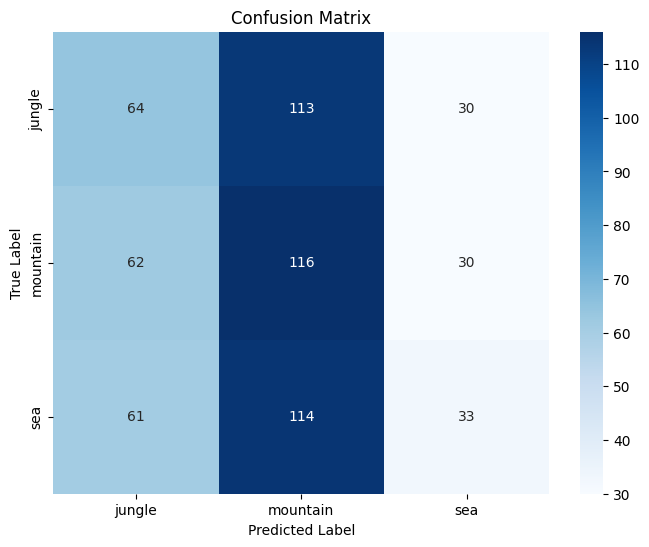

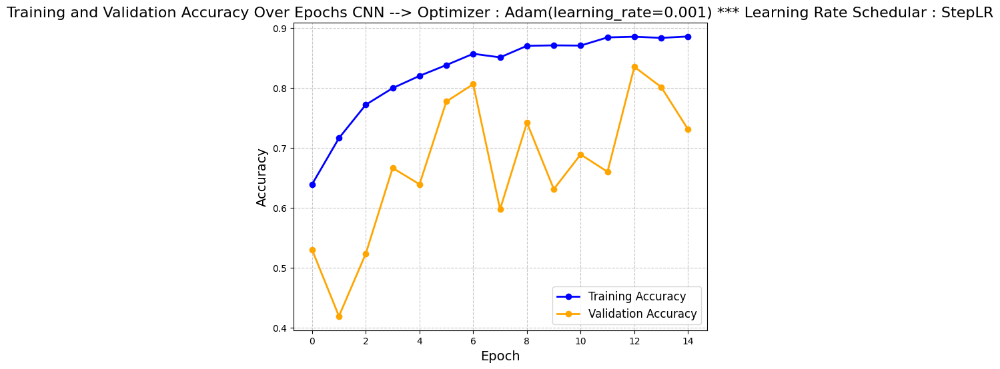

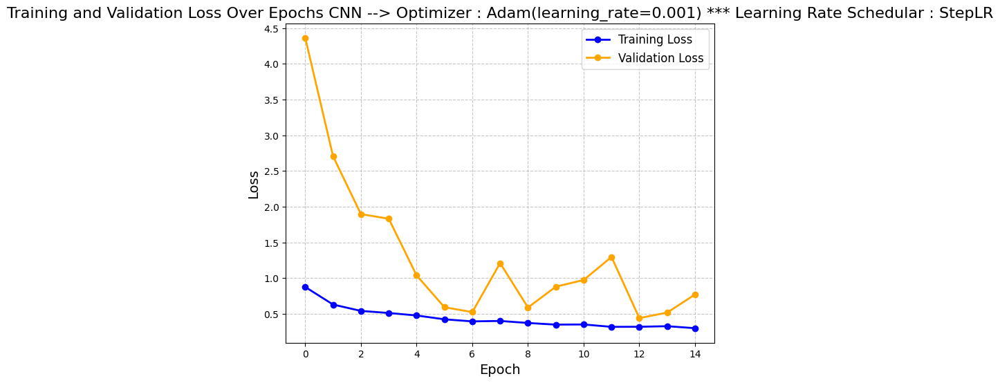

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'Adam(learning_rate=0.001)',
 'Learning Rate Schedular': 'StepLR',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.8854,
 'Training Loss': 0.2992,
 'Validation Accuracy': 0.7303,
 'Validation Loss': 0.7707,
 'Precision': 0.3451,
 'Recall': 0.3419,
 'F1-Score': 0.3217}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : Adam(learning_rate=0.001) *** Learning Rate Schedular : StepLR", "categorical")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "Adam(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "StepLR"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
#all_results.append(detail_history)
detail_history

### **Best Model implementation (From my results)**

In this part, I based on the results obtained in the above models using data augmentation techniques and optimizers and Learning Rate Schedular techniques (which one was better at improving the performance of my model)
I came and put a total of these on all three of models (CNN from scratch , ResNet and MobileNet)
with these methods then analyze the results.

**My best Optimizer :** `Adam`

**Best Learning Rate Scheduler :** `LinearLR`

**Best Data Augmentation Techniques :** `Gaussian Blur` and `RandomCrop`

In data augmentation part my model didn't improve in accuracy and decrease in loss but `Gaussian Blur` and `RandomCrop` a little better than other methods.
**(But in my opinion models without any augmentation were better)**

### **Conclusion and Final Result**

Now in this part I will Train again 3 models - with 20 epochs (`Base CNN` , `ResNet` and `MobileNet`) with :
- `Adam` `Optimizer`  
- All `Data Augmentation` techniques make my model performance worse (with a specific optimizer) so I will not use any of them.
- `LinearLR` as the best `Learning Rate Schedular`.

then analyze the final result and then save my model for my best model for testing in presentation day.

At the I make a `csv` file for for result of all models that trained in my notebook.

Found 2495 images belonging to 3 classes.
Found 623 images belonging to 3 classes.


categorical


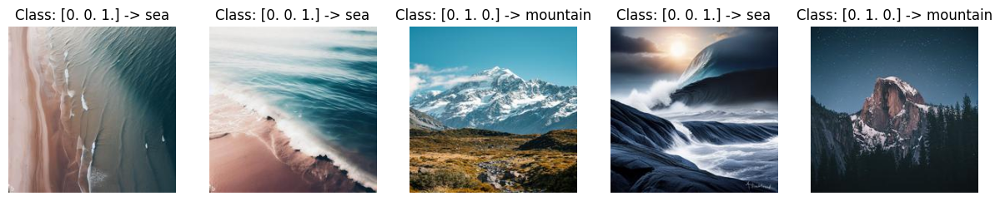

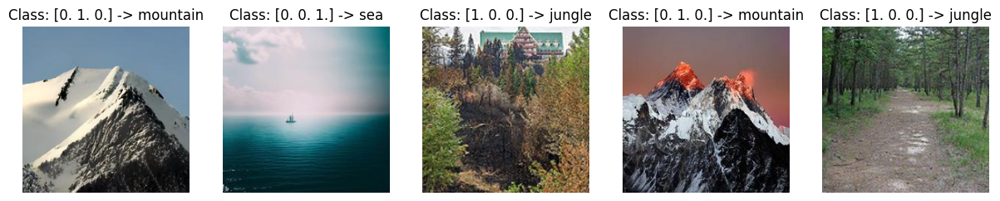

In [ ]:
train_generator, validation_generator = Make_Dataset(dataset_path, batch_size, random_seed, 'categorical', data_augmentation = 'default')
display_sample_images(train_generator)
display_sample_images(validation_generator)

#### **Best CNN from Scratch**

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint

checkpoint = ModelCheckpoint('./saved_models/best_cnn_categorical.h5',
                             save_best_only=True,
                             monitor='val_accuracy',
                             mode='max',
                             verbose=1)

# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
# Define the LearningRateScheduler callback
lr_scheduler = LearningRateScheduler(linear_decay)

#make a cnn model
best_cnn_model_categorical = Make_Model('categorical', 'cnn', 'adam')
# Train the model
best_cnn_model_categorical_history = best_cnn_model_categorical.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
    callbacks=[early_stopping, lr_scheduler, checkpoint]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: CNN from Scratch
Optimizer : Adam(learning_rate=0.001)
Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_120 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_120 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_114 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_15 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_121 (Conv2D)         (None, 56, 56, 64)        36928

                                                                 
 batch_normalization_123 (Ba  (None, 56, 56, 128)      512       
 tchNormalization)                                               
                                                                 
 conv2d_124 (Conv2D)         (None, 56, 56, 128)       147584    
                                                                 
 batch_normalization_124 (Ba  (None, 56, 56, 128)      512       
 tchNormalization)                                               
                                                                 
 re_lu_116 (ReLU)            (None, 56, 56, 128)       0         
                                                                 
 conv2d_125 (Conv2D)         (None, 14, 14, 256)       295168    
                                                                 
 batch_normalization_125 (Ba  (None, 14, 14, 256)      1024      
 tchNormalization)                                               
          

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.8853707313537598
Validation Accuracy: 0.8603531122207642
Training Loss: 0.2952713966369629
Validation Loss: 0.33904653787612915


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.34      0.34      0.34       207
           1       0.35      0.36      0.35       208
           2       0.31      0.30      0.31       208

    accuracy                           0.33       623
   macro avg       0.33      0.33      0.33       623
weighted avg       0.33      0.33      0.33       623



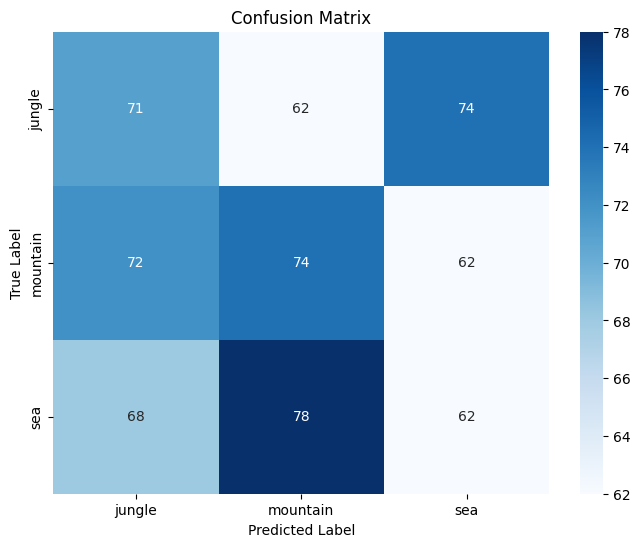

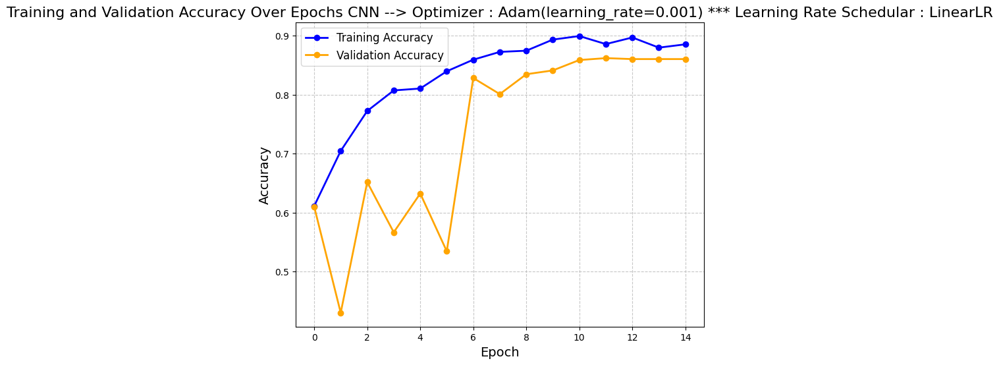

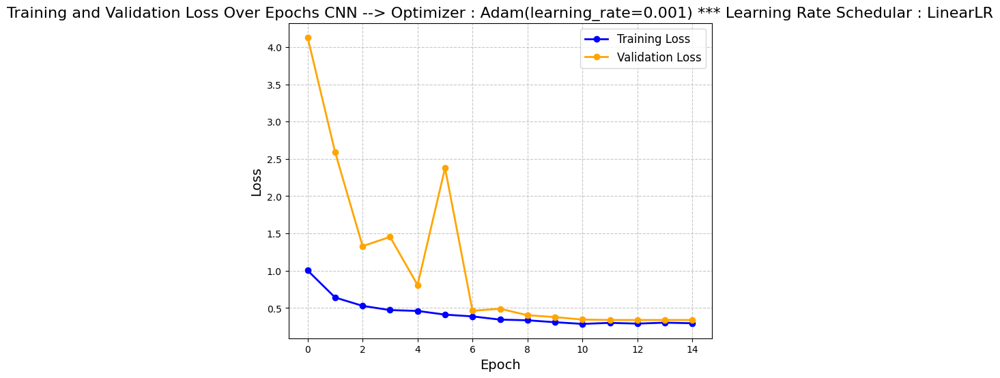

{'Model Name': 'Best - CNN from Scratch',
 'Optimizer': 'Adam(learning_rate=0.001)',
 'Learning Rate Schedular': 'LinearLR',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.8854,
 'Training Loss': 0.2953,
 'Validation Accuracy': 0.8604,
 'Validation Loss': 0.339,
 'Precision': 0.3318,
 'Recall': 0.3323,
 'F1-Score': 0.3319}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(best_cnn_model_categorical_history, best_cnn_model_categorical, validation_generator, " CNN --> Optimizer : Adam(learning_rate=0.001) *** Learning Rate Schedular : LinearLR", "categorical")
detail_history = dict()
detail_history["Model Name"] = "Best - CNN from Scratch"
detail_history["Optimizer"] = "Adam(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "LinearLR"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

#### **Best ResNet-152 model**

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint

checkpoint = ModelCheckpoint('./saved_models/best_resnet_categorical.h5',
                             save_best_only=True,
                             monitor='val_accuracy',
                             mode='max',
                             verbose=1)
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
# Define the LearningRateScheduler callback
lr_scheduler = LearningRateScheduler(linear_decay)

#make a cnn model
best_resnet_model_categorical = Make_Model('categorical', 'resnet', 'adam')
# Train the model
best_resnet_model_categorical_history = best_resnet_model_categorical.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
    callbacks=[early_stopping, lr_scheduler, checkpoint]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: ResNet-152
Optimizer : Adam(learning_rate=0.001)


Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet152 (Functional)      (None, 7, 7, 2048)        58370944  
                                                                 
 global_average_pooling2d_18  (None, 2048)             0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_18 (Dense)            (None, 3)                 6147      
                                                                 
Total params: 58,377,091
Trainable params: 6,147
Non-trainable params: 58,370,944
_________________________________________________________________
Epoch 1/15
78/78 [==============================] - ETA: 0s - loss: 1.0410 - accuracy: 0.4806
Epoch 1: val_accuracy improved from -inf to 0.58106, saving model to ./saved_models\best_resnet_categorical.h5
78/78 [=======================

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.7422845959663391
Validation Accuracy: 0.7287319302558899
Training Loss: 0.664890706539154
Validation Loss: 0.690193772315979


20/20 [==============================] - 11s 447ms/step
              precision    recall  f1-score   support

           0       0.33      0.34      0.34       207
           1       0.40      0.25      0.31       208
           2       0.31      0.42      0.36       208

    accuracy                           0.34       623
   macro avg       0.35      0.34      0.33       623
weighted avg       0.35      0.34      0.33       623



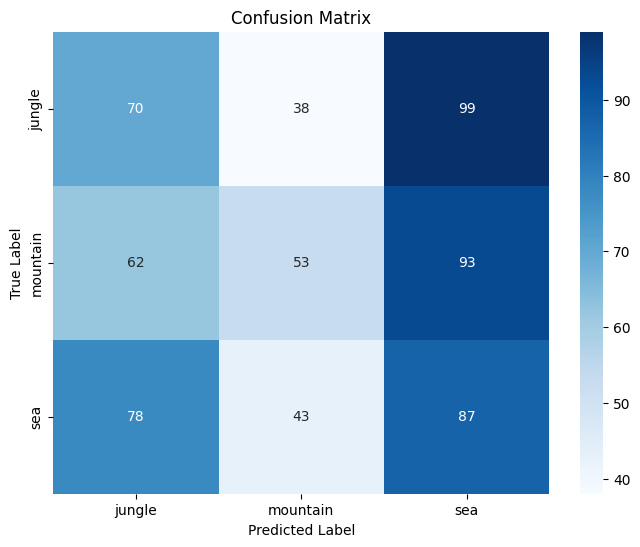

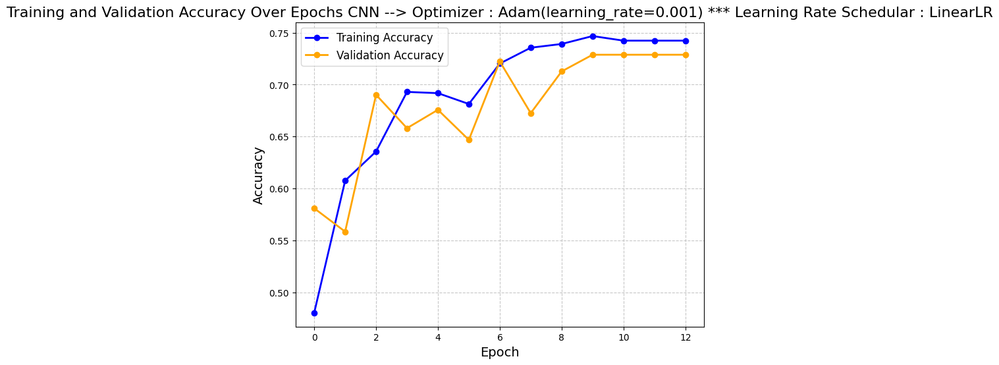

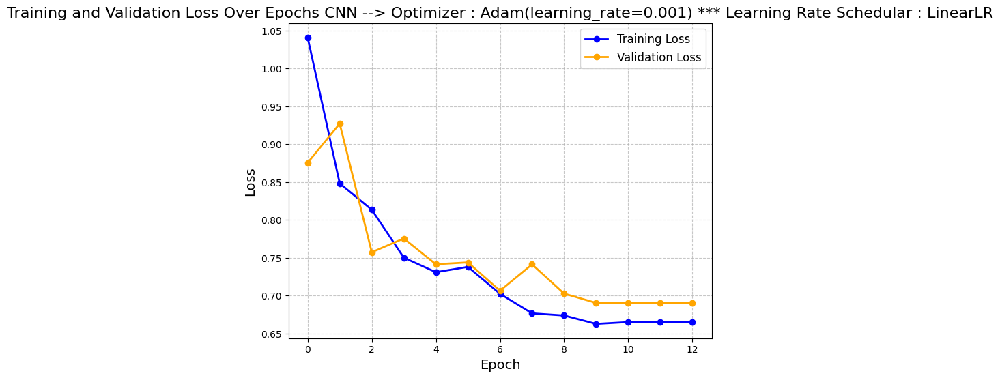

{'Model Name': 'Best - ResNet',
 'Optimizer': 'Adam(learning_rate=0.001)',
 'Learning Rate Schedular': 'LinearLR',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.7423,
 'Training Loss': 0.6649,
 'Validation Accuracy': 0.7287,
 'Validation Loss': 0.6902,
 'Precision': 0.3469,
 'Recall': 0.3371,
 'F1-Score': 0.3343}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(best_resnet_model_categorical_history, best_resnet_model_categorical, validation_generator, " CNN --> Optimizer : Adam(learning_rate=0.001) *** Learning Rate Schedular : LinearLR", "categorical")
detail_history = dict()
detail_history["Model Name"] = "Best - ResNet"
detail_history["Optimizer"] = "Adam(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "LinearLR"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

#### **Best MobileNet model**

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint

checkpoint = ModelCheckpoint('./saved_models/best_mobilenet_categorical.h5',
                             save_best_only=True,
                             monitor='val_accuracy',
                             mode='max',
                             verbose=1)
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
# Define the LearningRateScheduler callback
lr_scheduler = LearningRateScheduler(linear_decay)

#make a cnn model
best_mobilenet_model_categorical = Make_Model('categorical', 'mobilenet', 'adam')
# Train the model
best_mobilenet_model_categorical_history = best_mobilenet_model_categorical.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
    callbacks=[early_stopping, lr_scheduler, checkpoint]
)

Task : Multi Class Classification (Jungle, Mountain, Sea)
Model Type: MobileNetV3
Optimizer : Adam(learning_rate=0.001)
Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 MobilenetV3large (Functiona  (None, 7, 7, 960)        2996352   
 l)                                                              
                                                                 
 global_average_pooling2d_19  (None, 960)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_19 (Dense)            (None, 3)                 2883      
                                                                 
Total params: 2,999,235
Trainable params: 2,883
Non-trainable params: 2,996,352
_________________________________________________________________
Epoch 1/15
78/78 [==============================] -

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.703406810760498
Validation Accuracy: 0.7207062840461731
Training Loss: 0.7193968892097473
Validation Loss: 0.734612762928009


20/20 [==============================] - 2s 59ms/step
              precision    recall  f1-score   support

           0       0.35      0.34      0.34       207
           1       0.37      0.29      0.33       208
           2       0.33      0.40      0.36       208

    accuracy                           0.35       623
   macro avg       0.35      0.35      0.34       623
weighted avg       0.35      0.35      0.34       623



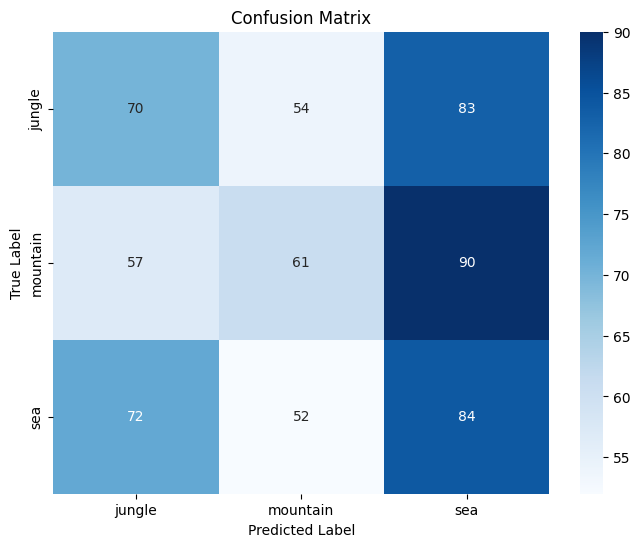

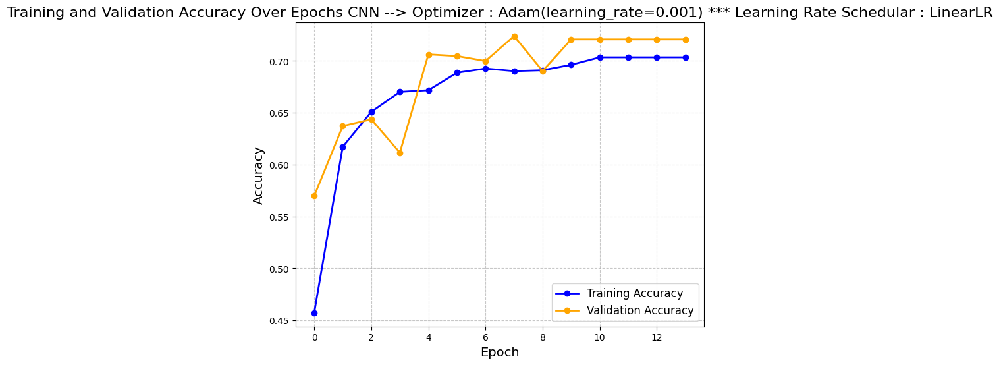

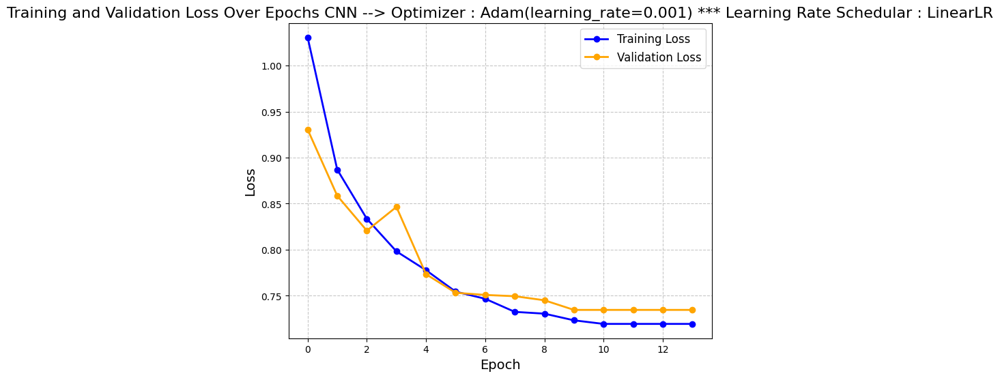

{'Model Name': 'Best - MobileNet',
 'Optimizer': 'Adam(learning_rate=0.001)',
 'Learning Rate Schedular': 'LinearLR',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.7034,
 'Training Loss': 0.7194,
 'Validation Accuracy': 0.7207,
 'Validation Loss': 0.7346,
 'Precision': 0.348,
 'Recall': 0.3451,
 'F1-Score': 0.3438}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(best_mobilenet_model_categorical_history, best_mobilenet_model_categorical, validation_generator, " CNN --> Optimizer : Adam(learning_rate=0.001) *** Learning Rate Schedular : LinearLR", "categorical")
detail_history = dict()
detail_history["Model Name"] = "Best - MobileNet"
detail_history["Optimizer"] = "Adam(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "LinearLR"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_categorical.append(detail_history)
detail_history

**Save Results**

In [ ]:
import pandas as pd

multi_class_results = pd.DataFrame(all_results_categorical)
multi_class_results

,Model Name,Optimizer,Learning Rate Schedular,Data Augmentation,Training Accuracy,Training Loss,Validation Accuracy,Validation Loss,Precision,Recall,F1-Score
0,CNN from Scratch,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Nothing,0.9295,0.1999,0.7400,0.7785,0.2912,0.3050,0.2810
1,ResNet-152,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Nothing,0.6453,0.8098,0.6356,0.8521,0.3447,0.3451,0.3428
2,MobileNetV3,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Nothing,0.5735,0.9460,0.6260,0.9266,0.3305,0.3226,0.3164
3,CNN from Scratch,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Random Rotation,0.8802,0.3192,0.8058,0.5137,0.3280,0.3274,0.3270
4,CNN from Scratch,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Gaussian Blur,0.9074,0.2529,0.8684,0.3615,0.3317,0.3323,0.3309
5,CNN from Scratch,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Grayscale,0.8569,0.3771,0.5104,1.8985,0.2148,0.3258,0.2496
6,CNN from Scratch,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Random Flip,0.8978,0.2809,0.7833,0.5527,0.3169,0.3162,0.3038
7,CNN from Scratch,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,ColorJitter,0.8441,0.3836,0.3708,1.9998,0.2346,0.3419,0.2431
8,CNN from Scratch,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,MixUp,0.6719,0.7294,0.3339,1.0948,0.1115,0.3339,0.1671
9,CNN from Scratch,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,RandomCrop,0.8585,0.3790,0.6292,0.9523,0.3255,0.3258,0.3184


In [ ]:
# Save to CSV with index
multi_class_results.to_csv('multi_class_results.csv', index=False)

<hr>
<hr>

## **Task 2**
 Identify whether the image is real or fake.



### **Initialization**

In [ ]:
batch_size = 32
random_seed = 42
dataset_path_realness = './real_or_fake'
all_results_binary = list()

### **Base Models**

In this part my models don't have any of `Optimizers` & `Learning Rate Schedular` & `Data Augmentation`

#### **`CNN` Model from Scratch**

Found 2495 images belonging to 2 classes.
Found 623 images belonging to 2 classes.
binary


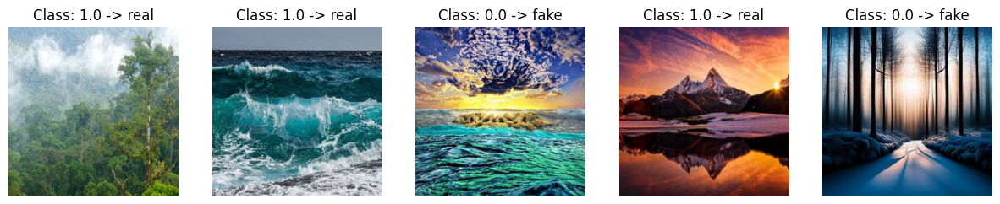

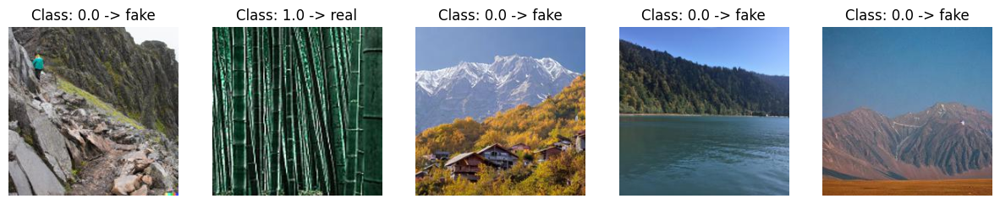

In [ ]:
#make basic dataset
# 0 -> fake , 1 -> real
train_generator, validation_generator = Make_Dataset(dataset_path_realness, batch_size, random_seed, 'binary', data_augmentation = 'default')
display_sample_images(train_generator, task = 'binary')
display_sample_images(validation_generator, task = 'binary')

In [ ]:
# Get the class indices
class_indices = train_generator.class_indices

# Print the number of data points in each class for training set
for class_name, class_index in class_indices.items():
    class_count = sum(train_generator.classes == class_index)
    print(f"Training - Class {class_name}: {class_count} samples")

# Get the class indices for validation set
class_indices_val = validation_generator.class_indices

# Print the number of data points in each class for validation set
for class_name, class_index in class_indices_val.items():
    class_count_val = sum(validation_generator.classes == class_index)
    print(f"Validation - Class {class_name}: {class_count_val} samples")

Training - Class fake: 1248 samples
Training - Class real: 1247 samples
Validation - Class fake: 312 samples
Validation - Class real: 311 samples


In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
#lr_scheduler = LearningRateScheduler(linear_decay)

#make a cnn model
model = Make_Model('binary', 'cnn', 'sgd')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_128 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_128 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_158 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_16 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_129 (Conv2D)         (None, 56, 56, 64)        36928   

78/78 [==============================] - 14s 165ms/step - loss: 0.6247 - accuracy: 0.6397 - val_loss: 0.7015 - val_accuracy: 0.5008
Epoch 2/15
78/78 [==============================] - 13s 161ms/step - loss: 0.5842 - accuracy: 0.6882 - val_loss: 0.7458 - val_accuracy: 0.5008
Epoch 3/15
78/78 [==============================] - 13s 162ms/step - loss: 0.5382 - accuracy: 0.7383 - val_loss: 0.9798 - val_accuracy: 0.5008
Epoch 4/15
78/78 [==============================] - 13s 162ms/step - loss: 0.5278 - accuracy: 0.7391 - val_loss: 1.3828 - val_accuracy: 0.5008
Epoch 5/15
78/78 [==============================] - 13s 162ms/step - loss: 0.4993 - accuracy: 0.7643 - val_loss: 1.5563 - val_accuracy: 0.5008
Epoch 6/15
78/78 [==============================] - 13s 162ms/step - loss: 0.4742 - accuracy: 0.7727 - val_loss: 1.2820 - val_accuracy: 0.5040
Epoch 7/15
78/78 [==============================] - 13s 162ms/step - loss: 0.4609 - accuracy: 0.7816 - val_loss: 0.8693 - val_accuracy: 0.5297
Epoch 8/15

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.9262524843215942
Validation Accuracy: 0.7431781888008118
Training Loss: 0.23204632103443146
Validation Loss: 0.590007483959198


20/20 [==============================] - 1s 47ms/step
              precision    recall  f1-score   support

           0       0.51      0.46      0.48       312
           1       0.51      0.56      0.53       311

    accuracy                           0.51       623
   macro avg       0.51      0.51      0.51       623
weighted avg       0.51      0.51      0.51       623



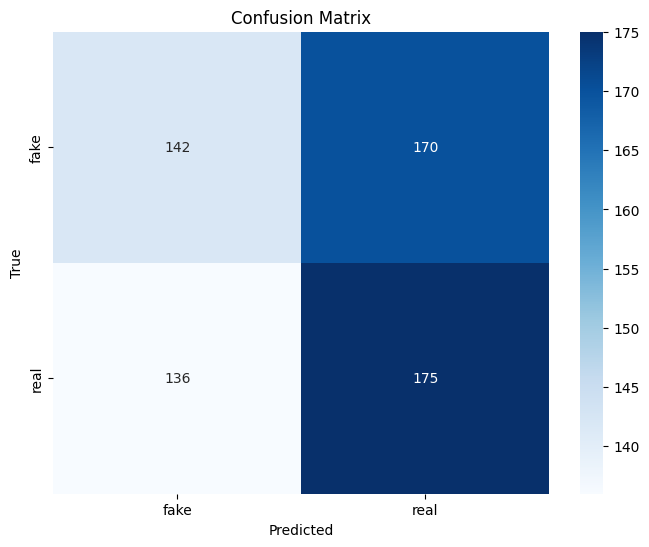

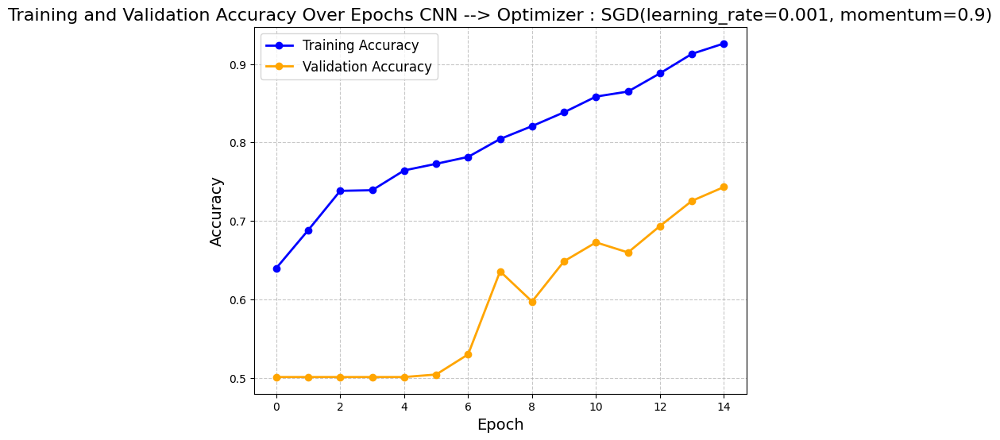

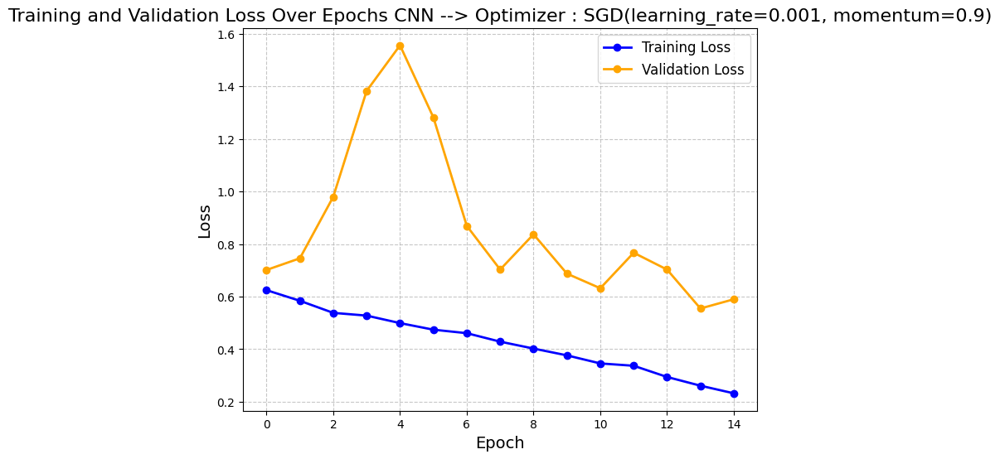

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.9263,
 'Training Loss': 0.232,
 'Validation Accuracy': 0.7432,
 'Validation Loss': 0.59,
 'Precision': 0.509,
 'Recall': 0.5088,
 'F1-Score': 0.5074}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : SGD(learning_rate=0.001, momentum=0.9)", "binary")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

#### **ResNet-152**

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('binary', 'resnet', 'sgd')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
)

Task : Binary Classification (Real, Fake)
Model Type: ResNet-152
Optimizer : SGD(learning_rate=0.001, momentum=0.9)


Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet152 (Functional)      (None, 7, 7, 2048)        58370944  
                                                                 
 global_average_pooling2d_21  (None, 2048)             0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_21 (Dense)            (None, 1)                 2049      
                                                                 
Total params: 58,372,993
Trainable params: 2,049
Non-trainable params: 58,370,944
_________________________________________________________________
Epoch 1/15
78/78 [==============================] - 53s 589ms/step - loss: 0.6955 - accuracy: 0.5126 - val_loss: 0.6893 - val_accuracy: 0.5008
Epoch 2/15
78/78 [==============================] - 43s 550ms/step - loss: 0.7052 - accuracy

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.5771543383598328
Validation Accuracy: 0.5601926445960999
Training Loss: 0.6794179081916809
Validation Loss: 0.6778247356414795


20/20 [==============================] - 12s 452ms/step
              precision    recall  f1-score   support

           0       0.49      0.47      0.48       312
           1       0.49      0.50      0.50       311

    accuracy                           0.49       623
   macro avg       0.49      0.49      0.49       623
weighted avg       0.49      0.49      0.49       623



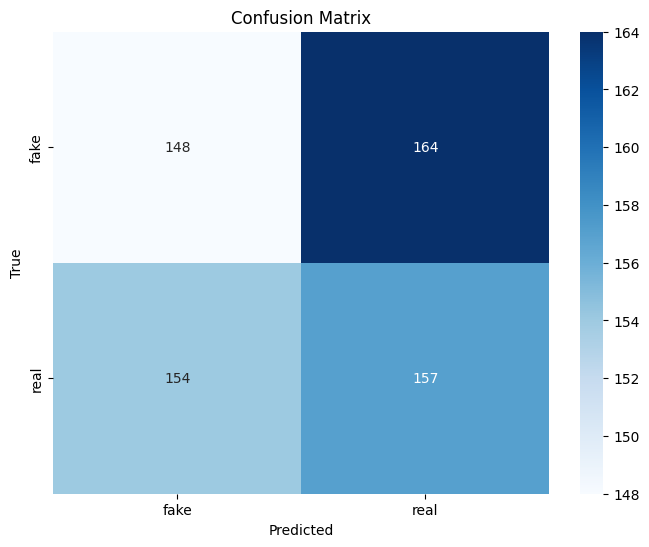

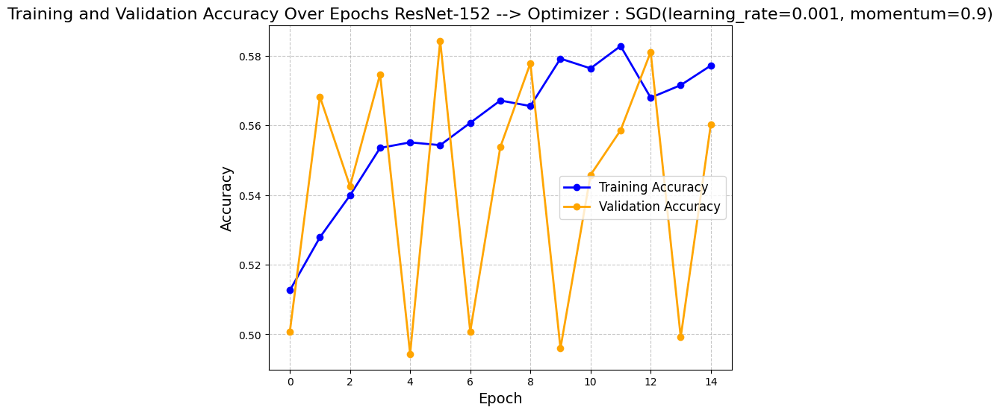

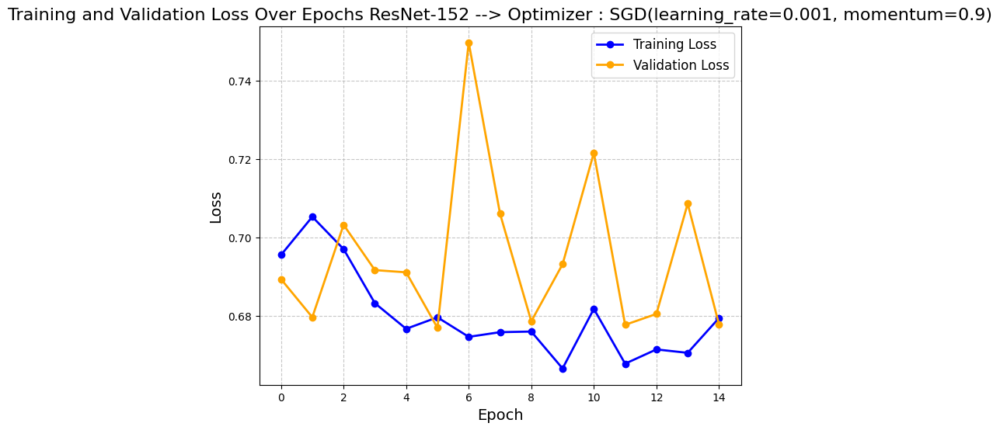

{'Model Name': 'ResNet-152',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.5772,
 'Training Loss': 0.6794,
 'Validation Accuracy': 0.5602,
 'Validation Loss': 0.6778,
 'Precision': 0.4896,
 'Recall': 0.4896,
 'F1-Score': 0.4894}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " ResNet-152 --> Optimizer : SGD(learning_rate=0.001, momentum=0.9)", "binary")
detail_history = dict()
detail_history["Model Name"] = "ResNet-152"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

#### **MobileNetV3**

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('binary', 'mobilenet', 'sgd')
# Train the model
history = model.fit(
    train_generator,
    epochs=20,
    validation_data=validation_generator,
)

Task : Binary Classification (Real, Fake)
Model Type: MobileNetV3
Optimizer : SGD(learning_rate=0.001, momentum=0.9)


Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 MobilenetV3large (Functiona  (None, 7, 7, 960)        2996352   
 l)                                                              
                                                                 
 global_average_pooling2d_22  (None, 960)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_22 (Dense)            (None, 1)                 961       
                                                                 
Total params: 2,997,313
Trainable params: 961
Non-trainable params: 2,996,352
_________________________________________________________________
Epoch 1/20
78/78 [==============================] - 11s 92ms/step - loss: 0.6959 - accuracy: 0.5018 - val_loss: 0.7030 - val_accuracy: 0.5008
Epoch 2/20
78/78 [=============

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.5306613445281982
Validation Accuracy: 0.5730336904525757
Training Loss: 0.6866662502288818
Validation Loss: 0.6853783130645752


20/20 [==============================] - 2s 59ms/step
              precision    recall  f1-score   support

           0       0.51      0.52      0.51       312
           1       0.51      0.51      0.51       311

    accuracy                           0.51       623
   macro avg       0.51      0.51      0.51       623
weighted avg       0.51      0.51      0.51       623



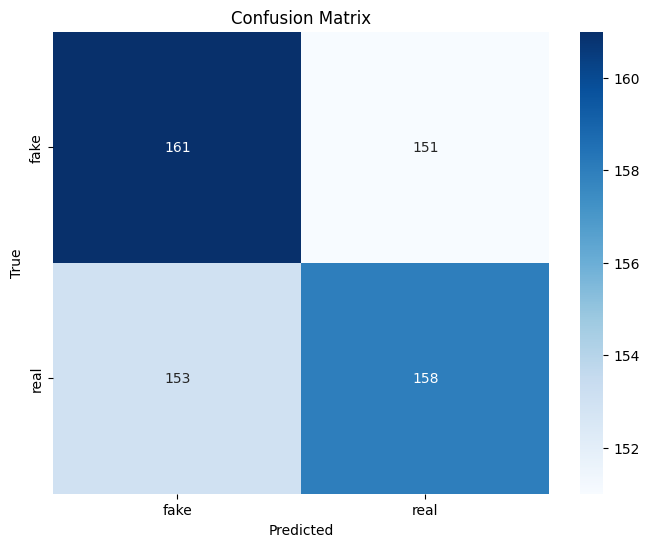

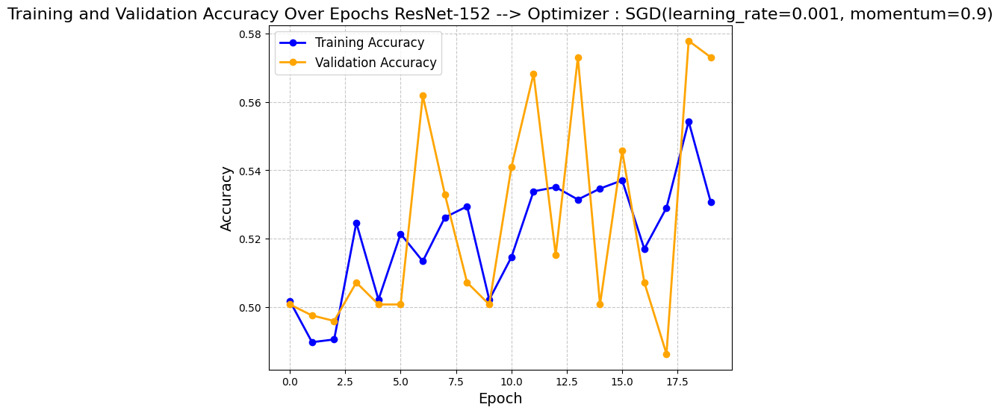

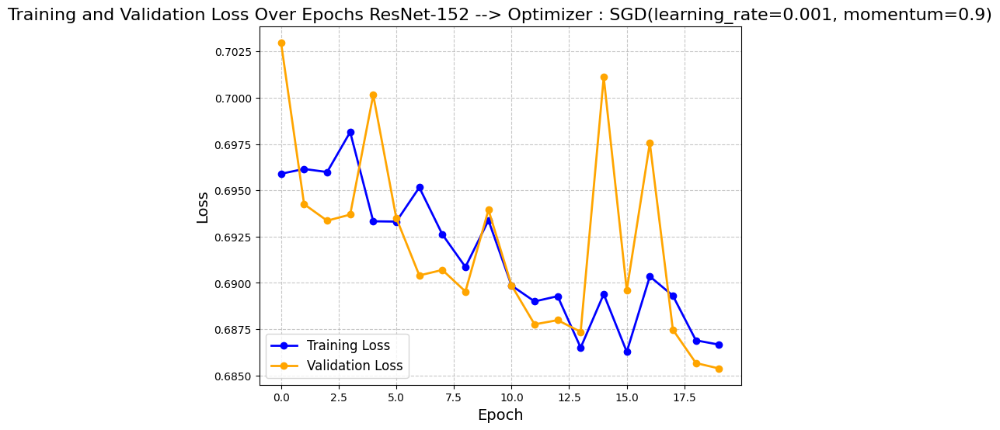

{'Model Name': 'MobileNet',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.5307,
 'Training Loss': 0.6867,
 'Validation Accuracy': 0.573,
 'Validation Loss': 0.6854,
 'Precision': 0.512,
 'Recall': 0.512,
 'F1-Score': 0.512}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " ResNet-152 --> Optimizer : SGD(learning_rate=0.001, momentum=0.9)", "binary")
detail_history = dict()
detail_history["Model Name"] = "MobileNet"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

### **Data Augmentation**

#### **`CNN` Model From Scratch (with Data Augmentation)**



##### **Random Rotation**

Found 2495 images belonging to 2 classes.
Found 623 images belonging to 2 classes.


binary


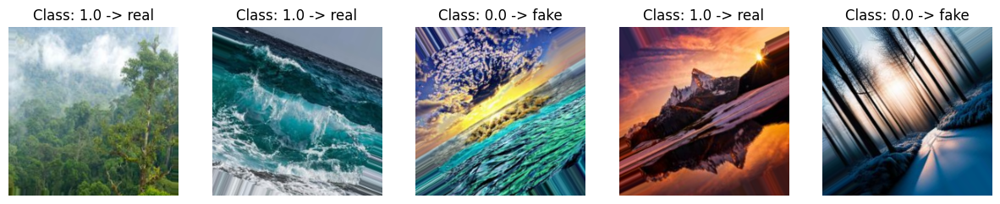

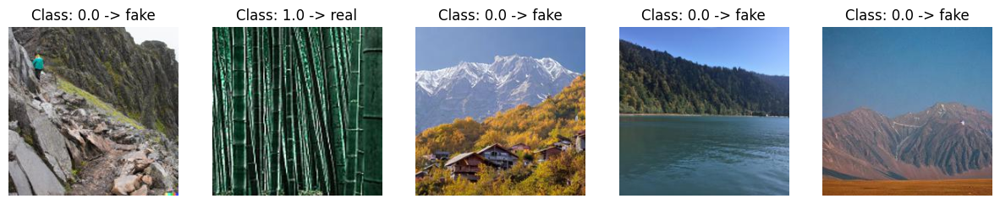

In [ ]:
#make basic dataset
# 0 -> fake , 1 -> real
train_generator, validation_generator = Make_Dataset(dataset_path_realness, batch_size, random_seed, 'binary', data_augmentation = 'RandomRotation')
display_sample_images(train_generator, task = 'binary')
display_sample_images(validation_generator, task = 'binary')

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
#lr_scheduler = LearningRateScheduler(linear_decay)

#make a cnn model
model = Make_Model('binary', 'cnn', 'sgd')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_136 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_136 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_202 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_17 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_137 (Conv2D)         (None, 56, 56, 64)        36928   

                                                                 
 conv2d_140 (Conv2D)         (None, 56, 56, 128)       147584    
                                                                 
 batch_normalization_140 (Ba  (None, 56, 56, 128)      512       
 tchNormalization)                                               
                                                                 
 re_lu_204 (ReLU)            (None, 56, 56, 128)       0         
                                                                 
 conv2d_141 (Conv2D)         (None, 14, 14, 256)       295168    
                                                                 
 batch_normalization_141 (Ba  (None, 14, 14, 256)      1024      
 tchNormalization)                                               
                                                                 
 conv2d_142 (Conv2D)         (None, 14, 14, 256)       590080    
                                                                 
 batch_nor

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.7603206634521484
Validation Accuracy: 0.6805778741836548
Training Loss: 0.488798588514328
Validation Loss: 0.6291921138763428


20/20 [==============================] - 1s 47ms/step
              precision    recall  f1-score   support

           0       0.50      0.52      0.51       312
           1       0.50      0.49      0.50       311

    accuracy                           0.50       623
   macro avg       0.50      0.50      0.50       623
weighted avg       0.50      0.50      0.50       623



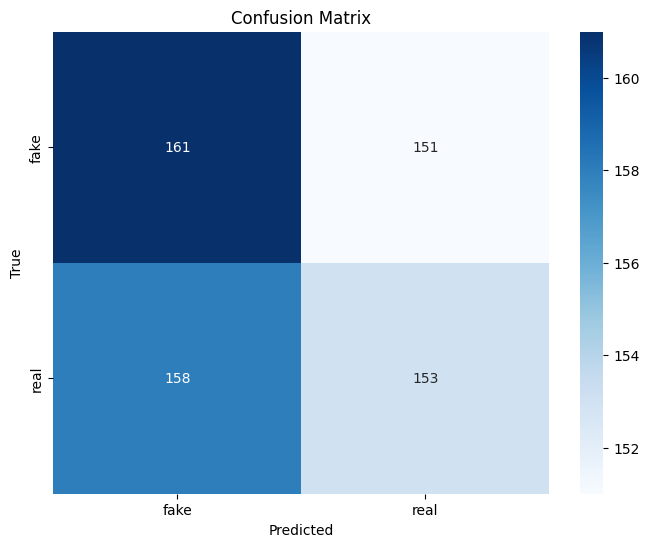

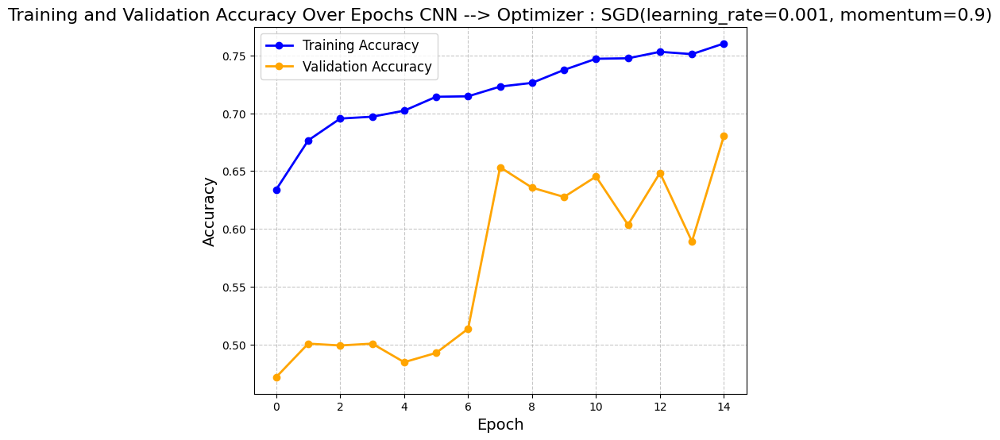

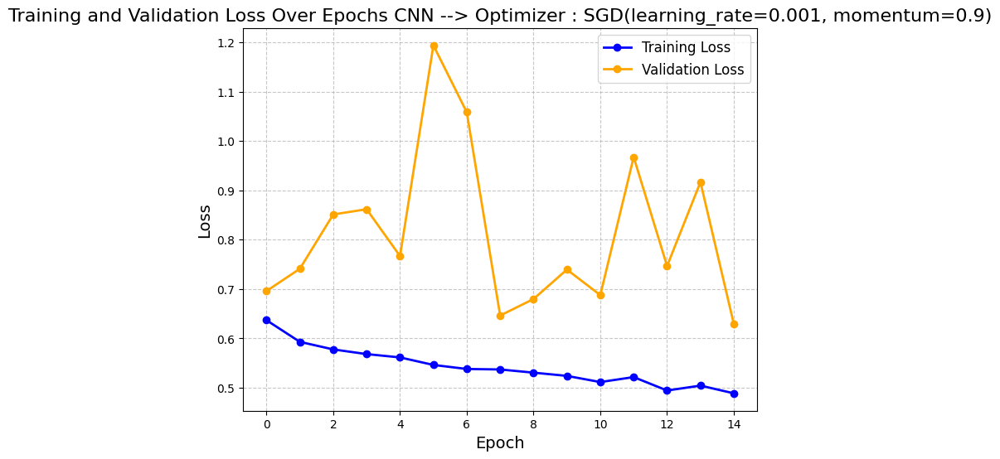

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Random Rotation',
 'Training Accuracy': 0.7603,
 'Training Loss': 0.4888,
 'Validation Accuracy': 0.6806,
 'Validation Loss': 0.6292,
 'Precision': 0.504,
 'Recall': 0.504,
 'F1-Score': 0.5039}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : SGD(learning_rate=0.001, momentum=0.9)", "binary")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Random Rotation"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

##### **GaussianBlur**

Found 2495 images belonging to 2 classes.
Found 623 images belonging to 2 classes.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


binary


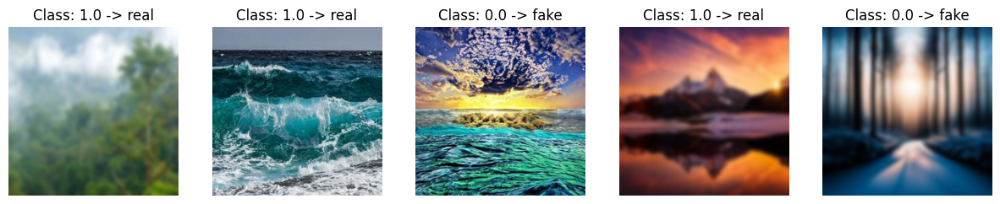

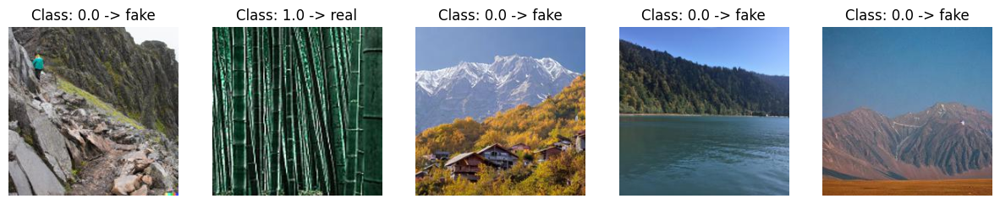

In [ ]:
#make basic dataset
# 0 -> fake , 1 -> real
train_generator, validation_generator = Make_Dataset(dataset_path_realness, batch_size, random_seed, 'binary', data_augmentation = 'GaussianBlur')
display_sample_images(train_generator, task = 'binary')
display_sample_images(validation_generator, task = 'binary')

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
#lr_scheduler = LearningRateScheduler(linear_decay)

#make a cnn model
model = Make_Model('binary', 'cnn', 'sgd')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_144 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_144 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_207 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_18 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_145 (Conv2D)         (None, 56, 56, 64)        36928   

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.818436861038208
Validation Accuracy: 0.642054557800293
Training Loss: 0.4004518687725067
Validation Loss: 0.6862644553184509


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.48      0.27      0.34       312
           1       0.49      0.71      0.58       311

    accuracy                           0.49       623
   macro avg       0.49      0.49      0.46       623
weighted avg       0.49      0.49      0.46       623



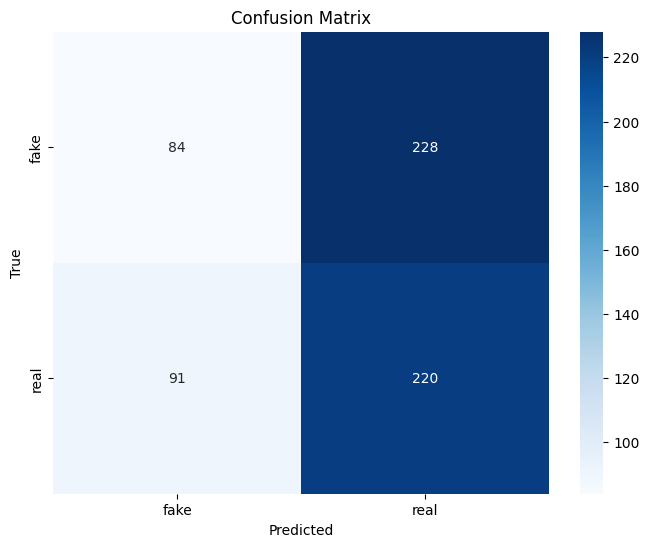

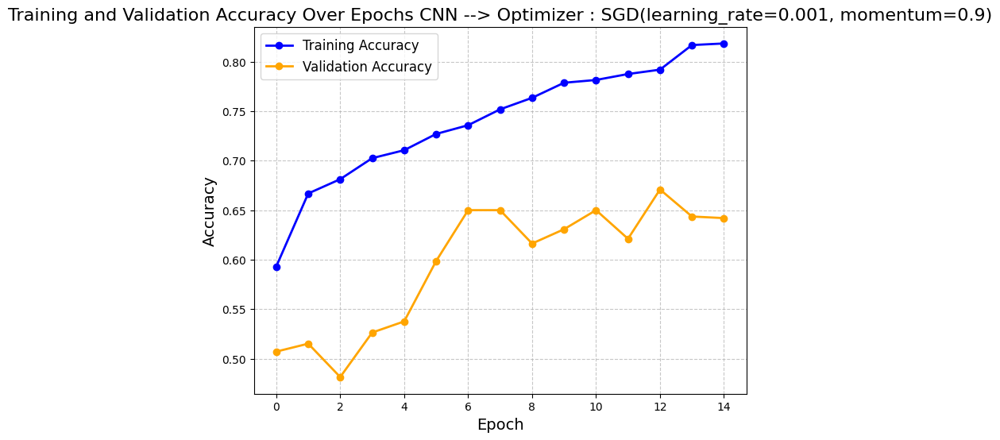

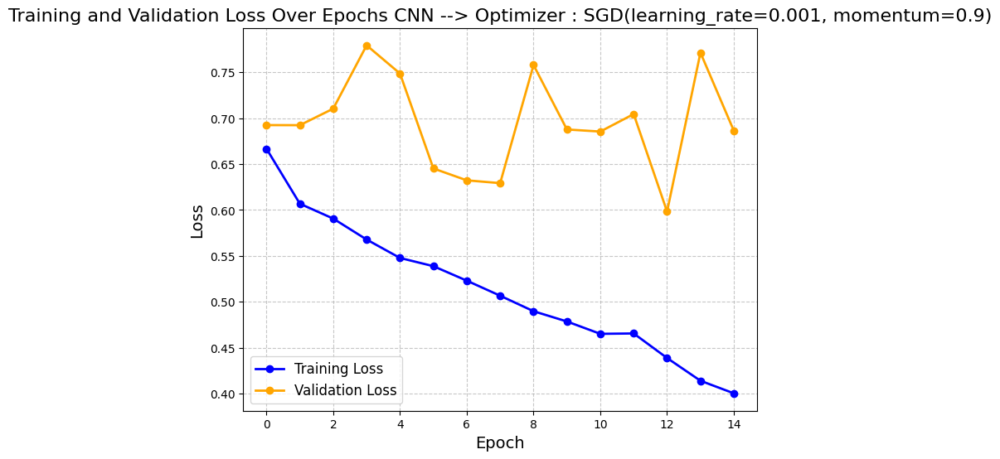

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Gaussian Blur',
 'Training Accuracy': 0.8184,
 'Training Loss': 0.4005,
 'Validation Accuracy': 0.6421,
 'Validation Loss': 0.6863,
 'Precision': 0.4855,
 'Recall': 0.488,
 'F1-Score': 0.4622}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : SGD(learning_rate=0.001, momentum=0.9)", "binary")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Gaussian Blur"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

##### **RandomHorizontalFlip & RandomVerticalFlip**

Found 2495 images belonging to 2 classes.
Found 623 images belonging to 2 classes.


binary


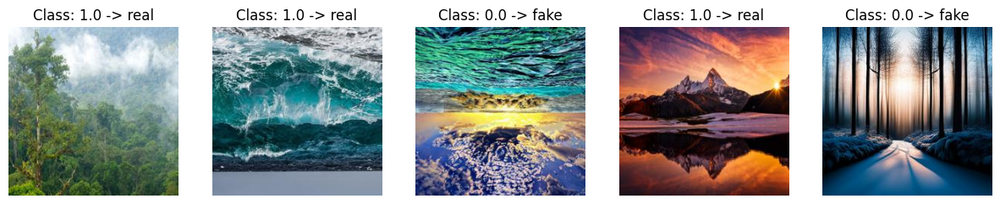

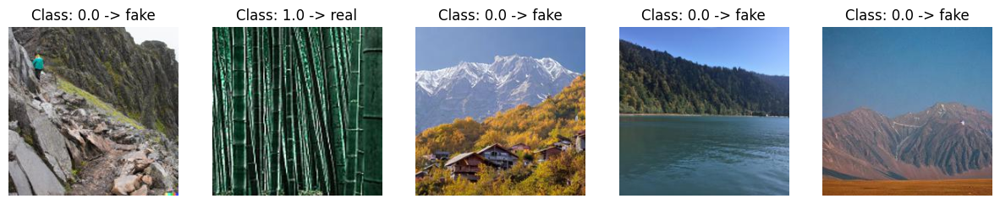

In [ ]:
#make basic dataset
# 0 -> fake , 1 -> real
train_generator, validation_generator = Make_Dataset(dataset_path_realness, batch_size, random_seed, 'binary', data_augmentation = 'RandomFlip')
display_sample_images(train_generator, task = 'binary')
display_sample_images(validation_generator, task = 'binary')

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
#lr_scheduler = LearningRateScheduler(linear_decay)

#make a cnn model
model = Make_Model('binary', 'cnn', 'sgd')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_152 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_152 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_212 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_19 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_153 (Conv2D)         (None, 56, 56, 64)        36928   

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.7703406810760498
Validation Accuracy: 0.6388443112373352
Training Loss: 0.47507354617118835
Validation Loss: 0.6827177405357361


20/20 [==============================] - 1s 49ms/step
              precision    recall  f1-score   support

           0       0.51      0.43      0.47       312
           1       0.50      0.58      0.54       311

    accuracy                           0.50       623
   macro avg       0.50      0.50      0.50       623
weighted avg       0.50      0.50      0.50       623



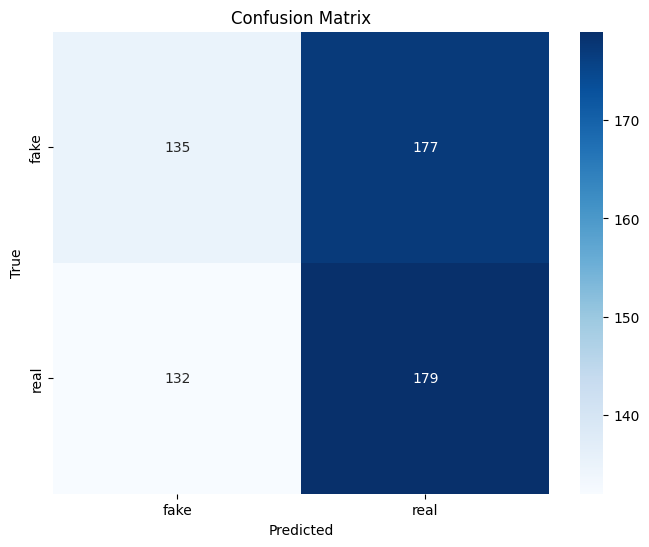

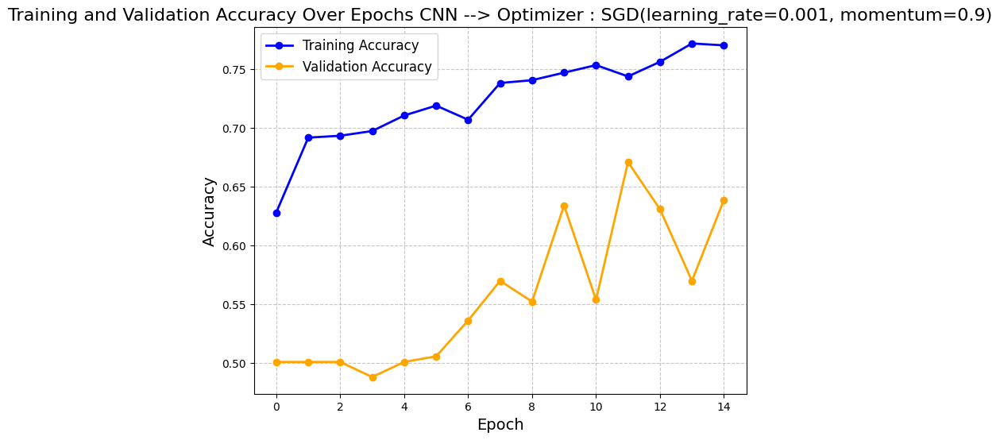

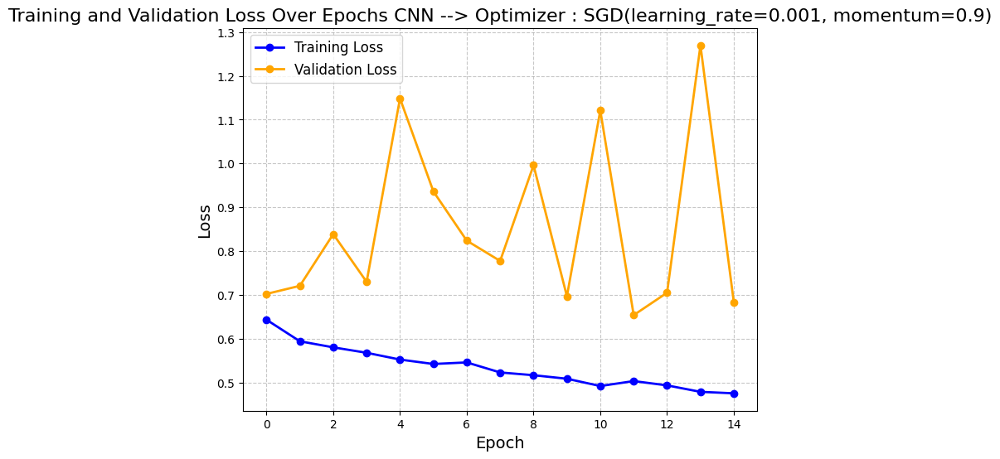

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Random Flip',
 'Training Accuracy': 0.7703,
 'Training Loss': 0.4751,
 'Validation Accuracy': 0.6388,
 'Validation Loss': 0.6827,
 'Precision': 0.5042,
 'Recall': 0.504,
 'F1-Score': 0.5015}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : SGD(learning_rate=0.001, momentum=0.9)", "binary")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Random Flip"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

##### **ColorJitter**

Found 2495 images belonging to 2 classes.
Found 623 images belonging to 2 classes.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


binary


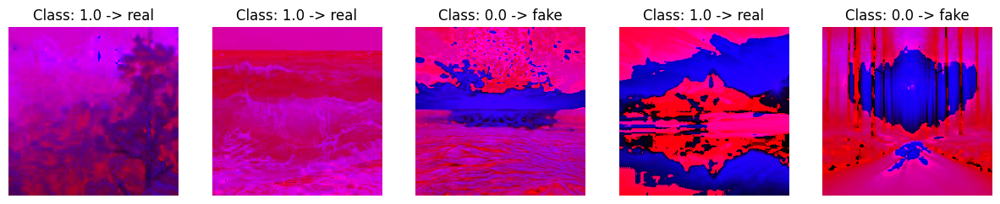

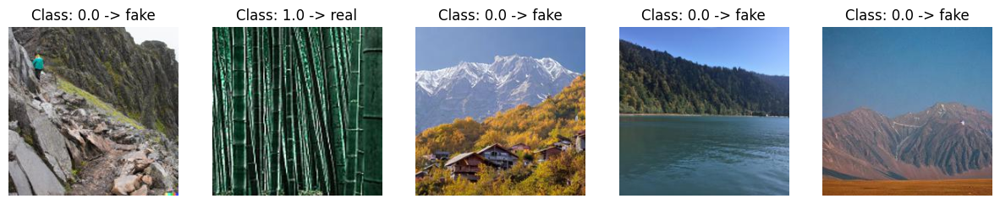

In [ ]:
#make basic dataset
# 0 -> fake , 1 -> real
train_generator, validation_generator = Make_Dataset(dataset_path_realness, batch_size, random_seed, 'binary', data_augmentation = 'ColorJitter')
display_sample_images(train_generator, task = 'binary')
display_sample_images(validation_generator, task = 'binary')

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
#lr_scheduler = LearningRateScheduler(linear_decay)

#make a cnn model
model = Make_Model('binary', 'cnn', 'sgd')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_160 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_160 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_217 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_20 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_161 (Conv2D)         (None, 56, 56, 64)        36928   

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.9150300621986389
Validation Accuracy: 0.5072231292724609
Training Loss: 0.2513546347618103
Validation Loss: 11.365355491638184


20/20 [==============================] - 1s 49ms/step
              precision    recall  f1-score   support

           0       0.50      0.98      0.66       312
           1       0.50      0.02      0.03       311

    accuracy                           0.50       623
   macro avg       0.50      0.50      0.35       623
weighted avg       0.50      0.50      0.35       623



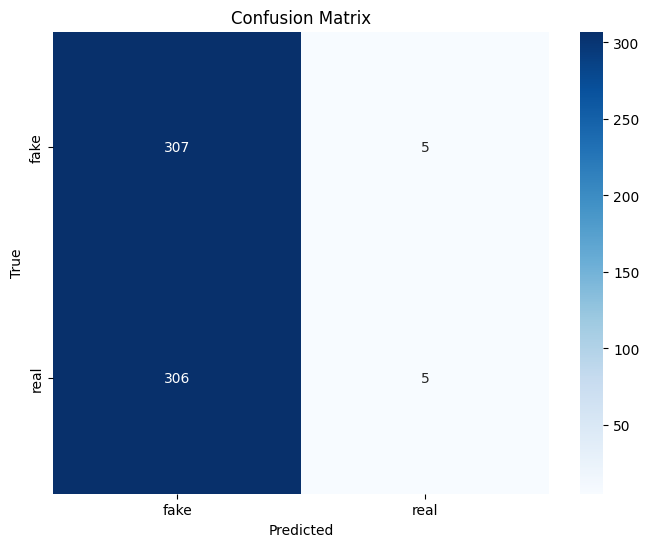

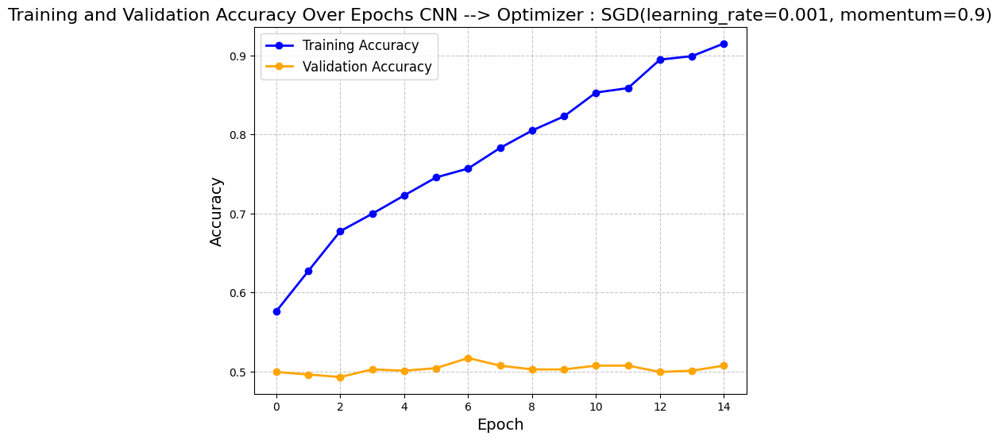

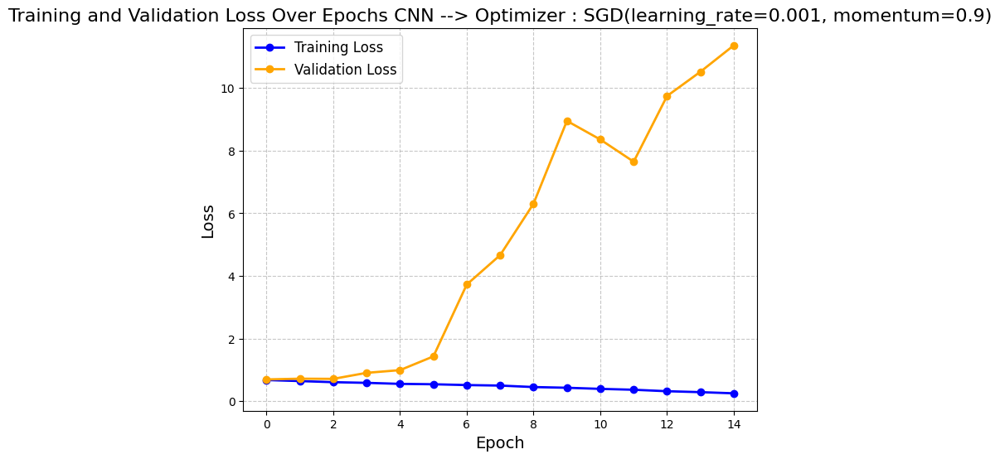

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Color Jitter',
 'Training Accuracy': 0.915,
 'Training Loss': 0.2514,
 'Validation Accuracy': 0.5072,
 'Validation Loss': 11.3654,
 'Precision': 0.5004,
 'Recall': 0.5008,
 'F1-Score': 0.348}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : SGD(learning_rate=0.001, momentum=0.9)", "binary")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Color Jitter"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

##### **Random Crop**

Found 2495 images belonging to 2 classes.
Found 623 images belonging to 2 classes.


binary


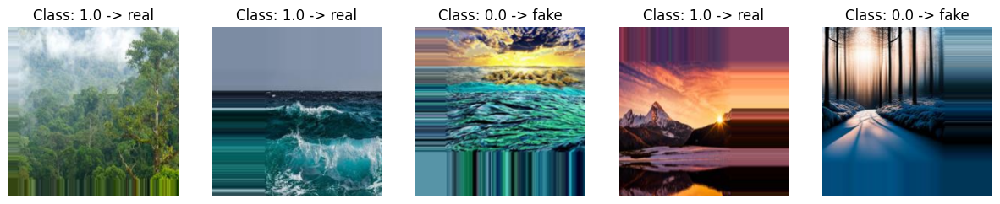

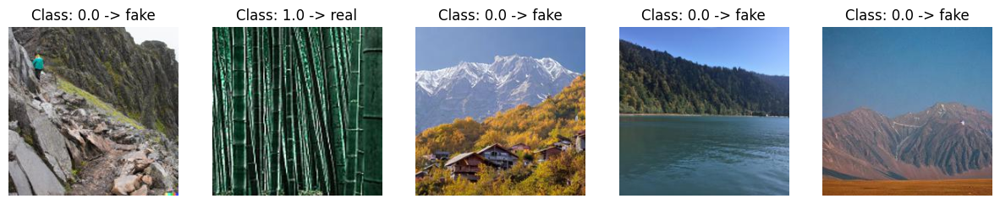

In [ ]:
#RandomCrop
#make basic dataset
# 0 -> fake , 1 -> real
train_generator, validation_generator = Make_Dataset(dataset_path_realness, batch_size, random_seed, 'binary', data_augmentation = 'RandomCrop')
display_sample_images(train_generator, task = 'binary')
display_sample_images(validation_generator, task = 'binary')

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
#lr_scheduler = LearningRateScheduler(linear_decay)

#make a cnn model
model = Make_Model('binary', 'cnn', 'sgd')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   


 conv2d_168 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_168 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_222 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_21 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_169 (Conv2D)         (None, 56, 56, 64)        36928     
                                                                 
 batch_normalization_169 (Ba  (None, 56, 56, 64)       256       
 tchNormalization)                                               
                                                                 
 conv2d_17

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.7270541191101074
Validation Accuracy: 0.6163724064826965
Training Loss: 0.5237903594970703
Validation Loss: 0.7822888493537903


20/20 [==============================] - 1s 47ms/step
              precision    recall  f1-score   support

           0       0.49      0.38      0.42       312
           1       0.49      0.61      0.54       311

    accuracy                           0.49       623
   macro avg       0.49      0.49      0.48       623
weighted avg       0.49      0.49      0.48       623



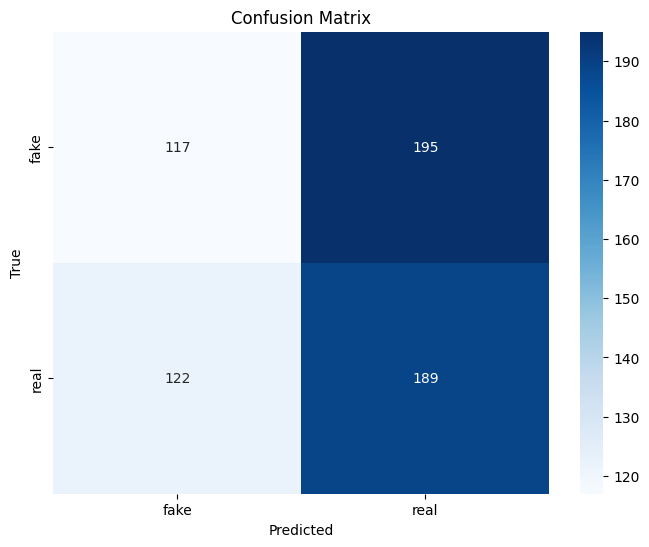

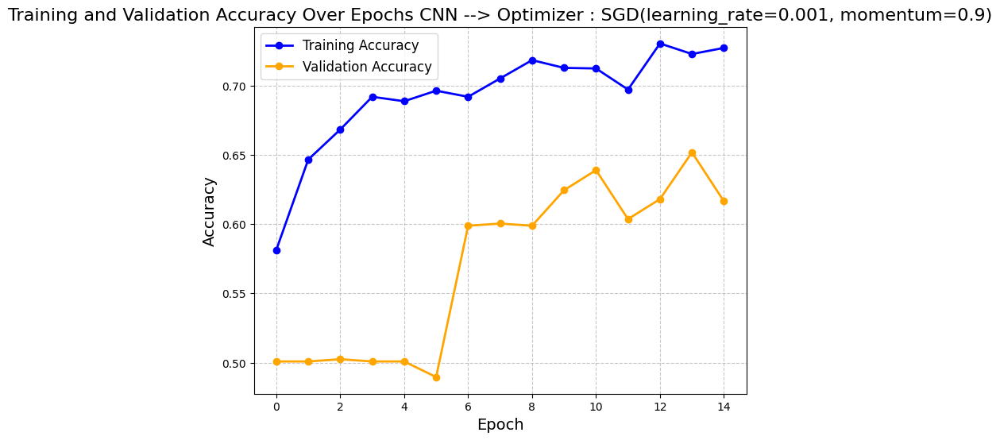

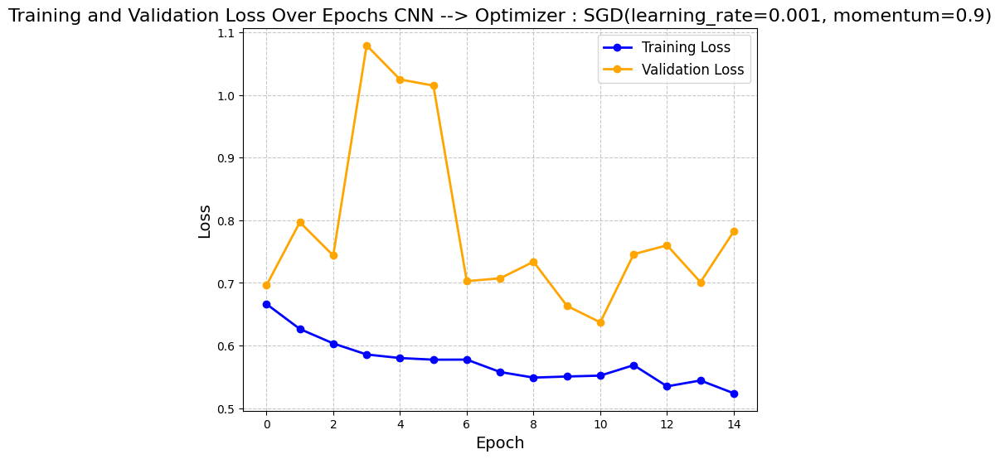

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'SGD(learning_rate=0.001, momentum=0.9)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Random Crop',
 'Training Accuracy': 0.7271,
 'Training Loss': 0.5238,
 'Validation Accuracy': 0.6164,
 'Validation Loss': 0.7823,
 'Precision': 0.4909,
 'Recall': 0.4912,
 'F1-Score': 0.4842}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : SGD(learning_rate=0.001, momentum=0.9)", "binary")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "SGD(learning_rate=0.001, momentum=0.9)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Random Crop"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

##### **MixUp**

Found 2495 images belonging to 2 classes.
Found 2495 images belonging to 2 classes.
Found 623 images belonging to 2 classes.


binary


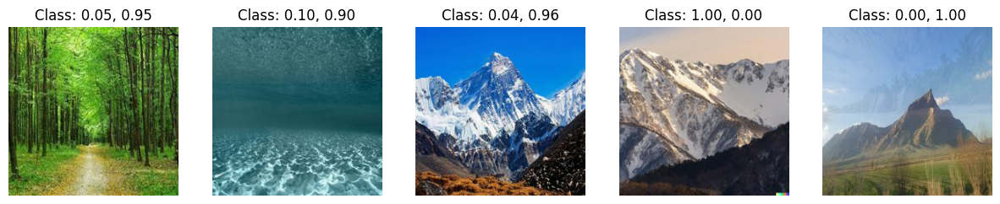

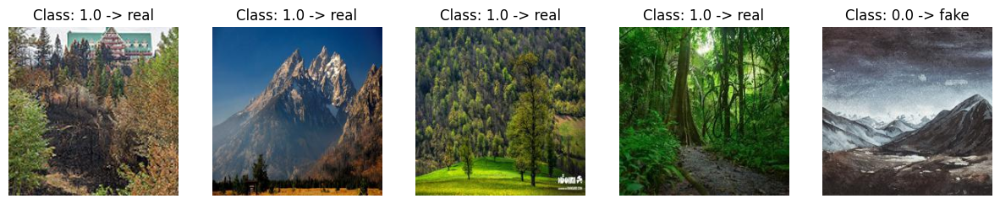

In [ ]:
#RandomCrop
#make basic dataset
# 0 -> fake , 1 -> real
train_generator, validation_generator = Make_Dataset(dataset_path_realness, batch_size, random_seed, 'binary', data_augmentation = 'MixUp')
display_sample_images_for_mixup(train_generator)
display_sample_images(validation_generator, task='binary')

In [ ]:
#make a cnn model
model = Make_Model('binary', 'cnn', 'sgd')


# Train the model with Mixup
history_mixup = model.fit(
    train_generator,
    epochs=10,
    validation_data=validation_generator,
    steps_per_epoch=train_generator.get_steps_per_epoch() // batch_size,
    validation_steps=validation_generator.samples // batch_size
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_176 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_176 (Ba  (None, 112, 112, 64)     256       


 tchNormalization)                                               
                                                                 
 re_lu_227 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_22 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_177 (Conv2D)         (None, 56, 56, 64)        36928     
                                                                 
 batch_normalization_177 (Ba  (None, 56, 56, 64)       256       
 tchNormalization)                                               
                                                                 
 conv2d_178 (Conv2D)         (None, 56, 56, 128)       73856     
                                                                 
 batch_normalization_178 (Ba  (None, 56, 56, 128)      512       
 tchNormal

### **Optimization Algorithm**

Found 2495 images belonging to 2 classes.


Found 623 images belonging to 2 classes.
binary


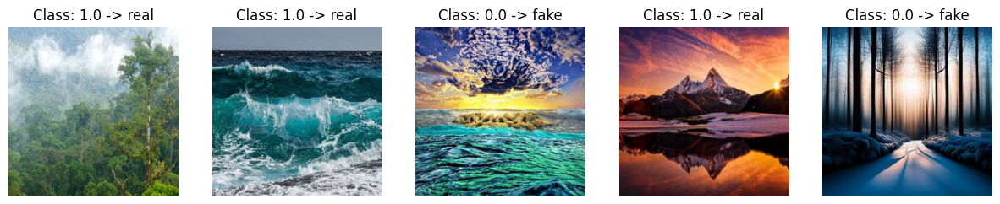

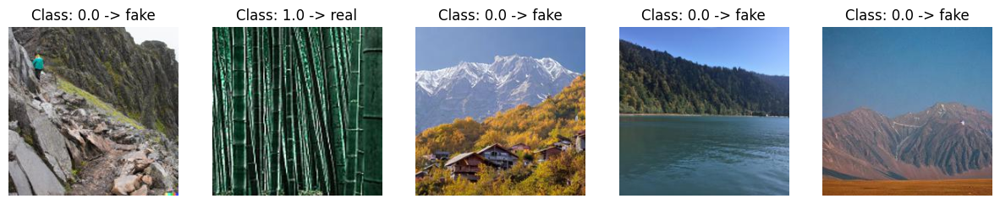

In [ ]:
#RandomCrop
#make basic dataset
# 0 -> fake , 1 -> real
train_generator, validation_generator = Make_Dataset(dataset_path_realness, batch_size, random_seed, 'binary', data_augmentation = 'default')
display_sample_images(train_generator, task = 'binary')
display_sample_images(validation_generator, task = 'binary')

#### **`CNN` Model From Scratch (with Optimizers)**

##### **Adam**

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('binary', 'cnn', 'adam')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
Optimizer : Adam(learning_rate=0.001)
Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_184 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_184 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_232 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_23 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_185 (Conv2D)         (None, 56, 56, 64)        36928     
          

 re_lu_235 (ReLU)            (None, 14, 14, 256)       0         
                                                                 
 conv2d_191 (Conv2D)         (None, 7, 7, 512)         1180160   
                                                                 
 batch_normalization_191 (Ba  (None, 7, 7, 512)        2048      
 tchNormalization)                                               
                                                                 
 re_lu_236 (ReLU)            (None, 7, 7, 512)         0         
                                                                 
 global_average_pooling2d_29  (None, 512)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_29 (Dense)            (None, 1)                 513       
                                                                 
Total params: 2,482,881
Trainable params: 2,479,809
Non-trainable params: 3,

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.7278556823730469
Validation Accuracy: 0.6709470152854919
Training Loss: 0.5347532629966736
Validation Loss: 0.6314657330513


20/20 [==============================] - 1s 49ms/step
              precision    recall  f1-score   support

           0       0.49      0.49      0.49       312
           1       0.49      0.49      0.49       311

    accuracy                           0.49       623
   macro avg       0.49      0.49      0.49       623
weighted avg       0.49      0.49      0.49       623



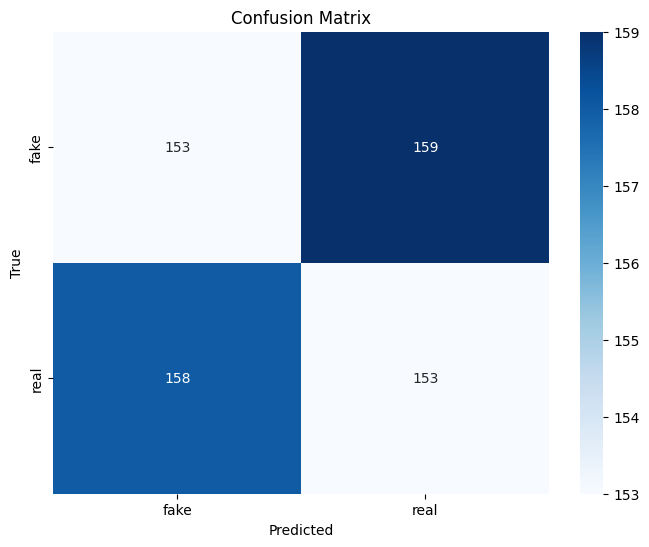

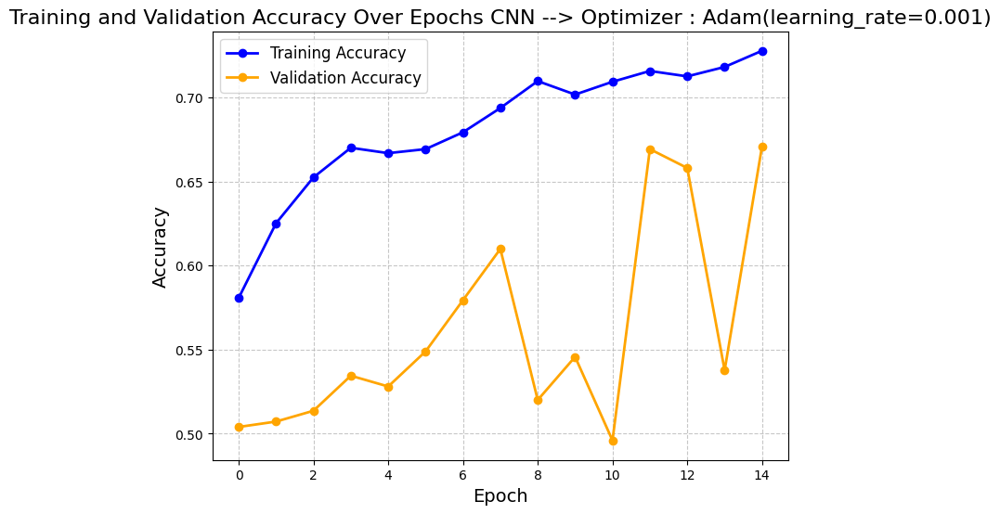

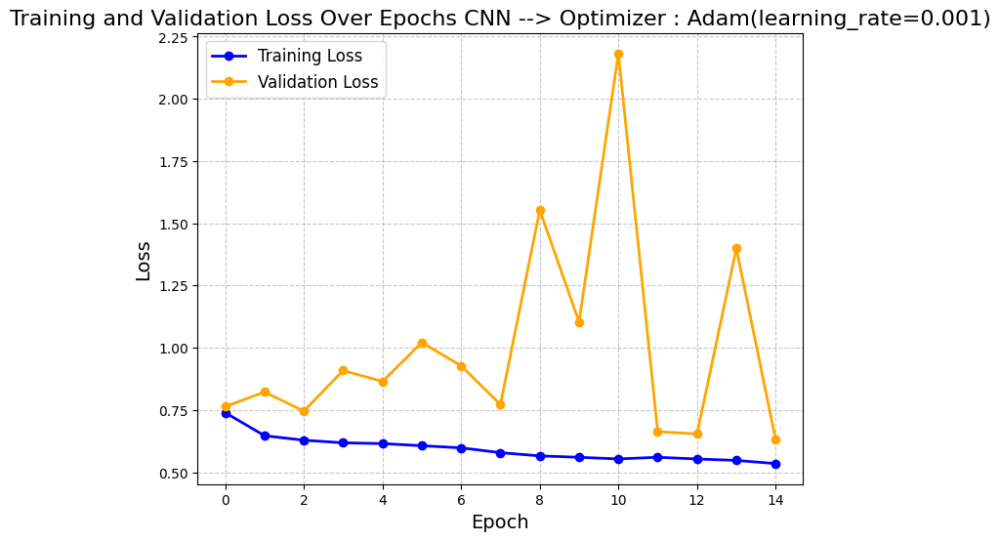

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'Adam(learning_rate=0.001)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.7279,
 'Training Loss': 0.5348,
 'Validation Accuracy': 0.6709,
 'Validation Loss': 0.6315,
 'Precision': 0.4912,
 'Recall': 0.4912,
 'F1-Score': 0.4912}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : Adam(learning_rate=0.001)", "binary")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "Adam(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

##### **AdamW**

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('binary', 'cnn', 'adamw')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
AdamW(learning_rate=0.001, weight_decay=0.01)
Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_192 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_192 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_237 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_24 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_193 (Conv2D)         (None, 56, 56, 64)        36928     
  

 tchNormalization)                                               
                                                                 
 re_lu_241 (ReLU)            (None, 7, 7, 512)         0         
                                                                 
 global_average_pooling2d_30  (None, 512)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_30 (Dense)            (None, 1)                 513       
                                                                 
Total params: 2,482,881
Trainable params: 2,479,809
Non-trainable params: 3,072
_________________________________________________________________
Epoch 1/15
78/78 [==============================] - 14s 167ms/step - loss: 0.7659 - accuracy: 0.5607 - val_loss: 0.6967 - val_accuracy: 0.5008
Epoch 2/15
78/78 [==============================] - 13s 163ms/step - loss: 0.6730 - accuracy: 0.5804 - val_loss: 0.69

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.49979960918426514
Validation Accuracy: 0.49919742345809937
Training Loss: 0.6931856870651245
Validation Loss: 0.6931480765342712


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       312
           1       0.50      1.00      0.67       311

    accuracy                           0.50       623
   macro avg       0.25      0.50      0.33       623
weighted avg       0.25      0.50      0.33       623



c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\Active\miniconda3\envs\tf\lib\site-packages\sklearn\metrics\_classification.py:1497: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\A

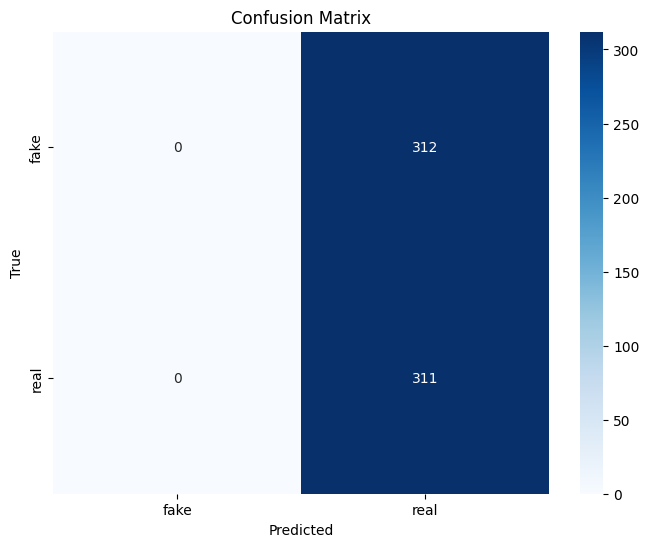

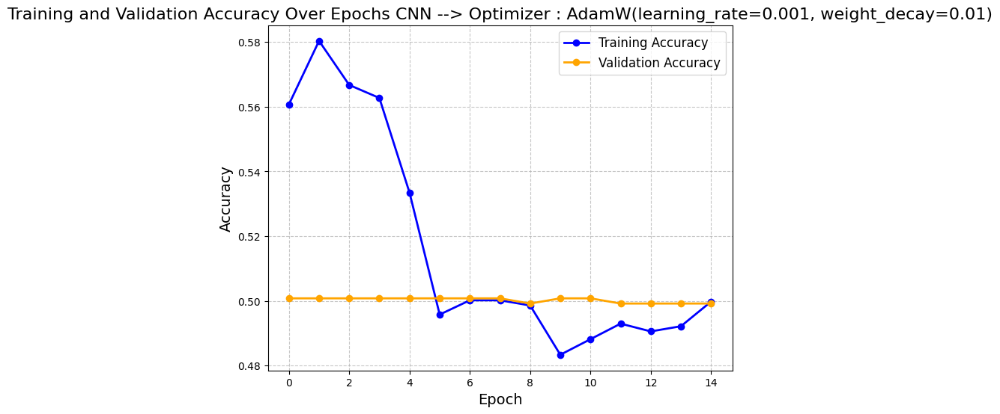

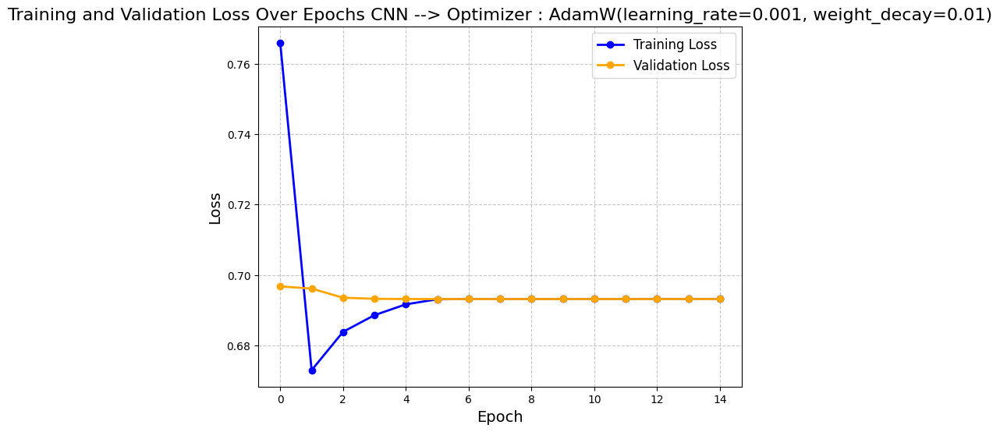

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'AdamW(learning_rate=0.001, weight_decay=0.01)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.4998,
 'Training Loss': 0.6932,
 'Validation Accuracy': 0.4992,
 'Validation Loss': 0.6931,
 'Precision': 0.2492,
 'Recall': 0.4992,
 'F1-Score': 0.3324}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : AdamW(learning_rate=0.001, weight_decay=0.01)", "binary")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "AdamW(learning_rate=0.001, weight_decay=0.01)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

##### **RMSProp**

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

#make a cnn model
model = Make_Model('binary', 'cnn', 'rmsprop')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
Optimizer : RMSprop(learning_rate=0.001)
Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_200 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_200 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_242 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_25 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_201 (Conv2D)         (None, 56, 56, 64)        36928     
       

Epoch 1/15
78/78 [==============================] - 15s 168ms/step - loss: 0.8216 - accuracy: 0.5287 - val_loss: 0.7313 - val_accuracy: 0.4992
Epoch 2/15
78/78 [==============================] - 13s 165ms/step - loss: 0.6783 - accuracy: 0.5756 - val_loss: 1.2638 - val_accuracy: 0.5811
Epoch 3/15
78/78 [==============================] - 13s 165ms/step - loss: 0.6608 - accuracy: 0.6028 - val_loss: 1.3670 - val_accuracy: 0.5650
Epoch 4/15
78/78 [==============================] - 13s 165ms/step - loss: 0.6339 - accuracy: 0.6477 - val_loss: 1.0385 - val_accuracy: 0.5746
Epoch 5/15
78/78 [==============================] - 13s 166ms/step - loss: 0.6177 - accuracy: 0.6617 - val_loss: 0.8423 - val_accuracy: 0.5891
Epoch 6/15
78/78 [==============================] - 13s 166ms/step - loss: 0.6071 - accuracy: 0.6681 - val_loss: 1.4613 - val_accuracy: 0.5634
Epoch 7/15
78/78 [==============================] - 13s 165ms/step - loss: 0.5984 - accuracy: 0.6754 - val_loss: 1.1728 - val_accuracy: 0.5554

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.7334669232368469
Validation Accuracy: 0.6356340050697327
Training Loss: 0.5468770861625671
Validation Loss: 0.8004655241966248


20/20 [==============================] - 1s 49ms/step
              precision    recall  f1-score   support

           0       0.52      0.40      0.45       312
           1       0.51      0.63      0.57       311

    accuracy                           0.52       623
   macro avg       0.52      0.52      0.51       623
weighted avg       0.52      0.52      0.51       623



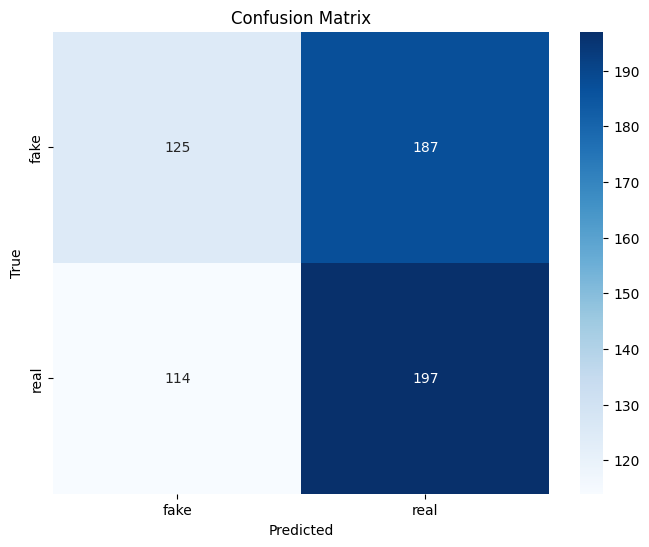

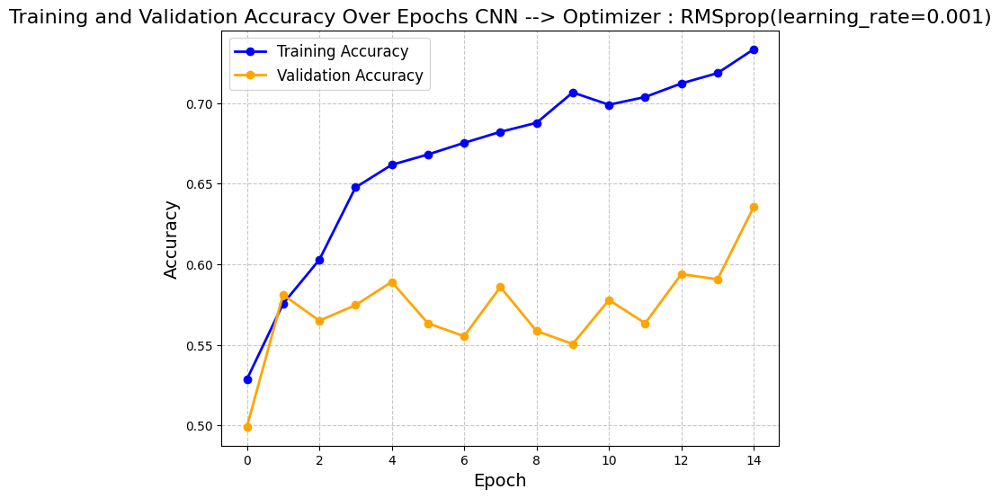

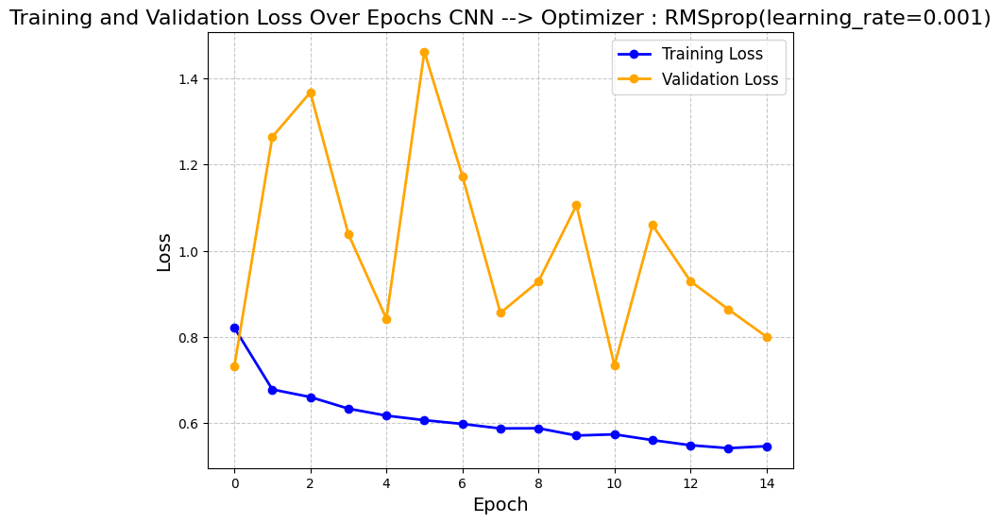

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'RMSprop(learning_rate=0.001)',
 'Learning Rate Schedular': 'Nothing',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.7335,
 'Training Loss': 0.5469,
 'Validation Accuracy': 0.6356,
 'Validation Loss': 0.8005,
 'Precision': 0.518,
 'Recall': 0.5169,
 'F1-Score': 0.5102}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : RMSprop(learning_rate=0.001)", "binary")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "RMSprop(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "Nothing"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

### **Learning Rate Schedular**

#### **`CNN` Model From Scratch**



##### **LinearLR**

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=6, restore_best_weights=True)
# Define the LearningRateScheduler callback
lr_scheduler = LearningRateScheduler(linear_decay)

#make a cnn model
model = Make_Model('binary', 'cnn', 'adam')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
    callbacks=[early_stopping, lr_scheduler]
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
Optimizer : Adam(learning_rate=0.001)
Model: "sequential_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_208 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_208 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_247 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_26 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_209 (Conv2D)         (None, 56, 56, 64)        36928     
          

Total params: 2,482,881
Trainable params: 2,479,809
Non-trainable params: 3,072
_________________________________________________________________
Epoch 1/15
78/78 [==============================] - 14s 166ms/step - loss: 0.8889 - accuracy: 0.5311 - val_loss: 31.8169 - val_accuracy: 0.4992 - lr: 0.0100
Epoch 2/15
78/78 [==============================] - 13s 163ms/step - loss: 0.6871 - accuracy: 0.5776 - val_loss: 1.6845 - val_accuracy: 0.5201 - lr: 0.0090
Epoch 3/15
78/78 [==============================] - 13s 163ms/step - loss: 0.6667 - accuracy: 0.6100 - val_loss: 0.9770 - val_accuracy: 0.5136 - lr: 0.0080
Epoch 4/15
78/78 [==============================] - 13s 163ms/step - loss: 0.6514 - accuracy: 0.6188 - val_loss: 0.7900 - val_accuracy: 0.5474 - lr: 0.0070
Epoch 5/15
78/78 [==============================] - 13s 163ms/step - loss: 0.6491 - accuracy: 0.6313 - val_loss: 0.9036 - val_accuracy: 0.5634 - lr: 0.0060
Epoch 6/15
78/78 [==============================] - 13s 163ms/step - loss

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.7142284512519836
Validation Accuracy: 0.6532905101776123
Training Loss: 0.5461320877075195
Validation Loss: 0.6473981142044067


20/20 [==============================] - 1s 49ms/step
              precision    recall  f1-score   support

           0       0.48      0.44      0.46       312
           1       0.48      0.52      0.50       311

    accuracy                           0.48       623
   macro avg       0.48      0.48      0.48       623
weighted avg       0.48      0.48      0.48       623



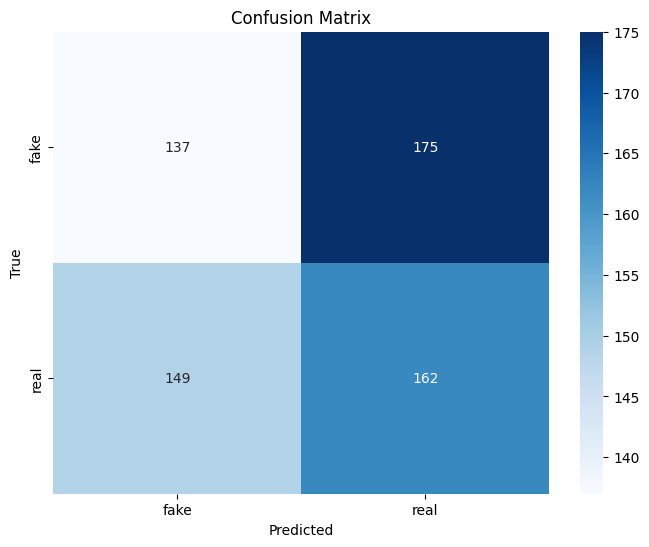

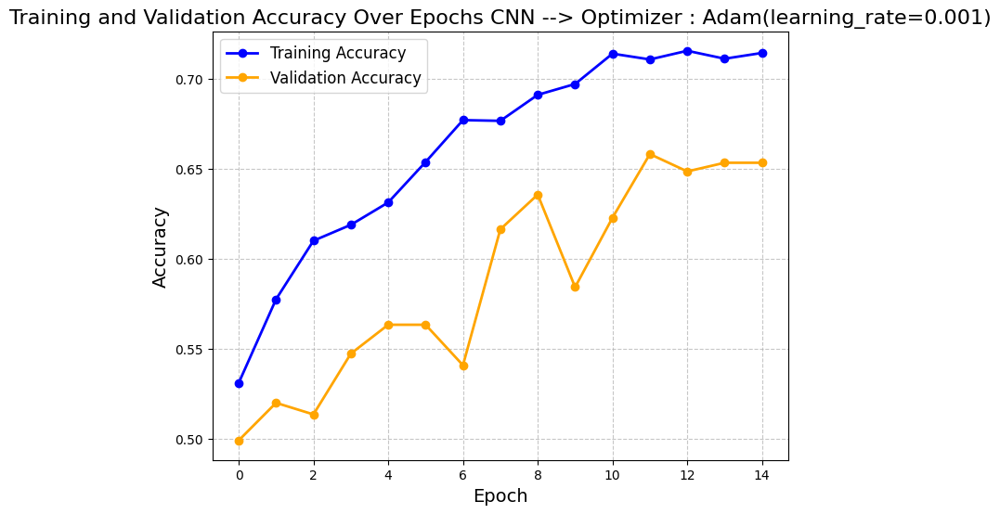

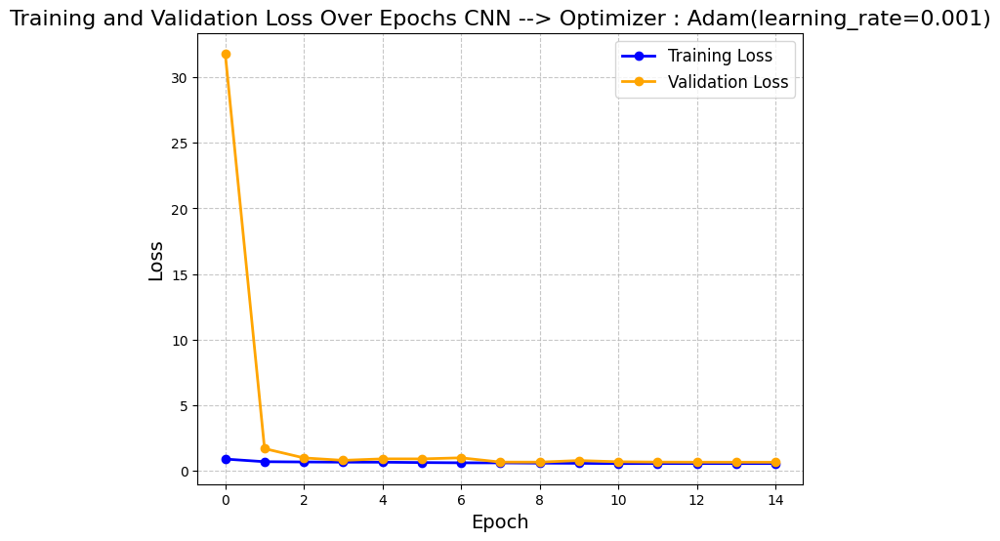

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'Adam(learning_rate=0.001)',
 'Learning Rate Schedular': 'LinearLR',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.7142,
 'Training Loss': 0.5461,
 'Validation Accuracy': 0.6533,
 'Validation Loss': 0.6474,
 'Precision': 0.4799,
 'Recall': 0.4799,
 'F1-Score': 0.4791}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : Adam(learning_rate=0.001)", "binary")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "Adam(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "LinearLR"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

##### **ExponentialLR**

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=6, restore_best_weights=True)
# Define the LearningRateScheduler callback
lr_scheduler = LearningRateScheduler(exponential_decay)

#make a cnn model
model = Make_Model('binary', 'cnn', 'adam')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
    callbacks=[early_stopping, lr_scheduler]
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
Optimizer : Adam(learning_rate=0.001)
Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_216 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_216 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_252 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_27 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_217 (Conv2D)         (None, 56, 56, 64)        36928     
          

 tchNormalization)                                               
                                                                 
 conv2d_222 (Conv2D)         (None, 14, 14, 256)       590080    
                                                                 
 batch_normalization_222 (Ba  (None, 14, 14, 256)      1024      
 tchNormalization)                                               
                                                                 
 re_lu_255 (ReLU)            (None, 14, 14, 256)       0         
                                                                 
 conv2d_223 (Conv2D)         (None, 7, 7, 512)         1180160   
                                                                 
 batch_normalization_223 (Ba  (None, 7, 7, 512)        2048      
 tchNormalization)                                               
                                                                 
 re_lu_256 (ReLU)            (None, 7, 7, 512)         0         
          

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.6649298667907715
Validation Accuracy: 0.6035313010215759
Training Loss: 0.6209060549736023
Validation Loss: 0.6595314741134644


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.46      0.46      0.46       312
           1       0.46      0.46      0.46       311

    accuracy                           0.46       623
   macro avg       0.46      0.46      0.46       623
weighted avg       0.46      0.46      0.46       623



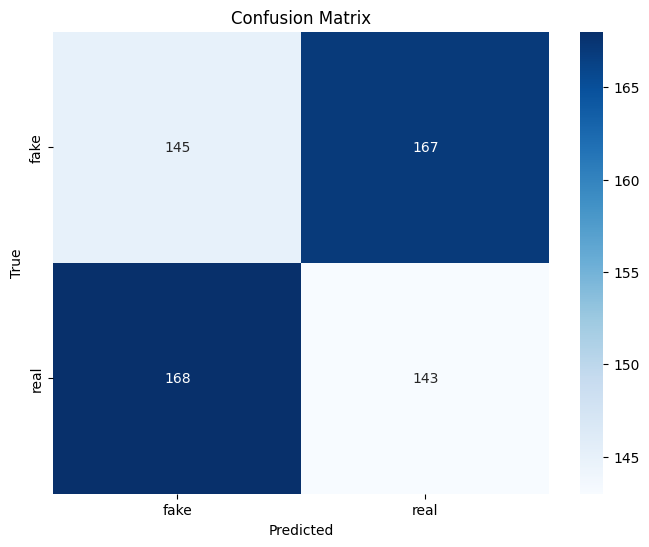

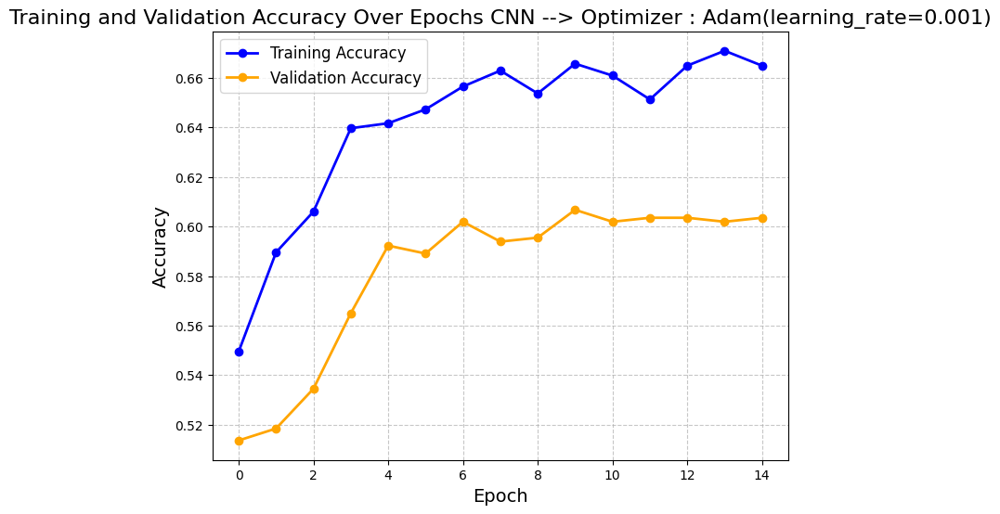

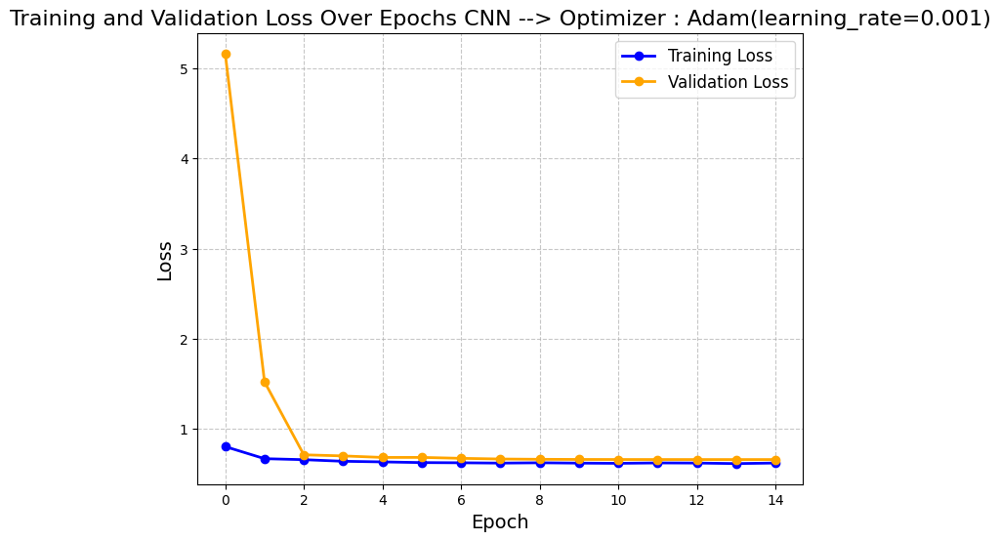

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'Adam(learning_rate=0.001)',
 'Learning Rate Schedular': 'ExponentialLR',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.6649,
 'Training Loss': 0.6209,
 'Validation Accuracy': 0.6035,
 'Validation Loss': 0.6595,
 'Precision': 0.4623,
 'Recall': 0.4623,
 'F1-Score': 0.4623}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : Adam(learning_rate=0.001)", "binary")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "Adam(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "ExponentialLR"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

##### **CyclicLR**

In [ ]:
# Define the LearningRateScheduler callback
clr = CyclicLR()
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=6, restore_best_weights=True)

#make a cnn model
model = Make_Model('binary', 'cnn', 'adam')

# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
    callbacks=[early_stopping, clr]
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
Optimizer : Adam(learning_rate=0.001)
Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_224 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_224 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_257 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_28 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_225 (Conv2D)         (None, 56, 56, 64)        36928     
          

Epoch 1/15
78/78 [==============================] - 14s 166ms/step - loss: 0.7525 - accuracy: 0.5747 - val_loss: 0.8483 - val_accuracy: 0.5008 - lr: 0.0012
Epoch 2/15
78/78 [==============================] - 13s 163ms/step - loss: 0.6679 - accuracy: 0.5892 - val_loss: 1.4374 - val_accuracy: 0.5008 - lr: 0.0014
Epoch 3/15
78/78 [==============================] - 13s 163ms/step - loss: 0.6542 - accuracy: 0.6176 - val_loss: 1.4421 - val_accuracy: 0.4960 - lr: 0.0016
Epoch 4/15
78/78 [==============================] - 13s 163ms/step - loss: 0.6499 - accuracy: 0.6228 - val_loss: 1.1253 - val_accuracy: 0.5072 - lr: 0.0018
Epoch 5/15
78/78 [==============================] - 13s 164ms/step - loss: 0.6514 - accuracy: 0.6337 - val_loss: 0.8468 - val_accuracy: 0.5345 - lr: 0.0020
Epoch 6/15
78/78 [==============================] - 13s 164ms/step - loss: 0.6263 - accuracy: 0.6629 - val_loss: 1.2709 - val_accuracy: 0.5377 - lr: 0.0022
Epoch 7/15
78/78 [==============================] - 13s 164ms/st

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.6697394847869873
Validation Accuracy: 0.5200642347335815
Training Loss: 0.605900228023529
Validation Loss: 1.1360701322555542
20/20 [==============================] - 1s 49ms/step
              precision    recall  f1-score   support

           0       0.49      0.60      0.54       312
           1       0.49      0.38      0.43       311

    accuracy                           0.49       623
   macro avg       0.49      0.49      0.49       623
weighted avg       0.49      0.49      0.49       623



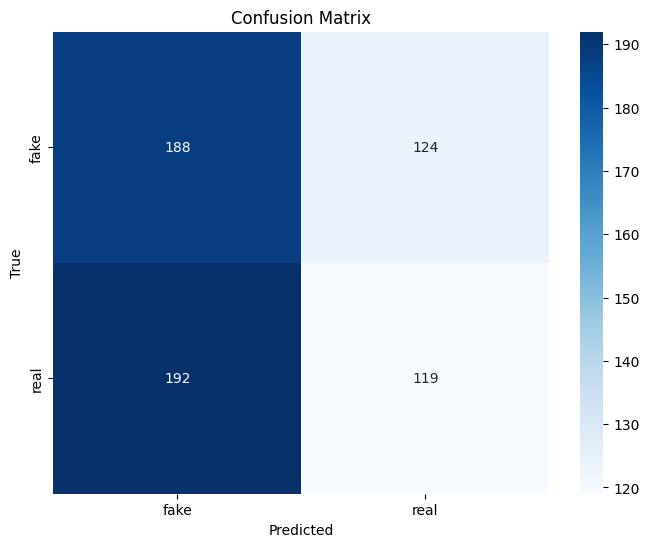

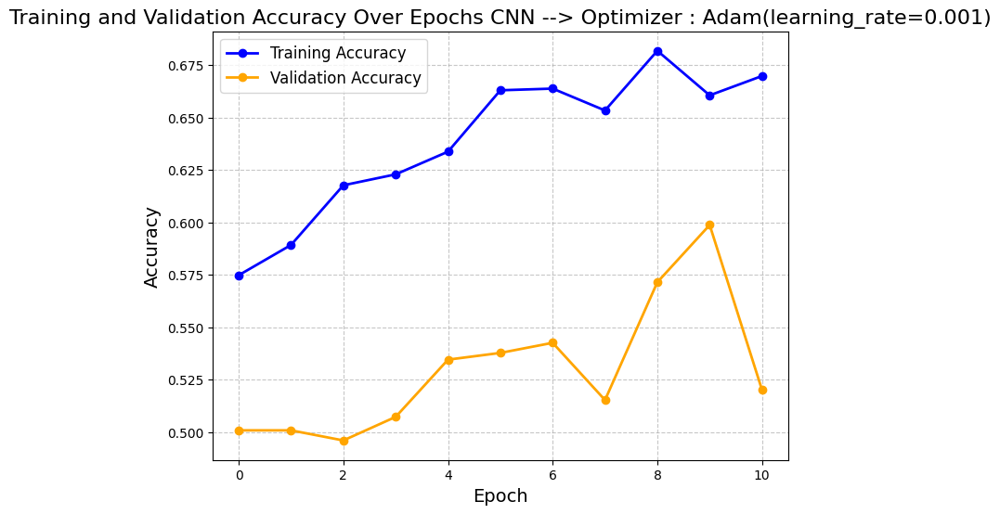

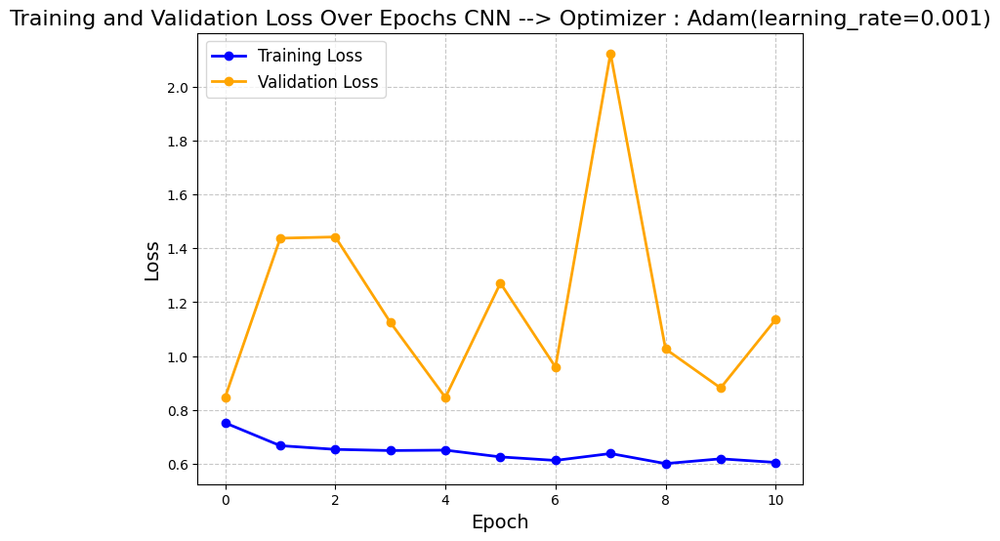

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'Adam(learning_rate=0.001)',
 'Learning Rate Schedular': 'CyclicLR',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.6697,
 'Training Loss': 0.6059,
 'Validation Accuracy': 0.5201,
 'Validation Loss': 1.1361,
 'Precision': 0.4922,
 'Recall': 0.4928,
 'F1-Score': 0.4866}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : Adam(learning_rate=0.001)", "binary")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "Adam(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "CyclicLR"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

##### **StepLR**

In [ ]:
# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=6, restore_best_weights=True)
# Define the LearningRateScheduler callback
lr_scheduler = LearningRateScheduler(step_decay)

#make a cnn model
model = Make_Model('binary', 'cnn', 'adam')
# Train the model
history = model.fit(
    train_generator,
    epochs=15,
    validation_data=validation_generator,
    callbacks=[early_stopping, lr_scheduler]
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
Optimizer : Adam(learning_rate=0.001)
Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_232 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_232 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_262 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_29 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_233 (Conv2D)         (None, 56, 56, 64)        36928     
          

78/78 [==============================] - 14s 166ms/step - loss: 0.7959 - accuracy: 0.5267 - val_loss: 17.7895 - val_accuracy: 0.5024 - lr: 0.0093
Epoch 2/15
78/78 [==============================] - 13s 162ms/step - loss: 0.6747 - accuracy: 0.5864 - val_loss: 4.3159 - val_accuracy: 0.4944 - lr: 0.0087
Epoch 3/15
78/78 [==============================] - 13s 162ms/step - loss: 0.6685 - accuracy: 0.6032 - val_loss: 1.6399 - val_accuracy: 0.4799 - lr: 0.0081
Epoch 4/15
78/78 [==============================] - 13s 162ms/step - loss: 0.6487 - accuracy: 0.6289 - val_loss: 0.8096 - val_accuracy: 0.5522 - lr: 0.0076
Epoch 5/15
78/78 [==============================] - 13s 163ms/step - loss: 0.6517 - accuracy: 0.6261 - val_loss: 0.8409 - val_accuracy: 0.5506 - lr: 0.0071
Epoch 6/15
78/78 [==============================] - 13s 163ms/step - loss: 0.6398 - accuracy: 0.6357 - val_loss: 1.9913 - val_accuracy: 0.5201 - lr: 0.0066
Epoch 7/15
78/78 [==============================] - 13s 163ms/step - loss:

#############################################
Accuracy & Loss (Training & Validation Set)
#############################################
Training Accuracy: 0.7162324786186218
Validation Accuracy: 0.5441412329673767
Training Loss: 0.5518347024917603
Validation Loss: 1.3008689880371094


20/20 [==============================] - 1s 48ms/step
              precision    recall  f1-score   support

           0       0.48      0.74      0.58       312
           1       0.41      0.18      0.25       311

    accuracy                           0.46       623
   macro avg       0.44      0.46      0.41       623
weighted avg       0.44      0.46      0.41       623



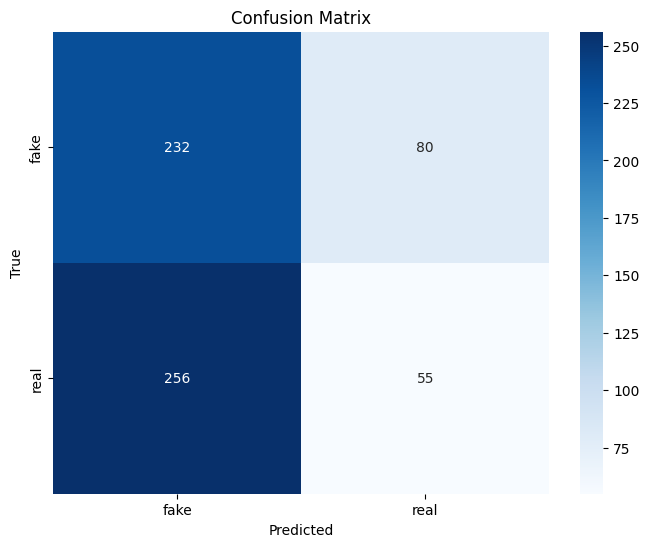

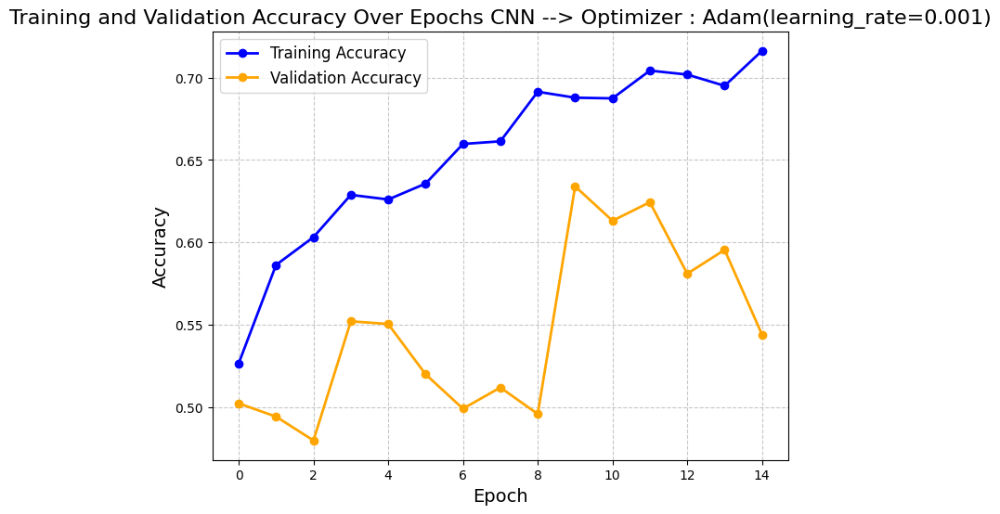

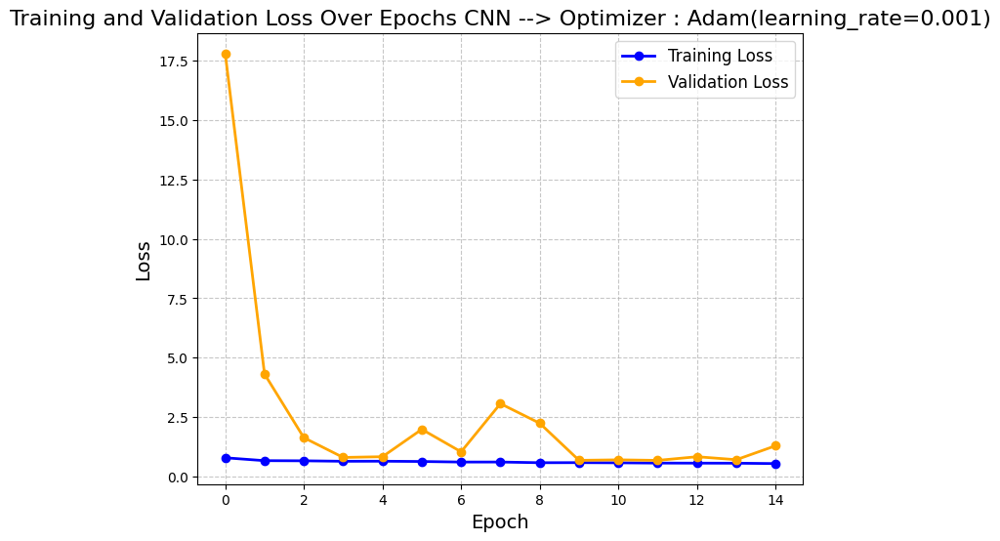

{'Model Name': 'CNN from Scratch',
 'Optimizer': 'Adam(learning_rate=0.001)',
 'Learning Rate Schedular': 'StepLR',
 'Data Augmentation': 'Nothing',
 'Training Accuracy': 0.7162,
 'Training Loss': 0.5518,
 'Validation Accuracy': 0.5441,
 'Validation Loss': 1.3009,
 'Precision': 0.4415,
 'Recall': 0.4607,
 'F1-Score': 0.4136}

In [ ]:
# Call the function with your parameters
train_accuracy, val_accuracy, train_loss, val_loss, precision, recall, f1_score = plot_metrics_and_matrix(history, model, validation_generator, " CNN --> Optimizer : Adam(learning_rate=0.001)", "binary")
detail_history = dict()
detail_history["Model Name"] = "CNN from Scratch"
detail_history["Optimizer"] = "Adam(learning_rate=0.001)"
detail_history["Learning Rate Schedular"] = "StepLR"
detail_history["Data Augmentation"] = "Nothing"
detail_history["Training Accuracy"] = round(train_accuracy, 4)
detail_history["Training Loss"] = round(train_loss, 4)
detail_history["Validation Accuracy"] = round(val_accuracy, 4)
detail_history["Validation Loss"] = round(val_loss, 4)
detail_history["Precision"] = round(precision, 4)
detail_history["Recall"] = round(recall, 4)
detail_history["F1-Score"] = round(f1_score, 4)
all_results_binary.append(detail_history)
detail_history

### **Best Model implementation (From my results)**

In this part, I based on the results obtained in the above models using data augmentation techniques and optimizers and Learning Rate Schedular techniques (which one was better at improving the performance of my model)
I came and put a total of these on all three of models (CNN from scratch , ResNet and MobileNet)
with these methods then analyze the results.

**My best Optimizer :** `Adam`

**Best Learning Rate Scheduler :** `LinearLR`

**Best Data Augmentation Techniques :** `ColorJitter` and `RandomCrop`

In data augmentation part my model didn't improve in accuracy and decrease in loss but `ColorJitter` and `RandomCrop` a little better than other methods.
**(But in my opinion models without any augmentation were better)**

### **Conclusion and Final Result**

Now in this part I will Train again 3 models - with 20 epochs (`Base CNN` , `ResNet` and `MobileNet`) with :
- `Adam` `Optimizer`  
- All `Data Augmentation` techniques make my model performance worse (with a specific optimizer) so I will not use any of them.
- `LinearLR` as the best `Learning Rate Schedular`.

then analyze the final result and then save my model for my best model for testing in presentation day.

At the I make a `csv` file for for result of all models that trained in my notebook.

Found 2495 images belonging to 2 classes.
Found 623 images belonging to 2 classes.


binary


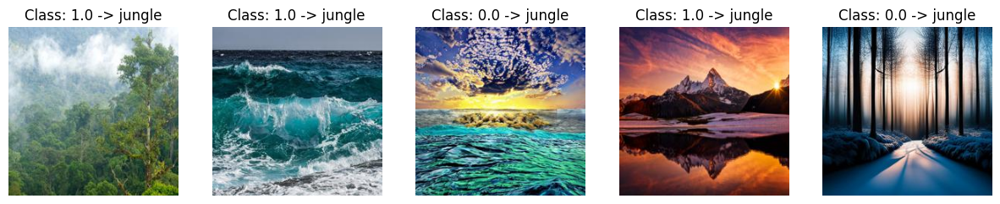

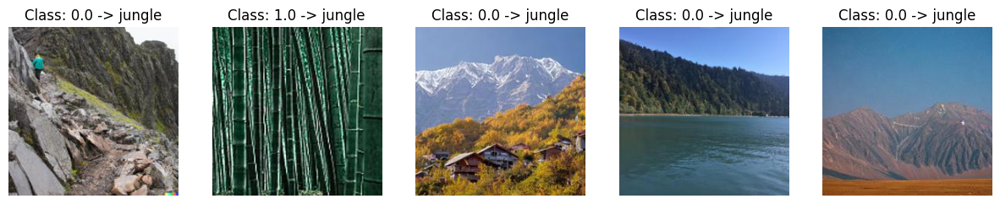

In [ ]:
train_generator, validation_generator = Make_Dataset(dataset_path_realness, batch_size, random_seed, 'binary', data_augmentation = 'default')
display_sample_images(train_generator)
display_sample_images(validation_generator)

#### **Best CNN from scratch model**

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint

checkpoint = ModelCheckpoint('./saved_models/best_cnn_binary.h5',
                             save_best_only=True,
                             monitor='val_accuracy',
                             mode='max',
                             verbose=1)

# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
# Define the LearningRateScheduler callback
lr_scheduler = LearningRateScheduler(linear_decay)

#make a cnn model
best_cnn_model_binary = Make_Model('binary', 'cnn', 'sgd')
# Train the model
best_cnn_model_binary_history = best_cnn_model_binary.fit(
    train_generator,
    epochs=20,
    validation_data=validation_generator,
    callbacks=[early_stopping, lr_scheduler, checkpoint]
)

Task : Binary Classification (Real, Fake)
Model Type: CNN from Scratch
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_36"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_240 (Conv2D)         (None, 112, 112, 64)      4864      
                                                                 
 batch_normalization_240 (Ba  (None, 112, 112, 64)     256       
 tchNormalization)                                               
                                                                 
 re_lu_267 (ReLU)            (None, 112, 112, 64)      0         
                                                                 
 max_pooling2d_30 (MaxPoolin  (None, 56, 56, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_241 (Conv2D)         (None, 56, 56, 64)        36928   

78/78 [==============================] - ETA: 0s - loss: 0.7230 - accuracy: 0.5804
Epoch 1: val_accuracy improved from -inf to 0.49599, saving model to ./saved_models\best_cnn_binary.h5
78/78 [==============================] - 14s 166ms/step - loss: 0.7230 - accuracy: 0.5804 - val_loss: 1.1443 - val_accuracy: 0.4960 - lr: 0.0100
Epoch 2/20
78/78 [==============================] - ETA: 0s - loss: 0.6533 - accuracy: 0.6204
Epoch 2: val_accuracy improved from 0.49599 to 0.52327, saving model to ./saved_models\best_cnn_binary.h5
78/78 [==============================] - 13s 163ms/step - loss: 0.6533 - accuracy: 0.6204 - val_loss: 0.7702 - val_accuracy: 0.5233 - lr: 0.0090
Epoch 3/20
78/78 [==============================] - ETA: 0s - loss: 0.6054 - accuracy: 0.6790
Epoch 3: val_accuracy did not improve from 0.52327
78/78 [==============================] - 13s 162ms/step - loss: 0.6054 - accuracy: 0.6790 - val_loss: 0.7367 - val_accuracy: 0.5169 - lr: 0.0080
Epoch 4/20
78/78 [================

#### **Best ResNet-152 model**

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint

checkpoint = ModelCheckpoint('./saved_models/best_resnet_binary.h5',
                             save_best_only=True,
                             monitor='val_accuracy',
                             mode='max',
                             verbose=1)

# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
# Define the LearningRateScheduler callback
#lr_scheduler = LearningRateScheduler(linear_decay)

#make a cnn model
best_resnet_model_binary = Make_Model('binary', 'resnet', 'sgd')
# Train the model
best_resnet_model_binary_history = best_resnet_model_binary.fit(
    train_generator,
    epochs=20,
    validation_data=validation_generator,
    callbacks=[early_stopping, lr_scheduler, checkpoint]
)

Task : Binary Classification (Real, Fake)
Model Type: ResNet-152
Optimizer : SGD(learning_rate=0.001, momentum=0.9)
Model: "sequential_37"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet152 (Functional)      (None, 7, 7, 2048)        58370944  
                                                                 
 global_average_pooling2d_37  (None, 2048)             0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_37 (Dense)            (None, 1)                 2049      
                                                                 
Total params: 58,372,993
Trainable params: 2,049
Non-trainable params: 58,370,944
_________________________________________________________________
Epoch 1/20
78/78 [==============================] - ETA: 0s - loss: 0.7760 - accuracy: 0.5255
Epoch 1: val_accuracy imp

#### **Best MobileNet model**

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint

checkpoint = ModelCheckpoint('./saved_models/best_mobilenet_binary.h5',
                             save_best_only=True,
                             monitor='val_accuracy',
                             mode='max',
                             verbose=1)

# Define the EarlyStopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
# Define the LearningRateScheduler callback
lr_scheduler = LearningRateScheduler(linear_decay)

#make a cnn model
best_mobilenet_model_binary = Make_Model('binary', 'mobilenet', 'adam')
# Train the model
best_mobilenet_model_binary_history = best_mobilenet_model_binary.fit(
    train_generator,
    epochs=20,
    validation_data=validation_generator,
    callbacks=[early_stopping, lr_scheduler, checkpoint]
)

Task : Binary Classification (Real, Fake)
Model Type: MobileNetV3
Optimizer : Adam(learning_rate=0.001)
Model: "sequential_38"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 MobilenetV3large (Functiona  (None, 7, 7, 960)        2996352   
 l)                                                              
                                                                 
 global_average_pooling2d_38  (None, 960)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_38 (Dense)            (None, 1)                 961       
                                                                 
Total params: 2,997,313
Trainable params: 961
Non-trainable params: 2,996,352
_________________________________________________________________
Epoch 1/20
78/78 [==============================] - ETA: 0s - loss: 0

#### **Save Results**

In [ ]:
import pandas as pd
# Create a DataFrame from the list of dictionaries
real_or_fake_results = pd.DataFrame(all_results_binary)

# Display the DataFrame
real_or_fake_results

,Model Name,Optimizer,Learning Rate Schedular,Data Augmentation,Training Accuracy,Training Loss,Validation Accuracy,Validation Loss,Precision,Recall,F1-Score
0,CNN from Scratch,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Nothing,0.9263,0.2320,0.7432,0.5900,0.5090,0.5088,0.5074
1,ResNet-152,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Nothing,0.5772,0.6794,0.5602,0.6778,0.4896,0.4896,0.4894
2,MobileNet,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Nothing,0.5307,0.6867,0.5730,0.6854,0.5120,0.5120,0.5120
3,CNN from Scratch,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Random Rotation,0.7603,0.4888,0.6806,0.6292,0.5040,0.5040,0.5039
4,CNN from Scratch,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Gaussian Blur,0.8184,0.4005,0.6421,0.6863,0.4855,0.4880,0.4622
5,CNN from Scratch,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Random Flip,0.7703,0.4751,0.6388,0.6827,0.5042,0.5040,0.5015
6,CNN from Scratch,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Color Jitter,0.9150,0.2514,0.5072,11.3654,0.5004,0.5008,0.3480
7,CNN from Scratch,"SGD(learning_rate=0.001, momentum=0.9)",Nothing,Random Crop,0.7271,0.5238,0.6164,0.7823,0.4909,0.4912,0.4842
8,CNN from Scratch,Adam(learning_rate=0.001),Nothing,Nothing,0.7279,0.5348,0.6709,0.6315,0.4912,0.4912,0.4912
9,CNN from Scratch,"AdamW(learning_rate=0.001, weight_decay=0.01)",Nothing,Nothing,0.4998,0.6932,0.4992,0.6931,0.2492,0.4992,0.3324


In [ ]:
real_or_fake_results.to_csv('real_or_fake_results.csv', index=False)

## **Load Saved Models**

 Loading Saved Models and making predictions on new or test data

This function, `prediction_from_saved_models`, is designed to make predictions using a saved Keras model on a given test dataset and then generate and display a confusion matrix and a classification report based on the predictions. The function takes three main parameters:

`model`: The Keras model that has been previously trained and saved.

`test_generator`: The test data generator, typically created using ImageDataGenerator.flow_from_directory, which allows you to load images from a directory and preprocess them for predictions.

`task`: A string indicating the type of task, either 'binary' or a different value for multi-class classification.

In [12]:
def prediction_from_saved_models(model, test_generator, task):
    if task == 'binary':
        # Make predictions
        predictions = model.predict(test_generator)

        # Assuming your validation_generator has labels for true values
        true_labels = test_generator.classes

        # Convert predictions to binary labels (0 for 'real', 1 for 'fake')
        predicted_labels = (predictions > 0.5).astype(int)

        # Compute confusion matrix
        conf_mat = confusion_matrix(true_labels, predicted_labels)

        # Plot confusion matrix
        plt.figure(figsize=(8, 6))
        sns.heatmap(conf_mat, annot=True, fmt='d', cmap='Blues', xticklabels=['Real', 'Fake'],
                    yticklabels=['Real', 'Fake'])
        plt.xlabel('Predicted')
        plt.ylabel('True')
        plt.title('Confusion Matrix')
        plt.show()

        # Compute and print classification report
        target_names = ['Real', 'Fake']
        print("Classification Report:\n", classification_report(true_labels, predicted_labels, target_names=target_names))

    else:
        # Make predictions
        predictions = model.predict(test_generator)

        # Assuming your validation_generator has labels for true values
        true_labels = test_generator.classes

        # Convert predictions to class labels
        predicted_labels = np.argmax(predictions, axis=1)

        # Compute confusion matrix
        conf_mat = confusion_matrix(true_labels, predicted_labels)

        # Plot confusion matrix
        plt.figure(figsize=(8, 6))
        sns.heatmap(conf_mat, annot=True, fmt='d', cmap='Blues', xticklabels=['Jungle', 'Mountain', 'Sea'],
                    yticklabels=['Jungle', 'Mountain', 'Sea'])
        plt.xlabel('Predicted')
        plt.ylabel('True')
        plt.title('Confusion Matrix')
        plt.show()

        # Compute and print classification report
        print("Classification Report:\n", classification_report(true_labels, predicted_labels, target_names=['Jungle', 'Mountain', 'Sea']))

The code defines a function named `make_test_generator` that creates and returns a test data generator for images in a specified directory. This generator is meant to be used for making predictions or evaluating a machine learning model.

In [3]:
def make_test_generator(path, batch_size = 32, class_mode = 'categorical'):
    test_data_generator = ImageDataGenerator(rescale=1./255)

    test_generator = test_data_generator.flow_from_directory(
        path,
        target_size=(224, 224),
        batch_size=batch_size,
        class_mode=class_mode,
        shuffle=False  # Set shuffle to False for test dataset
    )

    return test_generator


def plot_sample_images_test(test_generator, num_images=5):
    # Get a batch of test data
    images, labels = test_generator.next()

    # Get class labels (categories) for one-hot encoded labels
    class_labels = test_generator.class_indices

    # Reverse the class indices to get class labels
    reverse_class_labels = {v: k for k, v in class_labels.items()}

    # Plot sample images
    plt.figure(figsize=(15, 8))
    for i in range(num_images):
        plt.subplot(1, num_images, i + 1)
        plt.imshow(images[i])
        true_label = reverse_class_labels[np.argmax(labels[i])]
        plt.title(f'True: {true_label}')
        plt.axis('off')

    plt.show()

define `test-data-path`

Found 150 images belonging to 3 classes.


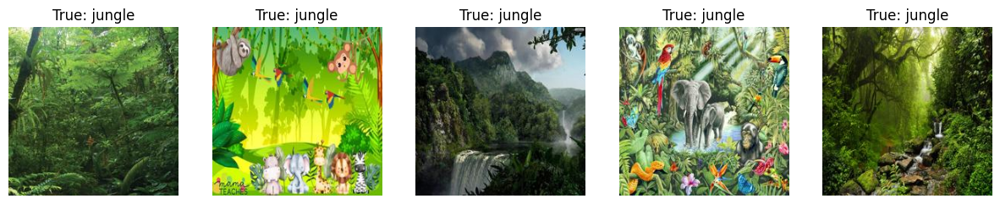

In [ ]:
test_dataset_path = './test-classification'
test_dataset = make_test_generator(test_dataset_path)
plot_sample_images_test(test_dataset, num_images=5)

### **Predict On `CNN` Model (from Scratch)**

5/5 [==============================] - 1s 100ms/step


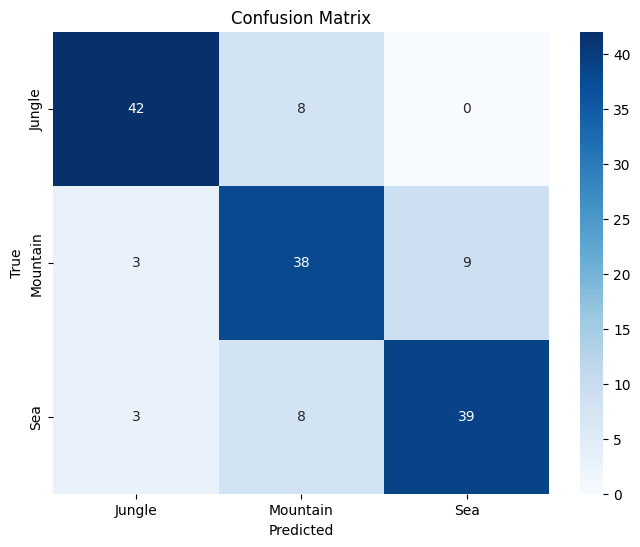

Classification Report:
               precision    recall  f1-score   support

      Jungle       0.88      0.84      0.86        50
    Mountain       0.70      0.76      0.73        50
         Sea       0.81      0.78      0.80        50

    accuracy                           0.79       150
   macro avg       0.80      0.79      0.79       150
weighted avg       0.80      0.79      0.79       150



In [ ]:
from keras.models import load_model

model = load_model('saved_models/best_cnn_categorical.h5')

prediction_from_saved_models(model, test_dataset, task='categorical')

### **Predict On `ResNet` Model**

5/5 [==============================] - 5s 477ms/step


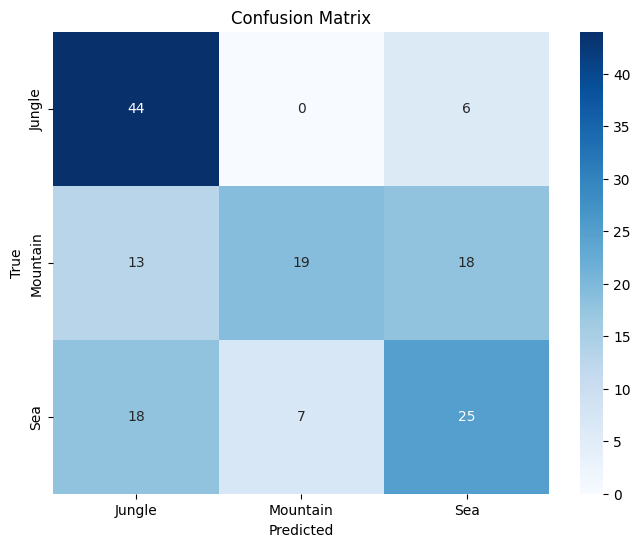

Classification Report:
               precision    recall  f1-score   support

      Jungle       0.59      0.88      0.70        50
    Mountain       0.73      0.38      0.50        50
         Sea       0.51      0.50      0.51        50

    accuracy                           0.59       150
   macro avg       0.61      0.59      0.57       150
weighted avg       0.61      0.59      0.57       150



In [ ]:
model = load_model('saved_models/best_resnet_categorical.h5')

prediction_from_saved_models(model, test_dataset, task='categorical')

### **Predict On `MobileNet` Model**

5/5 [==============================] - 1s 115ms/step


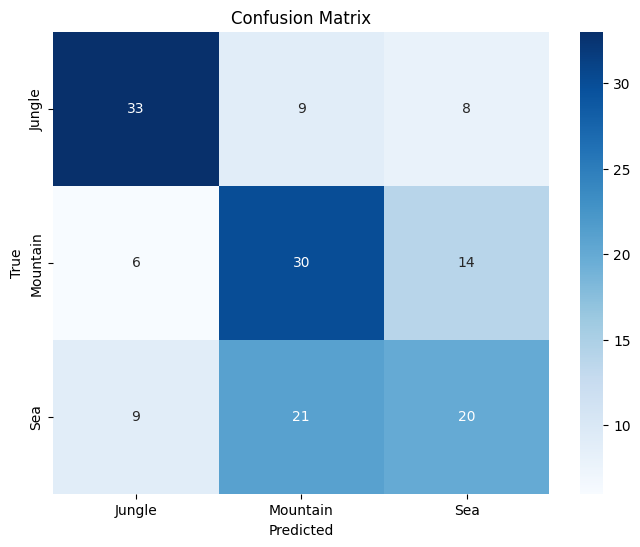

Classification Report:
               precision    recall  f1-score   support

      Jungle       0.69      0.66      0.67        50
    Mountain       0.50      0.60      0.55        50
         Sea       0.48      0.40      0.43        50

    accuracy                           0.55       150
   macro avg       0.55      0.55      0.55       150
weighted avg       0.55      0.55      0.55       150



In [ ]:
model = load_model('saved_models/best_mobilenet_categorical.h5')

prediction_from_saved_models(model, test_dataset, task='categorical')

### **Final Test**

In [2]:
def make_test_generator(path, batch_size = 32, class_mode = 'categorical'):
    test_data_generator = ImageDataGenerator(rescale=1./255)

    test_generator = test_data_generator.flow_from_directory(
        path,
        target_size=(224, 224),
        batch_size=batch_size,
        class_mode=class_mode,
        shuffle=False  # Set shuffle to False for test dataset
    )

    return test_generator

Found 300 images belonging to 3 classes.


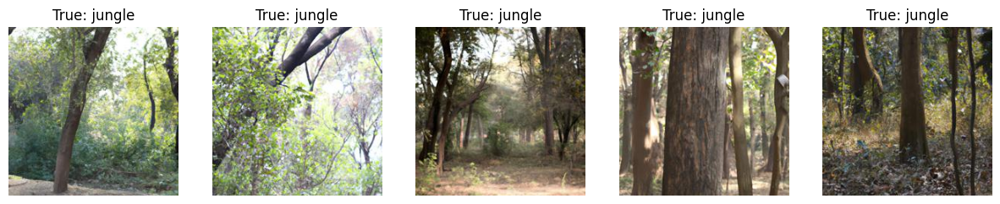

In [7]:
test_dataset_path = './test-final-class'
test_dataset = make_test_generator(test_dataset_path)
plot_sample_images_test(test_dataset, num_images=5)

10/10 [==============================] - 15s 347ms/step


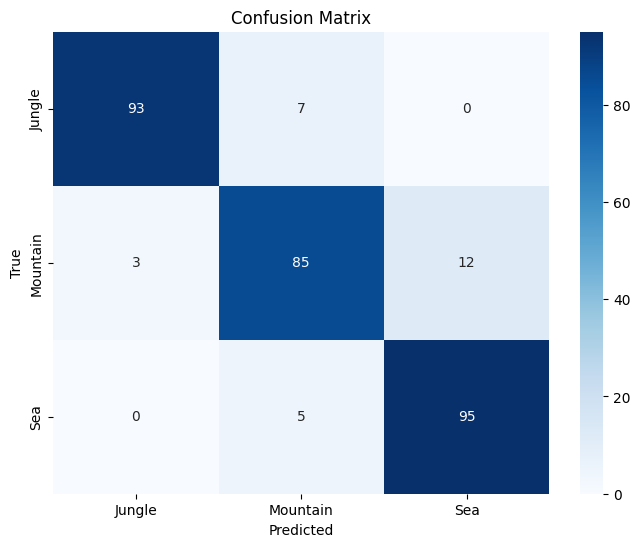

Classification Report:
               precision    recall  f1-score   support

      Jungle       0.97      0.93      0.95       100
    Mountain       0.88      0.85      0.86       100
         Sea       0.89      0.95      0.92       100

    accuracy                           0.91       300
   macro avg       0.91      0.91      0.91       300
weighted avg       0.91      0.91      0.91       300



In [10]:
from keras.models import load_model

model = load_model('saved_models/best_cnn_categorical.h5')

prediction_from_saved_models(model, test_dataset, task='categorical')

Found 300 images belonging to 2 classes.


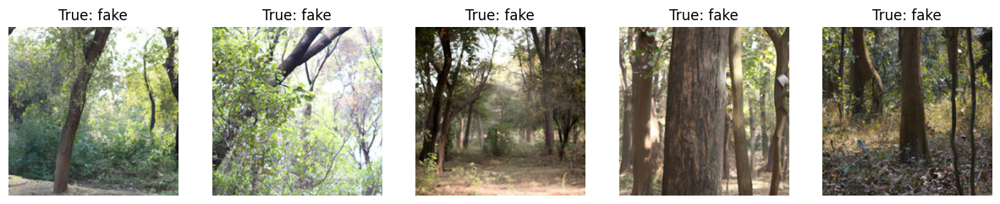

In [14]:
test_dataset_path = './test-final-real-fake'
test_dataset = make_test_generator(test_dataset_path)
plot_sample_images_test(test_dataset, num_images=5)

10/10 [==============================] - 1s 85ms/step


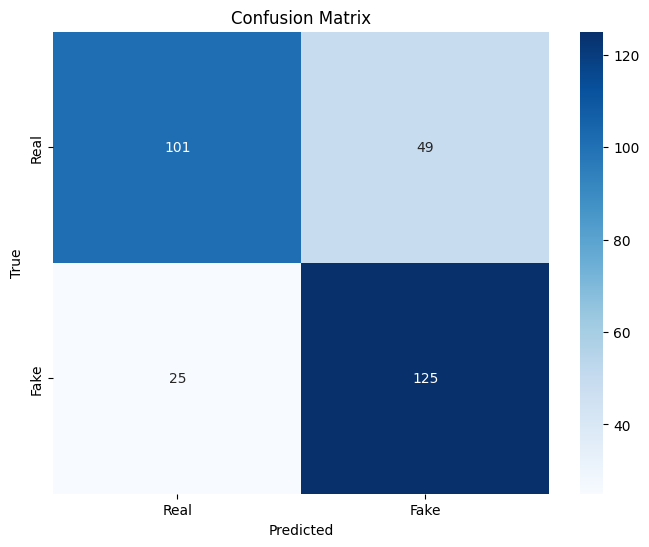

Classification Report:
               precision    recall  f1-score   support

        Real       0.80      0.67      0.73       150
        Fake       0.72      0.83      0.77       150

    accuracy                           0.75       300
   macro avg       0.76      0.75      0.75       300
weighted avg       0.76      0.75      0.75       300



In [15]:
from keras.models import load_model

model = load_model('saved_models/best_cnn_binary.h5')

prediction_from_saved_models(model, test_dataset, task='binary')